# Load Needed Packages

In [1]:
import pickle, json, os, corner, glob, random, copy, time
import numpy as np
from itertools import product

from tqdm import tqdm
from joblib import Parallel, delayed
import scipy.linalg as sl
from scipy.optimize import curve_fit
from enterprise_extensions.model_utils import get_tspan
from enterprise.pulsar import Pulsar
import matplotlib.pyplot as plt
from itertools import combinations

from matplotlib.ticker import AutoMinorLocator
import matplotlib.lines as mlines
# %load_ext line_profiler
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
%load_ext autoreload
%autoreload 2
# import sim
plt.style.use('dark_background')
hist_settings = dict(
    bins = 40,
    histtype = 'step',
    lw = 3,
    density = True
)
import inspect
import scipy.sparse as sps
%load_ext line_profiler

The fastshermanmorrison package is not found. The single pulsar analyses are much faster with the fast algorithm!


# Choose a data set

In [8]:
dsets = ['SIMG45', 'SIMG', 'GSIM', 'GSIMNULL', 'GSIMRED', 'SIMRed', 'SIMBase', 'NIMCast', '15SIM', '12p5', 'A4Cast', 'SIMNULL', 'NIMCast', '15yr', 'AJAXPaper', 'SIMCurn']

In [9]:
id = -3
cname = dsets[id]
cname

'15yr'

In [10]:
crn_bins = 5
Npulsars = 67
noise_dict = {}
# cname = names[0][0]
cname

'15yr'

In [11]:
if cname == '12p5':
    rr = 0
    with open(f'../Data/Pickle/channelized_12yr_v3_partim_DE438.pkl', 'rb') as fin:
        psrs = pickle.load(fin)
    psrlist = [psr.name for psr in psrs]
    with open(f'../Data/Pickle/channelized_12p5yr_v3_full_noisedict.json', 'r') as fin:
        nd = json.load(fin)
    for k, v in nd.items():
        if 'equad' in k:
            noise_dict.update({k.replace('equad','tnequad' ):v})
        else:
            noise_dict.update({k:v})
elif cname == '15yr':
    rr = 0
    with open(f'../Data/Pickle/v1p1_de440_pint_bipm2019.pkl', 'rb') as fin:
        psrs = pickle.load(fin)[:Npulsars]
    psrlist = [psr.name for psr in psrs]
    with open(f'../Data/Pickle/v1p1_all_dict.json', 'r') as fin:
        noise_dict = json.load(fin)
    inc_ecorr = True
    backend = 'backend'
    tnequad = False
    
else:
    rr = 2
    with open(f'../DEMO/Data/Pickle/{cname}/{rr}.pkl', 'rb') as fin:
        psrs = pickle.load(fin)
    len(psrs)
    psrlist = [psr.name for psr in psrs]
    for pname in psrlist:
        noise_dict.update({pname + '_efac': 1.0})
        noise_dict.update({pname + '_log10_t2equad': -np.inf})

# Make the White Data Set

In [108]:
psrs_white = copy.deepcopy(psrs)

In [109]:
white_noise = [np.random.normal(loc = 0, scale = 1e-6, size = len(psr.toas)) for psr in psrs_white]

In [110]:
for pidx in range(len(psrs_white)):
    psrs_white[pidx]._residuals[psrs_white[pidx]._isort] += white_noise[pidx]

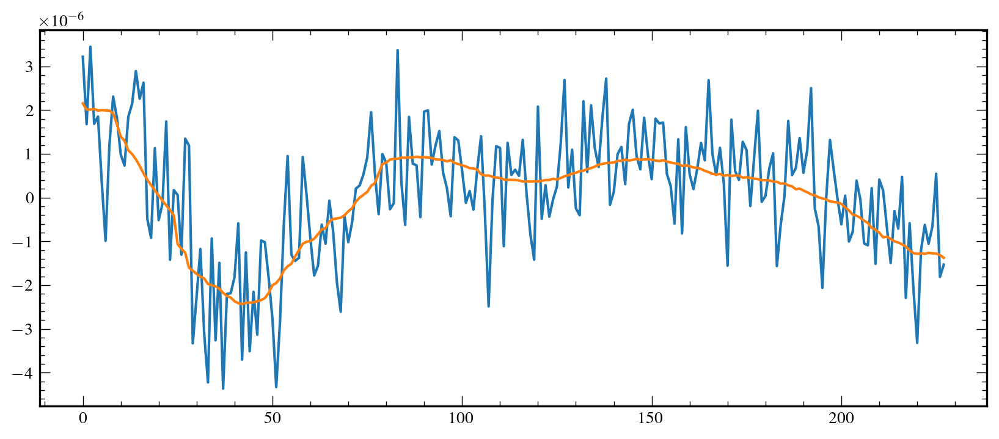

In [111]:
pidx = 0
plt.plot(psrs_white[pidx].residuals)
plt.plot(psrs[pidx].residuals)
plt.show()

In [112]:
for pname in psrlist:
    noise_dict.update({pname + '_efac': 100.0})
    noise_dict.update({pname + '_log10_t2equad': -np.inf})
noise_dict

{'B1855+09_efac': 100.0,
 'B1855+09_log10_t2equad': -inf,
 'B1937+21_efac': 100.0,
 'B1937+21_log10_t2equad': -inf,
 'B1953+29_efac': 100.0,
 'B1953+29_log10_t2equad': -inf,
 'J0023+0923_efac': 100.0,
 'J0023+0923_log10_t2equad': -inf,
 'J0030+0451_efac': 100.0,
 'J0030+0451_log10_t2equad': -inf,
 'J0340+4130_efac': 100.0,
 'J0340+4130_log10_t2equad': -inf,
 'J0613-0200_efac': 100.0,
 'J0613-0200_log10_t2equad': -inf,
 'J0636+5128_efac': 100.0,
 'J0636+5128_log10_t2equad': -inf,
 'J0645+5158_efac': 100.0,
 'J0645+5158_log10_t2equad': -inf,
 'J0740+6620_efac': 100.0,
 'J0740+6620_log10_t2equad': -inf,
 'J0931-1902_efac': 100.0,
 'J0931-1902_log10_t2equad': -inf,
 'J1012+5307_efac': 100.0,
 'J1012+5307_log10_t2equad': -inf,
 'J1024-0719_efac': 100.0,
 'J1024-0719_log10_t2equad': -inf,
 'J1125+7819_efac': 100.0,
 'J1125+7819_log10_t2equad': -inf,
 'J1453+1902_efac': 100.0,
 'J1453+1902_log10_t2equad': -inf,
 'J1455-3330_efac': 100.0,
 'J1455-3330_log10_t2equad': -inf,
 'J1600-3053_efac': 

# Single Pulsar Analyses

In [6]:
crn_bins = 5

ImportError: cannot import name 'torch' from 'enterprise_extensions' (/home/koonima/anaconda3/envs/gent/lib/python3.9/site-packages/enterprise_extensions/__init__.py)

In [20]:
def doit(pidx):
    for pname in psrlist:
        noise_dict.update({pname + '_efac': 100.0})
        noise_dict.update({pname + '_log10_t2equad': -np.inf})

    m = BP.BayesPowerSingle(psr = psrs[pidx],
                Tspan = get_tspan(psrs),
                select = 'none',
                white_vary = False,
                inc_ecorr = False,
                tnequad=False,
                ecorr_type = 'kernel',
                noise_dict = noise_dict,
                tm_marg = True,
                freq_bins = crn_bins,
        log10rhomin=-9.0,
        log10rhomax=-1.0,)

    m.sample(niter=int(4e5),
             resume=False,
            savepath = f'../ChainFrank/{cname}/{rr}/{crn_bins}/SG')
Parallel(n_jobs=24)(delayed(doit)(i) for i in range(len(psrs)));

The fastshermanmorrison package is not found. The single pulsar analyses are much faster with the fast algorithm!The fastshermanmorrison package is not found. The single pulsar analyses are much faster with the fast algorithm!

The fastshermanmorrison package is not found. The single pulsar analyses are much faster with the fast algorithm!
The fastshermanmorrison package is not found. The single pulsar analyses are much faster with the fast algorithm!
The fastshermanmorrison package is not found. The single pulsar analyses are much faster with the fast algorithm!
The fastshermanmorrison package is not found. The single pulsar analyses are much faster with the fast algorithm!
The fastshermanmorrison package is not found. The single pulsar analyses are much faster with the fast algorithm!
The fastshermanmorrison package is not found. The single pulsar analyses are much faster with the fast algorithm!
The fastshermanmorrison package is not found. The single pulsar analyses are much faster

Sampling J2214+3000: 100%|██████████| 400000/400000 [00:49<00:00, 8082.37it/s] 


In [21]:
def pl_to_rho(Amp, gamma):
        return 10**(2*Amp)/(12 * np.pi**2 * f[:, None]**3 * Tspan) * (f[:, None]/fref)**(3-gamma)

In [22]:
Tspan = get_tspan(psrs)
GW_amp_inj = 6e-15
f = np.arange(1/Tspan, (crn_bins + 0.01)/Tspan, 1/Tspan)
fref = 1/(1 * 365.25 * 24 * 60 * 60)

In [23]:
cname

'GSIMRED'

In [24]:
with open('../Data/rn_inj.json', 'r') as fin:
    nj = json.load(fin)
inj_vals = np.array(list(nj.values()))
truths = 0.5 * np.log10(pl_to_rho(np.log10(inj_vals[:, 1]), inj_vals[:, 0]) + pl_to_rho(np.log10(6e-15), 13/3))
# else:
#     truths = 0.5 * np.log10(pl_to_rho(np.log10(AmpRed[0, :]), RN_gamma[0, :]) + pl_to_rho(np.log10(6e-15), 13/3))
truths.shape

(5, 45)

In [25]:
gwb_truth = 0.5 * np.log10(pl_to_rho(np.log10(GW_amp_inj), 13/3)).flatten()
gwb_truth,GW_amp_inj

(array([-5.58694367, -6.23917533, -6.62070639, -6.89140698, -7.10137868]),
 6e-15)

In [39]:
names = [r'$\log_{{{0}}}\rho_{{{1}}}$'.format(10, _+1) for _ in range(crn_bins)]
names

['$\\log_{10}\\rho_{1}$',
 '$\\log_{10}\\rho_{2}$',
 '$\\log_{10}\\rho_{3}$',
 '$\\log_{10}\\rho_{4}$',
 '$\\log_{10}\\rho_{5}$']

In [27]:
paths0 = [x for x in sorted(glob.glob(f'../Chain/{cname}/{rr}/{crn_bins}/SG/*.npy')) if not 'freqs' in x]
paths1 = [x for x in sorted(glob.glob(f'../ChainFrank/{cname}/{rr}/{crn_bins}/SG/*.npy')) if not 'freqs' in x]
paths0, paths1

([],
 ['../ChainFrank/GSIMRED/0/5/SG/B1855+09.npy',
  '../ChainFrank/GSIMRED/0/5/SG/B1937+21.npy',
  '../ChainFrank/GSIMRED/0/5/SG/B1953+29.npy',
  '../ChainFrank/GSIMRED/0/5/SG/J0023+0923.npy',
  '../ChainFrank/GSIMRED/0/5/SG/J0030+0451.npy',
  '../ChainFrank/GSIMRED/0/5/SG/J0340+4130.npy',
  '../ChainFrank/GSIMRED/0/5/SG/J0613-0200.npy',
  '../ChainFrank/GSIMRED/0/5/SG/J0636+5128.npy',
  '../ChainFrank/GSIMRED/0/5/SG/J0645+5158.npy',
  '../ChainFrank/GSIMRED/0/5/SG/J0740+6620.npy',
  '../ChainFrank/GSIMRED/0/5/SG/J0931-1902.npy',
  '../ChainFrank/GSIMRED/0/5/SG/J1012+5307.npy',
  '../ChainFrank/GSIMRED/0/5/SG/J1024-0719.npy',
  '../ChainFrank/GSIMRED/0/5/SG/J1125+7819.npy',
  '../ChainFrank/GSIMRED/0/5/SG/J1453+1902.npy',
  '../ChainFrank/GSIMRED/0/5/SG/J1455-3330.npy',
  '../ChainFrank/GSIMRED/0/5/SG/J1600-3053.npy',
  '../ChainFrank/GSIMRED/0/5/SG/J1614-2230.npy',
  '../ChainFrank/GSIMRED/0/5/SG/J1640+2224.npy',
  '../ChainFrank/GSIMRED/0/5/SG/J1643-1224.npy',
  '../ChainFrank/GSIM

In [28]:
plt.style.use('default')
def figsize(scale, wc = 1, hc = 1):
    fig_width_pt = 513.17 #469.755                  # Get this from LaTeX using \the\textwidth
    inches_per_pt = 1.0/72.27                       # Convert pt to inch
    golden_mean = (np.sqrt(5.0)-1.0)/2.0            # Aesthetic ratio (you could change this)
    fig_width = fig_width_pt*inches_per_pt*scale    # width in inches
    fig_height = fig_width*golden_mean              # height in inches
    fig_size = [wc * fig_width,hc * fig_height]
    return fig_size
plt.rcParams.update(plt.rcParamsDefault)

params = {
    #'backend': 'pdf',
        'axes.labelsize': 12,
        'lines.markersize': 4,
        'font.size': 10,
        'xtick.major.size':6,
        "xtick.top": True,
        "ytick.right": True,
        "xtick.minor.visible": True,
        "xtick.major.top": True, 
        "xtick.minor.top": True,
        "ytick.minor.visible": True, 
        "ytick.major.right": True, 
        "ytick.minor.right": True,
        "ytick.direction": "in",
        "xtick.direction": "in",
        'xtick.minor.size':3,  
        'ytick.major.size':6,
        'ytick.minor.size':3, 
        'xtick.major.width':0.5,
        'ytick.major.width':0.5,
        'xtick.minor.width':0.5,
        'ytick.minor.width':0.5,
        'lines.markeredgewidth':1,
        'axes.linewidth':1.2,
        'legend.fontsize': 7,
        'xtick.labelsize': 10,
        'ytick.labelsize': 10,
        'savefig.dpi':200,
        'path.simplify':True,
        'font.family': 'serif',
        'font.serif':'Times',
        "text.usetex": True,
        #'text.latex.preamble': [r'\usepackage{amsmath}'],
        'text.usetex':True,
        'figure.figsize': figsize(0.5, 1, 1)}
plt.rcParams.update(params)

In [ ]:
def doit(pidx):
        plt.style.use('dark_background')
        plt.rcParams.update({"backend": "pdf", "axes.labelsize": 14, "lines.markersize": 4, "font.size": 14, "xtick.top": True, "ytick.right": True, "xtick.major.size": 6, 
        "xtick.minor.size": 3, "ytick.major.size": 6, "ytick.minor.size": 3, "xtick.major.width": 0.5, "ytick.major.width": 0.5, "xtick.minor.width": 0.5, 
        "ytick.minor.width": 0.5, "lines.markeredgewidth": 1, "axes.linewidth": 1.2, "legend.fontsize": 14, "xtick.labelsize": 14, "xtick.direction": "in", 
        "xtick.minor.visible": True, "xtick.major.top": True, "xtick.minor.top": True, "ytick.labelsize": 14, "ytick.direction": "in", "ytick.minor.visible": True, 
        "ytick.major.right": True, "ytick.minor.right": True, "savefig.dpi": 400, "path.simplify": True, "font.family": "DeJavu Serif",
        "font.serif": "Times", "text.usetex": False, 
        "figure.figsize": [3.5503666805036667, 2.1942472810764047]})
        fig = None
        burn = int(0.25 * 4e5)
        plt.close()

        x0 = np.load(paths0[pidx], mmap_mode='r')[burn:, :crn_bins]
        x1 = np.load(paths1[pidx], mmap_mode='r')[burn:, :crn_bins]

        fig = corner.corner(x0, color='lawngreen', fig = fig, bins=20, hist_bin_factor=2, data_kwargs={'ms':3}, hist_kwargs={'density': True, 'lw':2}, 
                        contour_kwargs={'linewidths':2},labels = names, show_titles=False, truths=truths[:, pidx],
                truth_color = 'red', desity = True, plot_datapoints = False,
                )

        fig = corner.corner(x1, color='gold', fig = fig, bins=20, hist_bin_factor=2, data_kwargs={'ms':3}, hist_kwargs={'density': True, 'lw':2}, 
                        contour_kwargs={'linewidths':2},labels = names, show_titles=False, truths=truths[:, pidx],
                truth_color = 'red', desity = True, plot_datapoints = False,
                )

       
        corner.overplot_lines(fig, gwb_truth, reverse=False, **{'color':'aqua', 'ls' : '--'})
        
        sdir = f'../Images/PaperFrank/{cname}'
        os.makedirs(sdir, exist_ok=True)
        plt.savefig(sdir + f'/{psrlist[pidx]}.png')
        plt.close()

In [ ]:
Parallel(n_jobs=24)(delayed(doit)(i) for i in range(45));

# CURN

In [11]:
# m = BP.BayesPowerCURN(psrs,
#                  crn_bins = 5, 
#                  tnequad = False, 
#                  Tspan = None, 
#                  noise_dict = noise_dict, 
#                  gamma_val = None,
#                 backend = 'none', 
#                 inc_ecorr = False, 
#                 int_rn = True)
m = BP.BayesPowerCURN(psrs,
                 crn_bins = 5, 
                 tnequad = False, 
                 Tspan = None, 
                 noise_dict = noise_dict, 
                 gamma_val = None,
                backend = 'backend', 
                inc_ecorr = True, 
                int_rn = True)
curn_chain = m.sample(niter=int(2e5), savedir = f'../ChainFrank/{cname}/{rr}/{crn_bins}/CURN', CURNiters = 30,)

Setting up the sampler for the first time...


  0%|          | 349/200000 [00:03<32:38, 101.94it/s]

Adding DE jump with weight 50


  3%|▎         | 5017/200000 [00:48<33:19, 97.53it/s] 

2.5 Percent Done in 0.8 Minutes.



  5%|▌         | 10013/200000 [01:36<32:05, 98.69it/s] 

5.0 Percent Done in 1.61 Minutes.



  8%|▊         | 15013/200000 [02:24<30:41, 100.44it/s]

7.5 Percent Done in 2.41 Minutes.



 10%|█         | 20018/200000 [03:13<26:12, 114.48it/s]

10.0 Percent Done in 3.23 Minutes.



 13%|█▎        | 25019/200000 [04:02<28:06, 103.73it/s]

12.5 Percent Done in 4.04 Minutes.



 15%|█▌        | 30018/200000 [04:51<26:57, 105.08it/s]

15.0 Percent Done in 4.85 Minutes.



 18%|█▊        | 35019/200000 [05:39<27:10, 101.19it/s]

17.5 Percent Done in 5.66 Minutes.



 20%|██        | 40020/200000 [06:28<24:40, 108.09it/s]

20.0 Percent Done in 6.47 Minutes.



 23%|██▎       | 45012/200000 [07:17<27:40, 93.32it/s] 

22.5 Percent Done in 7.28 Minutes.



 25%|██▌       | 50012/200000 [08:06<23:03, 108.44it/s]

25.0 Percent Done in 8.1 Minutes.



 28%|██▊       | 55016/200000 [08:55<23:19, 103.57it/s]

27.5 Percent Done in 8.92 Minutes.



 30%|███       | 60027/200000 [09:43<20:17, 114.95it/s]

30.0 Percent Done in 9.73 Minutes.



 33%|███▎      | 65011/200000 [10:31<22:40, 99.19it/s] 

32.5 Percent Done in 10.53 Minutes.



 35%|███▌      | 70018/200000 [11:19<18:39, 116.10it/s]

35.0 Percent Done in 11.32 Minutes.



 38%|███▊      | 75015/200000 [12:05<17:08, 121.53it/s]

37.5 Percent Done in 12.09 Minutes.



 40%|████      | 80029/200000 [12:52<16:42, 119.65it/s]

40.0 Percent Done in 12.88 Minutes.



 43%|████▎     | 85026/200000 [13:38<17:59, 106.47it/s]

42.5 Percent Done in 13.65 Minutes.



 45%|████▌     | 90028/200000 [14:25<14:28, 126.63it/s]

45.0 Percent Done in 14.42 Minutes.



 48%|████▊     | 95014/200000 [15:12<14:53, 117.44it/s]

47.5 Percent Done in 15.2 Minutes.



 50%|█████     | 100011/200000 [15:59<16:36, 100.37it/s]

50.0 Percent Done in 15.99 Minutes.



 53%|█████▎    | 105029/200000 [16:46<12:37, 125.37it/s]

52.5 Percent Done in 16.77 Minutes.



 55%|█████▌    | 110027/200000 [17:33<12:04, 124.25it/s]

55.0 Percent Done in 17.56 Minutes.



 58%|█████▊    | 115010/200000 [18:20<16:27, 86.04it/s] 

57.5 Percent Done in 18.34 Minutes.



 60%|██████    | 120024/200000 [19:07<11:15, 118.32it/s]

60.0 Percent Done in 19.13 Minutes.



 63%|██████▎   | 125015/200000 [19:54<12:49, 97.44it/s] 

62.5 Percent Done in 19.9 Minutes.



 65%|██████▌   | 130024/200000 [20:41<10:43, 108.66it/s]

65.0 Percent Done in 20.68 Minutes.



 68%|██████▊   | 135015/200000 [21:28<10:59, 98.52it/s] 

67.5 Percent Done in 21.47 Minutes.



 70%|███████   | 140019/200000 [22:14<08:23, 119.11it/s]

70.0 Percent Done in 22.24 Minutes.



 73%|███████▎  | 145019/200000 [23:00<07:27, 122.73it/s]

72.5 Percent Done in 23.01 Minutes.



 75%|███████▌  | 150017/200000 [23:46<08:17, 100.50it/s]

75.0 Percent Done in 23.78 Minutes.



 78%|███████▊  | 155015/200000 [24:33<06:26, 116.37it/s]

77.5 Percent Done in 24.55 Minutes.



 80%|████████  | 160019/200000 [25:20<05:57, 111.90it/s]

80.0 Percent Done in 25.34 Minutes.



 83%|████████▎ | 165019/200000 [26:07<05:11, 112.27it/s]

82.5 Percent Done in 26.12 Minutes.



 85%|████████▌ | 170014/200000 [26:54<04:23, 113.66it/s]

85.0 Percent Done in 26.91 Minutes.



 88%|████████▊ | 175011/200000 [27:40<04:15, 97.86it/s] 

87.5 Percent Done in 27.67 Minutes.



 90%|█████████ | 180026/200000 [28:27<02:52, 115.95it/s]

90.0 Percent Done in 28.46 Minutes.



 93%|█████████▎| 185012/200000 [29:14<02:18, 108.49it/s]

92.5 Percent Done in 29.24 Minutes.



 95%|█████████▌| 190027/200000 [30:01<01:28, 112.96it/s]

95.0 Percent Done in 30.02 Minutes.



 98%|█████████▊| 195031/200000 [30:48<00:40, 121.34it/s]

97.5 Percent Done in 30.81 Minutes.



100%|██████████| 200000/200000 [31:34<00:00, 105.55it/s]


In [34]:
a_curn = np.load(f'../ChainFrank/{cname}/{rr}/{crn_bins}/CURN/amat.npy', mmap_mode='r')
a_curn.shape

(200000, 10, 67)

In [35]:
def IG(a):
    """
    Function to perform log10_rho updates given the Fourier coefficients.
    """
    high = 1e-2
    low = 1e-18
    tau = a** 2
    tau = (tau[:, 0::2, :] + tau[:, 1::2, :]) / 2

    Norm = 1 / (np.exp(-tau / high) - np.exp(-tau / low))
    x = np.random.default_rng().uniform(0, 1, size=tau.shape)
    return 0.5 * np.log10(-tau / np.log(x / Norm + np.exp(-tau / low)))


In [36]:
rho_curn = IG(a_curn[int(0.25 * a_curn.shape[0]):])
rho_curn.shape

(150000, 5, 67)

In [ ]:
def doit(pidx):
        plt.style.use('dark_background')
        plt.rcParams.update({"backend": "pdf", "axes.labelsize": 14, "lines.markersize": 4, "font.size": 14, "xtick.top": True, "ytick.right": True, "xtick.major.size": 6, 
        "xtick.minor.size": 3, "ytick.major.size": 6, "ytick.minor.size": 3, "xtick.major.width": 0.5, "ytick.major.width": 0.5, "xtick.minor.width": 0.5, 
        "ytick.minor.width": 0.5, "lines.markeredgewidth": 1, "axes.linewidth": 1.2, "legend.fontsize": 14, "xtick.labelsize": 14, "xtick.direction": "in", 
        "xtick.minor.visible": True, "xtick.major.top": True, "xtick.minor.top": True, "ytick.labelsize": 14, "ytick.direction": "in", "ytick.minor.visible": True, 
        "ytick.major.right": True, "ytick.minor.right": True, "savefig.dpi": 400, "path.simplify": True, "font.family": "DeJavu Serif",
        "font.serif": "Times", "text.usetex": False, 
        "figure.figsize": [3.5503666805036667, 2.1942472810764047]})
        fig = None
        burn = int(0.25 * 4e5)
        plt.close()

        x0 = np.load(paths0[pidx], mmap_mode='r')[burn:, :crn_bins]
        x1 = np.load(paths1[pidx], mmap_mode='r')[burn:, :crn_bins]

        fig = corner.corner(x0, color='lawngreen', fig = fig, bins=20, hist_bin_factor=2, data_kwargs={'ms':3}, hist_kwargs={'density': True, 'lw':2}, 
                        contour_kwargs={'linewidths':2},labels = names, show_titles=False, truths=truths[:, pidx],
                truth_color = 'red', desity = True, plot_datapoints = False,
                )

        fig = corner.corner(x1, color='gold', fig = fig, bins=20, hist_bin_factor=2, data_kwargs={'ms':3}, hist_kwargs={'density': True, 'lw':2}, 
                        contour_kwargs={'linewidths':2},labels = names, show_titles=False, truths=truths[:, pidx],
                truth_color = 'red', desity = True, plot_datapoints = False,
                )


        fig = corner.corner(rho_curn[..., pidx], color='pink', fig = fig, bins=20, hist_bin_factor=2, data_kwargs={'ms':3}, hist_kwargs={'density': True, 'lw':2}, 
                        contour_kwargs={'linewidths':2},labels = names, show_titles=False, truths=truths[:, pidx],
                truth_color = 'red', desity = True, plot_datapoints = False,
                )
               
        corner.overplot_lines(fig, gwb_truth, reverse=False, **{'color':'aqua', 'ls' : '--'})
        
        sdir = f'../Images/PaperFrank/{cname}'
        os.makedirs(sdir, exist_ok=True)
        plt.savefig(sdir + f'/{psrlist[pidx]}.png')
        plt.close()

In [ ]:
Parallel(n_jobs=24)(delayed(doit)(i) for i in range(45));

# Multi-pulsar Gibbs Sampling

In [1]:
from BayesPowerResample import BayesPowerResampleJax as BPJ
import BayesPowerFinal as BP
import jax, pickle, os, glob, random, json
from tqdm import tqdm
import time
from itertools import product
import numpy as np
from enterprise_extensions.model_utils import get_tspan
from jax import numpy as jnp
from joblib import Parallel, delayed

os.environ["JAX_TRACEBACK_FILTERING"] = "off"

jax.config.update("jax_enable_x64", False)
# cname = 'GSIMRED'
cname = '15yr'
# time.sleep(3 * 60)
# all_pos = list(product(*[range(10, 25), range(45)]))
# def doit(idx):
    
#     rr, pidx = all_pos[idx]
#     savedir = f'/mnt/d/ChianAdpatus/{cname}/{rr}/SG'
#     os.makedirs(savedir, exist_ok = True)

#     with open(f'../DEMO/Data/Pickle/{cname}/{rr}.pkl', 'rb') as fin:
#         psrs = pickle.load(fin)
#     psrlist = [psr.name for psr in psrs]
#     noise_dict = {}
#     for pname in psrlist:
#         noise_dict.update({pname + '_efac': 1.0})
#         noise_dict.update({pname + '_log10_t2equad': -np.inf})

#     m = BP.BayesPowerSingle(psr = psrs[pidx],
#                 Tspan = get_tspan(psrs),
#                 select = 'none',
#                 white_vary = False,
#                 inc_ecorr = False,
#                 tnequad=False,
#                 ecorr_type = 'kernel',
#                 noise_dict = noise_dict,
#                 tm_marg = True,
#                 freq_bins = 5,
#         log10rhomin=-9.0,
#         log10rhomax=-1.0,)

#     m.sample(niter=int(4e5),
#              resume=False,
#             savepath = savedir)
# Parallel(n_jobs=24)(delayed(doit)(i) for i in range(len(all_pos)));


# def doit(rr):

#     crn_bins = 5
#     ndraws = int(2e5)
#     ans = []
#     savedir = f'/mnt/d/ChianAdpatus/{cname}/{rr}/SG'
#     chain_sg = np.lib.format.open_memmap(savedir + '/amat.npy', 
#                 mode='w+', 
#                 dtype='float32',
#                 shape=(ndraws, 2 * crn_bins, 45), 
#                 fortran_order=False)
    
#     for path in [x for x in sorted(glob.glob(savedir + '/*.npy')) if not 'freqs' in x and not 'amat' in x]:
#         d = np.load(path, mmap_mode='r')[int(0.25 * int(4e5)):, -2 * crn_bins:]
#         ans.append(d)
#     ans = np.array(ans)
#     ans = ans.transpose((1, 2, 0))
#     # ans = ans[:, :, None, :]
#     for ii in tqdm(range(ndraws)):
#         ac = ans[random.sample(range(ans.shape[0]), k = int(1e3))]
#         # chain_sg[ii] = jnp.mean(ac.transpose((0, 1, 3, 2)) @ ac, axis = 0)
#         chain_sg[ii] = np.mean(ac, axis = 0)
# Parallel(n_jobs=5)(delayed(doit)(i) for i in range(10));

rr = 0

savedir = f'../ChianAdpatus/{cname}/{rr}'
os.makedirs(savedir, exist_ok = True)

if cname == '12p5':
    with open(f'../Data/Pickle/channelized_12yr_v3_partim_DE438.pkl', 'rb') as fin:
        psrs = pickle.load(fin)
    psrlist = [psr.name for psr in psrs]
    with open(f'../Data/Pickle/channelized_12p5yr_v3_full_noisedict.json', 'r') as fin:
        nd = json.load(fin)
    for k, v in nd.items():
        if 'equad' in k:
            noise_dict.update({k.replace('equad','tnequad' ):v})
        else:
            noise_dict.update({k:v})
elif cname == '15yr':
    with open(f'../Data/Pickle/v1p1_de440_pint_bipm2019.pkl', 'rb') as fin:
        psrs = pickle.load(fin)
    psrlist = [psr.name for psr in psrs]
    with open(f'../Data/Pickle/v1p1_all_dict.json', 'r') as fin:
        noise_dict = json.load(fin)
    inc_ecorr = True
    backend = 'backend'
    tnequad = False
else:
    with open(f'../DEMO/Data/Pickle/{cname}/{rr}.pkl', 'rb') as fin:
        psrs = pickle.load(fin)
    len(psrs)
    psrlist = [psr.name for psr in psrs]
    noise_dict = {}
    for pname in psrlist:
        noise_dict.update({pname + '_efac': 1.0})
        noise_dict.update({pname + '_log10_t2equad': -np.inf})

# randidxs = jnp.array(random.sample((range(int(0.25 * 2e6), int(2e6))), k = int(2e5)))
m = BPJ(  psrs = psrs,
        a_coeff=jnp.load(f'../ChainFrank/{cname}/{rr}/5/MG_less_kick/amat_good.npy'), #f'/mnt/d/ChianAdpatus/{cname}/{rr}/SG' + '/amat.npy'),
                crn_bins = 5,
                int_bins= 5,
                orf = 'gt',
                df = None, 
                Tspan = None, 
                noise_dict = noise_dict, 
                backend = 'backend', 
                tnequad = False, 
                inc_ecorr = True,
                single_pulsar_run=False,
                pulsar_index_for_single_run=0, 
                int_rn = True,
                renorm_const = 1e9,
                a_is_scaled = True)

# m.run_hmc(savepath = savedir + '/inferMG_less_kick.pkl')
# m.run_hmc_marg(savepath = savedir + '/inferST.pkl')

The fastshermanmorrison package is not found. The single pulsar analyses are much faster with the fast algorithm!
Optional mpi4py package is not installed.  MPI support is not available.
(174902, 10, 67)
0.062939435
Condition number of the TNT matrix before stabilizing is: 2.6491345698816e+13
Condition number of the TNT matrix after stabilizing is: 1.263479160832e+12


In [2]:
m.run_hmc_LKJ(savepath = savedir + '/inferLKJ.pkl')

/home/koonima/FAST/DEMO/BayesPowerResample.py:1026: UserWarning: Site corr_mat: Out-of-support values provided to log prob method. The value argument should be within the support.
  infer_object.run(jax.random.key(100))


RuntimeError: Cannot find valid initial parameters. Please check your model again.

In [3]:
tf

NameError: name 'tf' is not defined

In [4]:
import tensorflow_probability.substrates.jax as x

In [5]:
x

<module 'tensorflow_probability.substrates.jax' from '/home/koonima/.local/lib/python3.9/site-packages/tensorflow_probability/substrates/jax/__init__.py'>

In [11]:
# m = BP.BayesPowerMulti(psrs,
#                         crn_bins = 5,
#                         Tspan = get_tspan(psrs),
#                         tnequad=False,
#                         noise_dict = noise_dict,
#                         backend = 'none',
#                         renorm_const=1e9,
#                         half_logphi_ii_lower = -9,
#                         half_logphi_ii_upper = -2,
#                         empirical_nd_orf = 'hd',
#                         inc_ecorr = False,
#                         int_rn = True)
m = BP.BayesPowerMulti(psrs,
                        crn_bins = 5,
                        Tspan = get_tspan(psrs),
                        tnequad=False,
                        noise_dict = noise_dict,
                        backend = 'backend',
                        renorm_const=1e9,
                        half_logphi_ii_lower = -9,
                        half_logphi_ii_upper = -1,
                        empirical_nd_orf = 'gt',
                        inc_ecorr = False,
                        int_rn = True,
                        fail_trial_count = 5000,)

m.wishart_helper
savedir = f'../ChainFrank/{cname}/{rr}/{crn_bins}/MG_more_kick/'

Condition number of the TNT matrix before stabilizing is: 2.0995395070638778e+21
Condition number of the TNT matrix after stabilizing is: 2.4608867705264006e+14


In [10]:
m.do_multi_gibbs(niter = int(2e6),
        save_diag_only = False,
        savedir = savedir,
        # emp_chain_path = f'../ChainFrank/{cname}/{rr}/{crn_bins}/CURN',
        emp_chain_path = f'../ChianAdpatus/{cname}/{rr}/ST',
        gibbs_weight = int(1e4),
        empir_weight = 100,
        gibbs_average_weight = 0,
        resume = False,
        pbar_freq = int(5e3),
        progress_bar = True
        )

  0%|          | 6286/2000000 [00:41<10:26:50, 53.01it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  0%|          | 8021/2000000 [00:53<7:09:20, 77.33it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  1%|          | 10742/2000000 [01:06<1:50:14, 300.75it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  1%|          | 10802/2000000 [01:10<12:15:54, 45.05it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  1%|          | 21834/2000000 [01:54<13:35:59, 40.40it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  1%|          | 23830/2000000 [02:05<1:19:36, 413.76it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  1%|          | 23872/2000000 [02:08<14:32:08, 37.76it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  1%|▏         | 25679/2000000 [02:23<7:23:38, 74.17it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  1%|▏         | 26851/2000000 [02:28<4:49:45, 113.49it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  2%|▏         | 30088/2000000 [02:43<2:59:44, 182.66it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  2%|▏         | 30176/2000000 [02:47<11:01:31, 49.63it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  2%|▏         | 30804/2000000 [02:53<9:44:36, 56.14it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  2%|▏         | 31572/2000000 [02:58<7:37:10, 71.76it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  2%|▏         | 34546/2000000 [03:16<8:09:39, 66.90it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  2%|▏         | 34640/2000000 [03:17<3:57:59, 137.63it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  2%|▏         | 34718/2000000 [03:20<11:25:00, 47.82it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  2%|▏         | 35859/2000000 [03:23<1:35:14, 343.70it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  2%|▏         | 35942/2000000 [03:27<11:54:03, 45.84it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  2%|▏         | 38188/2000000 [03:48<21:27:09, 25.40it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  2%|▏         | 38819/2000000 [03:57<23:48:11, 22.89it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  2%|▏         | 38867/2000000 [04:03<35:30:26, 15.34it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  2%|▏         | 43443/2000000 [04:32<10:46:03, 50.47it/s]

Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...


  2%|▏         | 43504/2000000 [04:37<21:13:02, 25.61it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  2%|▏         | 44942/2000000 [04:47<11:38:14, 46.67it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  2%|▏         | 49249/2000000 [05:04<2:03:35, 263.08it/s]

Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...


  2%|▏         | 49933/2000000 [05:15<11:31:08, 47.03it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  2%|▏         | 49982/2000000 [05:18<21:11:00, 25.57it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  3%|▎         | 51495/2000000 [05:27<6:17:36, 86.00it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  3%|▎         | 51664/2000000 [05:31<11:43:43, 46.14it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  3%|▎         | 54265/2000000 [05:46<8:10:18, 66.14it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  3%|▎         | 54735/2000000 [06:00<19:45:32, 27.35it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  3%|▎         | 60022/2000000 [06:27<14:52:51, 36.21it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  3%|▎         | 61032/2000000 [06:33<7:07:15, 75.64it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  4%|▍         | 75035/2000000 [08:02<10:47:32, 49.55it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  4%|▍         | 78389/2000000 [08:18<5:04:08, 105.30it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  4%|▍         | 83373/2000000 [08:43<6:53:25, 77.27it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  4%|▍         | 85161/2000000 [08:51<4:49:46, 110.13it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  4%|▍         | 86492/2000000 [08:57<8:53:37, 59.77it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  4%|▍         | 88581/2000000 [09:11<8:05:58, 65.55it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  5%|▍         | 90013/2000000 [09:16<1:21:22, 391.16it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  5%|▍         | 90132/2000000 [09:19<8:46:17, 60.48it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  5%|▍         | 90349/2000000 [09:23<10:44:31, 49.38it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  5%|▍         | 97102/2000000 [09:51<7:14:32, 72.98it/s] 

Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...


  5%|▍         | 97174/2000000 [09:55<14:27:53, 36.54it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  5%|▍         | 97253/2000000 [09:55<7:52:38, 67.10it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  5%|▍         | 97338/2000000 [09:58<11:26:04, 46.22it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  5%|▍         | 98006/2000000 [10:02<9:32:20, 55.39it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  5%|▌         | 100336/2000000 [10:15<7:21:09, 71.77it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  5%|▌         | 102291/2000000 [10:25<8:35:47, 61.32it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  5%|▌         | 103022/2000000 [10:31<8:59:47, 58.57it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  5%|▌         | 103089/2000000 [10:33<9:41:08, 54.40it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  5%|▌         | 103595/2000000 [10:42<26:02:37, 20.23it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  5%|▌         | 103777/2000000 [10:44<9:50:54, 53.48it/s] 

Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...


  5%|▌         | 103808/2000000 [10:47<23:19:15, 22.59it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  5%|▌         | 105737/2000000 [10:59<9:46:33, 53.82it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  5%|▌         | 107877/2000000 [11:07<4:45:58, 110.27it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  5%|▌         | 109504/2000000 [11:14<5:26:36, 96.47it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  6%|▌         | 110624/2000000 [11:27<14:24:58, 36.41it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  6%|▌         | 110924/2000000 [11:31<9:54:37, 52.95it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  6%|▌         | 112349/2000000 [11:39<6:42:50, 78.10it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  6%|▌         | 114754/2000000 [11:52<8:32:14, 61.34it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  6%|▌         | 120758/2000000 [12:15<5:37:35, 92.78it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  6%|▌         | 121849/2000000 [12:24<10:11:55, 51.15it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  6%|▋         | 125929/2000000 [12:41<11:25:05, 45.59it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  6%|▋         | 127174/2000000 [12:48<14:50:54, 35.04it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  6%|▋         | 127226/2000000 [12:51<18:27:20, 28.19it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  6%|▋         | 127535/2000000 [12:54<7:27:44, 69.70it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  6%|▋         | 128689/2000000 [13:02<4:41:48, 110.68it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  7%|▋         | 136897/2000000 [13:38<11:56:38, 43.33it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  7%|▋         | 140449/2000000 [13:59<12:03:09, 42.86it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  7%|▋         | 140476/2000000 [14:03<23:18:43, 22.16it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  7%|▋         | 143110/2000000 [14:20<13:48:01, 37.38it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  7%|▋         | 148539/2000000 [14:51<10:05:11, 50.99it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  8%|▊         | 153577/2000000 [15:20<6:30:20, 78.84it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  8%|▊         | 154982/2000000 [15:25<5:10:35, 99.01it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  8%|▊         | 155028/2000000 [15:28<14:06:24, 36.33it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  8%|▊         | 155930/2000000 [15:33<9:47:59, 52.27it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  8%|▊         | 158298/2000000 [15:43<1:11:54, 426.86it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  8%|▊         | 158380/2000000 [15:46<8:30:20, 60.14it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  8%|▊         | 162982/2000000 [16:08<15:58:22, 31.95it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  8%|▊         | 165217/2000000 [16:19<1:10:33, 433.37it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  8%|▊         | 165307/2000000 [16:22<7:39:50, 66.50it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  8%|▊         | 166938/2000000 [16:28<1:12:02, 424.06it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  8%|▊         | 167013/2000000 [16:32<9:02:32, 56.31it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  8%|▊         | 169148/2000000 [16:40<5:04:47, 100.11it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  8%|▊         | 169681/2000000 [16:48<10:33:33, 48.15it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  9%|▊         | 171791/2000000 [16:58<5:22:01, 94.62it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  9%|▉         | 179021/2000000 [17:35<4:12:05, 120.39it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  9%|▉         | 180847/2000000 [17:48<4:51:39, 103.95it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  9%|▉         | 182539/2000000 [17:59<8:38:16, 58.45it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  9%|▉         | 184980/2000000 [18:16<8:37:36, 58.44it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


  9%|▉         | 185329/2000000 [18:24<19:48:32, 25.45it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  9%|▉         | 187801/2000000 [18:39<14:53:37, 33.80it/s]

Gibbs sampling failed! Force-kicking Gibbs...


  9%|▉         | 188854/2000000 [18:45<5:46:22, 87.15it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 10%|▉         | 192260/2000000 [19:04<12:51:53, 39.03it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 10%|▉         | 193143/2000000 [19:09<4:52:57, 102.79it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 10%|▉         | 197475/2000000 [19:29<4:46:23, 104.90it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 10%|█         | 200211/2000000 [19:49<10:38:52, 46.95it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 10%|█         | 200390/2000000 [19:54<9:36:58, 51.98it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 10%|█         | 203239/2000000 [20:04<6:48:33, 73.30it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 10%|█         | 206764/2000000 [20:26<9:20:30, 53.32it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 10%|█         | 208224/2000000 [20:32<1:34:08, 317.23it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 10%|█         | 208299/2000000 [20:35<7:05:20, 70.21it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 10%|█         | 208372/2000000 [20:37<9:14:53, 53.81it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 10%|█         | 208597/2000000 [20:43<11:41:17, 42.57it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 10%|█         | 208824/2000000 [20:45<7:55:20, 62.80it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 10%|█         | 208837/2000000 [20:47<23:14:08, 21.41it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 10%|█         | 208881/2000000 [20:49<17:57:30, 27.70it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 11%|█         | 210748/2000000 [20:57<5:40:02, 87.70it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 11%|█         | 213538/2000000 [21:12<9:12:03, 53.93it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 11%|█         | 218816/2000000 [21:32<24:51:03, 19.91it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 11%|█         | 218858/2000000 [21:35<25:57:04, 19.06it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 11%|█         | 219827/2000000 [21:48<6:42:46, 73.66it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 11%|█         | 220531/2000000 [21:53<5:32:44, 89.13it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 11%|█         | 224500/2000000 [22:09<5:48:15, 84.97it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 11%|█▏        | 225028/2000000 [22:16<7:04:02, 69.76it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 11%|█▏        | 226188/2000000 [22:22<5:12:20, 94.65it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 11%|█▏        | 228581/2000000 [22:42<5:47:30, 84.96it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 11%|█▏        | 228811/2000000 [22:44<7:00:22, 70.22it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 12%|█▏        | 232271/2000000 [23:02<8:49:28, 55.64it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 12%|█▏        | 233191/2000000 [23:09<5:07:43, 95.69it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 12%|█▏        | 233538/2000000 [23:13<10:34:38, 46.39it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 12%|█▏        | 240753/2000000 [23:48<5:53:19, 82.99it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 12%|█▏        | 245246/2000000 [24:12<9:59:46, 48.76it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 12%|█▏        | 248843/2000000 [24:26<7:39:03, 63.58it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 13%|█▎        | 251208/2000000 [24:35<5:34:32, 87.12it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 13%|█▎        | 251606/2000000 [24:37<3:53:59, 124.53it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 13%|█▎        | 252107/2000000 [24:46<7:21:19, 66.01it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 13%|█▎        | 254514/2000000 [25:05<6:12:48, 78.03it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 13%|█▎        | 258666/2000000 [25:33<4:19:35, 111.80it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 13%|█▎        | 259270/2000000 [25:36<4:37:37, 104.50it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 13%|█▎        | 263168/2000000 [25:51<4:43:27, 102.12it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 13%|█▎        | 267314/2000000 [26:07<3:09:36, 152.30it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 13%|█▎        | 269321/2000000 [26:29<15:11:26, 31.65it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 14%|█▎        | 272066/2000000 [26:37<5:04:51, 94.47it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 14%|█▎        | 274618/2000000 [26:50<7:56:42, 60.32it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 14%|█▍        | 275915/2000000 [26:58<9:45:49, 49.05it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 14%|█▍        | 277563/2000000 [27:06<7:11:49, 66.48it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 14%|█▍        | 282312/2000000 [27:30<5:11:11, 92.00it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 14%|█▍        | 284509/2000000 [27:41<7:15:23, 65.67it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 14%|█▍        | 284901/2000000 [27:43<5:51:39, 81.29it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 14%|█▍        | 284980/2000000 [27:45<8:01:33, 59.36it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 14%|█▍        | 285391/2000000 [27:48<4:33:19, 104.55it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 14%|█▍        | 285958/2000000 [27:50<2:26:22, 195.16it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 14%|█▍        | 286023/2000000 [27:54<12:20:08, 38.60it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 14%|█▍        | 287657/2000000 [28:04<8:14:09, 57.75it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 15%|█▍        | 291811/2000000 [28:32<4:54:39, 96.62it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 15%|█▍        | 293685/2000000 [28:53<5:04:58, 93.25it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 15%|█▍        | 294127/2000000 [28:56<9:14:08, 51.31it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 15%|█▍        | 295034/2000000 [29:06<6:59:14, 67.78it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 15%|█▍        | 295201/2000000 [29:10<9:20:57, 50.65it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 15%|█▍        | 295446/2000000 [29:15<13:24:21, 35.32it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 15%|█▍        | 296599/2000000 [29:20<5:38:08, 83.96it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 15%|█▍        | 296828/2000000 [29:26<19:19:57, 24.47it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 15%|█▍        | 296936/2000000 [29:27<11:12:11, 42.23it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 15%|█▍        | 297420/2000000 [29:29<1:17:52, 364.38it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 15%|█▍        | 297500/2000000 [29:32<8:41:50, 54.37it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 15%|█▍        | 299353/2000000 [29:41<1:12:16, 392.16it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 15%|█▍        | 299397/2000000 [29:44<10:09:14, 46.52it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 15%|█▌        | 300069/2000000 [29:50<9:45:11, 48.42it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 15%|█▌        | 302876/2000000 [30:11<4:50:50, 97.26it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 15%|█▌        | 305777/2000000 [30:22<5:06:34, 92.10it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 15%|█▌        | 308994/2000000 [30:35<8:14:25, 57.00it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 15%|█▌        | 309391/2000000 [30:42<15:12:30, 30.88it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 15%|█▌        | 309872/2000000 [30:45<6:16:09, 74.89it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 16%|█▌        | 313034/2000000 [31:03<4:52:00, 96.28it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 16%|█▌        | 315673/2000000 [31:18<6:46:45, 69.01it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 16%|█▌        | 318834/2000000 [31:39<10:26:16, 44.74it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 16%|█▋        | 325532/2000000 [32:07<1:07:46, 411.75it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 16%|█▋        | 326319/2000000 [32:18<6:35:22, 70.55it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 16%|█▋        | 326945/2000000 [32:22<11:17:45, 41.14it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 16%|█▋        | 328371/2000000 [32:30<6:18:58, 73.52it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 17%|█▋        | 331325/2000000 [32:43<2:25:27, 191.19it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 17%|█▋        | 331350/2000000 [32:46<12:58:40, 35.72it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 17%|█▋        | 331904/2000000 [32:56<6:20:39, 73.04it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 17%|█▋        | 336088/2000000 [33:16<4:07:47, 111.91it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 17%|█▋        | 337298/2000000 [33:23<6:01:46, 76.60it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 17%|█▋        | 339696/2000000 [33:33<5:30:06, 83.83it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 17%|█▋        | 341796/2000000 [33:46<8:15:48, 55.74it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 17%|█▋        | 342257/2000000 [33:51<4:01:55, 114.21it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 17%|█▋        | 346193/2000000 [34:13<10:22:52, 44.25it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 17%|█▋        | 347429/2000000 [34:24<7:27:28, 61.55it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 17%|█▋        | 348619/2000000 [34:28<2:09:05, 213.21it/s]

Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...


 17%|█▋        | 348686/2000000 [34:33<13:22:14, 34.31it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 18%|█▊        | 351273/2000000 [34:46<3:34:46, 127.95it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 18%|█▊        | 352094/2000000 [34:50<5:05:53, 89.79it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 18%|█▊        | 352162/2000000 [34:52<7:16:08, 62.97it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 18%|█▊        | 355311/2000000 [35:08<2:55:03, 156.58it/s]

Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...


 18%|█▊        | 355799/2000000 [35:25<18:41:47, 24.43it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 18%|█▊        | 361936/2000000 [35:57<8:25:49, 53.97it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 18%|█▊        | 362268/2000000 [35:59<3:46:26, 120.54it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 18%|█▊        | 364398/2000000 [36:12<12:28:12, 36.43it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 18%|█▊        | 364538/2000000 [36:16<11:20:25, 40.06it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 18%|█▊        | 366046/2000000 [36:23<6:06:40, 74.27it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 18%|█▊        | 366589/2000000 [36:26<4:09:30, 109.11it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 18%|█▊        | 366880/2000000 [36:31<10:43:54, 42.27it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 18%|█▊        | 368089/2000000 [36:37<5:01:26, 90.23it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 18%|█▊        | 368647/2000000 [36:42<5:42:14, 79.44it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 18%|█▊        | 368779/2000000 [36:47<17:44:55, 25.53it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 18%|█▊        | 369950/2000000 [36:56<7:00:17, 64.64it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 19%|█▊        | 371205/2000000 [37:03<4:09:10, 108.94it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 19%|█▊        | 372175/2000000 [37:11<5:31:07, 81.93it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 19%|█▊        | 374152/2000000 [37:24<4:36:09, 98.13it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 19%|█▊        | 374208/2000000 [37:26<8:06:47, 55.66it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 19%|█▊        | 374299/2000000 [37:28<7:48:40, 57.81it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 19%|█▉        | 375926/2000000 [37:37<6:32:22, 68.99it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 19%|█▉        | 377019/2000000 [37:45<3:14:00, 139.43it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 19%|█▉        | 378261/2000000 [37:56<7:59:16, 56.40it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 19%|█▉        | 380863/2000000 [38:16<3:25:06, 131.56it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 19%|█▉        | 381274/2000000 [38:19<3:38:02, 123.73it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 19%|█▉        | 382480/2000000 [38:30<6:13:26, 72.19it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 19%|█▉        | 384987/2000000 [38:43<2:28:13, 181.59it/s]

Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...


 19%|█▉        | 385067/2000000 [38:50<18:32:51, 24.19it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 19%|█▉        | 386482/2000000 [39:00<6:00:55, 74.51it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 19%|█▉        | 387327/2000000 [39:02<57:04, 470.96it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 19%|█▉        | 387866/2000000 [39:11<10:17:31, 43.51it/s]

Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...


 19%|█▉        | 388016/2000000 [39:17<8:51:34, 50.54it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 19%|█▉        | 389967/2000000 [39:30<10:21:08, 43.20it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 20%|█▉        | 390888/2000000 [39:38<5:12:37, 85.79it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 20%|█▉        | 391620/2000000 [39:43<5:36:51, 79.58it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 20%|█▉        | 394021/2000000 [39:55<4:14:53, 105.01it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 20%|█▉        | 394108/2000000 [39:55<2:35:14, 172.41it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 20%|█▉        | 394329/2000000 [40:03<13:32:36, 32.93it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 20%|█▉        | 397615/2000000 [40:23<8:49:05, 50.48it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 20%|██        | 402137/2000000 [40:47<11:43:43, 37.84it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 20%|██        | 405080/2000000 [41:14<9:03:50, 48.88it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 20%|██        | 406920/2000000 [41:24<4:40:18, 94.72it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 20%|██        | 408133/2000000 [41:29<55:55, 474.36it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 20%|██        | 408232/2000000 [41:31<5:53:35, 75.03it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 20%|██        | 408873/2000000 [41:36<4:03:55, 108.72it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 20%|██        | 409010/2000000 [41:37<5:05:02, 86.93it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 21%|██        | 413754/2000000 [42:02<10:20:56, 42.58it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 21%|██        | 413891/2000000 [42:03<5:04:31, 86.81it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 21%|██        | 419313/2000000 [42:28<9:40:45, 45.36it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 21%|██        | 419559/2000000 [42:35<15:11:26, 28.90it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 21%|██        | 422645/2000000 [42:44<5:11:06, 84.50it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 21%|██        | 422787/2000000 [42:49<10:53:23, 40.23it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 21%|██        | 424752/2000000 [42:55<4:58:18, 88.01it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 21%|██▏       | 427713/2000000 [43:14<16:21:34, 26.70it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 22%|██▏       | 430026/2000000 [43:27<8:47:03, 49.65it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 22%|██▏       | 430119/2000000 [43:29<6:50:01, 63.81it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 22%|██▏       | 432695/2000000 [43:42<6:03:42, 71.82it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 22%|██▏       | 434838/2000000 [43:52<9:00:59, 48.22it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 22%|██▏       | 437238/2000000 [44:02<8:18:34, 52.24it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 22%|██▏       | 439784/2000000 [44:21<22:03:28, 19.65it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 22%|██▏       | 440217/2000000 [44:24<4:42:02, 92.17it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 22%|██▏       | 441776/2000000 [44:33<4:00:16, 108.09it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 22%|██▏       | 443654/2000000 [44:45<6:34:21, 65.78it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 22%|██▏       | 446018/2000000 [45:02<6:03:48, 71.19it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 23%|██▎       | 450604/2000000 [45:19<5:01:03, 85.77it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 23%|██▎       | 450675/2000000 [45:21<8:45:03, 49.18it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 23%|██▎       | 450929/2000000 [45:22<2:00:37, 214.04it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 23%|██▎       | 451503/2000000 [45:29<7:50:18, 54.88it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 23%|██▎       | 455682/2000000 [45:42<4:34:28, 93.77it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 23%|██▎       | 456732/2000000 [45:48<1:13:30, 349.89it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 23%|██▎       | 456804/2000000 [45:51<8:55:12, 48.06it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 23%|██▎       | 458399/2000000 [45:59<3:41:30, 116.00it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 23%|██▎       | 463533/2000000 [46:23<8:47:48, 48.52it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 23%|██▎       | 465494/2000000 [46:34<6:37:02, 64.41it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 23%|██▎       | 466347/2000000 [46:44<18:09:07, 23.47it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 23%|██▎       | 467533/2000000 [46:48<3:47:29, 112.27it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 23%|██▎       | 467937/2000000 [46:51<5:15:32, 80.92it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 23%|██▎       | 469142/2000000 [46:57<1:13:21, 347.81it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 23%|██▎       | 469795/2000000 [47:09<6:38:15, 64.04it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 23%|██▎       | 469994/2000000 [47:09<2:02:37, 207.95it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 24%|██▎       | 470114/2000000 [47:15<10:48:05, 39.34it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 24%|██▎       | 472546/2000000 [47:32<14:35:12, 29.09it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 24%|██▍       | 475118/2000000 [47:45<6:49:09, 62.11it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 24%|██▍       | 476969/2000000 [47:53<10:51:59, 38.93it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 24%|██▍       | 477464/2000000 [47:57<6:44:17, 62.76it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 24%|██▍       | 477932/2000000 [48:01<4:34:10, 92.52it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 24%|██▍       | 478509/2000000 [48:10<4:20:03, 97.51it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 24%|██▍       | 480114/2000000 [48:18<8:23:52, 50.27it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 24%|██▍       | 481229/2000000 [48:26<3:11:53, 131.91it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 24%|██▍       | 481658/2000000 [48:31<7:10:53, 58.73it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 24%|██▍       | 482569/2000000 [48:36<9:26:35, 44.64it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 24%|██▍       | 482717/2000000 [48:44<35:45:43, 11.79it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 24%|██▍       | 484185/2000000 [48:49<3:21:55, 125.11it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 24%|██▍       | 484773/2000000 [48:53<4:51:04, 86.76it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 25%|██▍       | 490947/2000000 [49:22<8:26:23, 49.67it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 25%|██▍       | 493281/2000000 [49:35<14:25:34, 29.01it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 25%|██▍       | 495135/2000000 [50:01<6:17:07, 66.51it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 25%|██▍       | 495738/2000000 [50:08<12:25:27, 33.63it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 25%|██▍       | 497344/2000000 [50:16<9:42:11, 43.02it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 25%|██▍       | 497821/2000000 [50:20<5:13:57, 79.74it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 25%|██▍       | 498912/2000000 [50:25<4:34:18, 91.21it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 25%|██▌       | 500072/2000000 [50:29<2:41:38, 154.66it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 25%|██▌       | 502093/2000000 [50:41<3:42:26, 112.23it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 25%|██▌       | 502470/2000000 [50:46<6:46:51, 61.34it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 25%|██▌       | 504186/2000000 [50:58<4:24:06, 94.39it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 25%|██▌       | 506834/2000000 [51:13<1:12:36, 342.72it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 25%|██▌       | 507314/2000000 [51:17<1:31:31, 271.80it/s]

Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...


 25%|██▌       | 507384/2000000 [51:21<10:27:47, 39.63it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 25%|██▌       | 509979/2000000 [51:35<4:54:00, 84.47it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 26%|██▌       | 510713/2000000 [51:42<7:52:58, 52.48it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 26%|██▌       | 513409/2000000 [51:56<1:20:49, 306.55it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 26%|██▌       | 513448/2000000 [51:58<6:39:55, 61.95it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 26%|██▌       | 516187/2000000 [52:16<52:29, 471.14it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 26%|██▌       | 516278/2000000 [52:19<5:46:06, 71.45it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 26%|██▌       | 521839/2000000 [52:50<5:02:57, 81.32it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 26%|██▋       | 525209/2000000 [53:05<5:54:59, 69.24it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 26%|██▋       | 525327/2000000 [53:07<7:50:24, 52.25it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 26%|██▋       | 526499/2000000 [53:18<4:31:01, 90.62it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 26%|██▋       | 527133/2000000 [53:25<11:29:10, 35.62it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 26%|██▋       | 527216/2000000 [53:27<8:52:09, 46.13it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 26%|██▋       | 527272/2000000 [53:32<20:40:59, 19.78it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 27%|██▋       | 531303/2000000 [53:46<55:39, 439.79it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 27%|██▋       | 531350/2000000 [53:51<12:10:13, 33.52it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 27%|██▋       | 532487/2000000 [53:59<3:49:55, 106.38it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 27%|██▋       | 536302/2000000 [54:14<5:02:26, 80.66it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 27%|██▋       | 536733/2000000 [54:20<5:17:24, 76.83it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 27%|██▋       | 542841/2000000 [54:49<7:58:33, 50.75it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 27%|██▋       | 543156/2000000 [54:50<2:05:21, 193.70it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 27%|██▋       | 544707/2000000 [55:02<4:10:35, 96.79it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 27%|██▋       | 548142/2000000 [55:15<3:13:30, 125.05it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 27%|██▋       | 548227/2000000 [55:18<7:11:48, 56.04it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 28%|██▊       | 550138/2000000 [55:35<5:14:52, 76.74it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 28%|██▊       | 553291/2000000 [55:55<6:56:33, 57.88it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 28%|██▊       | 553367/2000000 [55:58<9:54:11, 40.58it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 28%|██▊       | 556134/2000000 [56:15<6:25:41, 62.39it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 28%|██▊       | 557752/2000000 [56:26<6:15:00, 64.10it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 28%|██▊       | 562312/2000000 [56:42<51:43, 463.20it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 28%|██▊       | 562360/2000000 [56:45<7:47:15, 51.28it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 28%|██▊       | 562973/2000000 [56:52<5:58:42, 66.77it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 28%|██▊       | 565691/2000000 [57:06<5:57:07, 66.94it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 29%|██▉       | 576051/2000000 [58:11<5:59:50, 65.95it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 29%|██▉       | 576890/2000000 [58:15<4:57:52, 79.63it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 29%|██▉       | 578511/2000000 [58:27<13:33:31, 29.12it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 29%|██▉       | 582711/2000000 [58:54<7:08:33, 55.12it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 29%|██▉       | 585036/2000000 [59:07<5:11:38, 75.67it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 29%|██▉       | 585171/2000000 [59:11<7:00:25, 56.09it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 29%|██▉       | 585420/2000000 [59:13<4:30:44, 87.08it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 29%|██▉       | 588567/2000000 [59:27<5:37:18, 69.74it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 29%|██▉       | 589487/2000000 [59:33<5:11:08, 75.55it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 30%|██▉       | 590710/2000000 [59:44<4:26:02, 88.29it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 30%|██▉       | 591321/2000000 [59:48<6:01:53, 64.88it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 30%|██▉       | 594977/2000000 [1:00:08<3:17:41, 118.46it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 30%|███       | 605509/2000000 [1:00:56<4:51:14, 79.80it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 30%|███       | 605568/2000000 [1:00:59<10:01:17, 38.65it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 31%|███       | 612385/2000000 [1:01:37<5:10:05, 74.58it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 31%|███       | 612712/2000000 [1:01:39<5:52:54, 65.52it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 31%|███       | 616086/2000000 [1:01:56<4:42:14, 81.72it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 31%|███       | 618566/2000000 [1:02:05<3:48:38, 100.70it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 31%|███       | 618839/2000000 [1:02:07<4:29:50, 85.31it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 31%|███       | 619673/2000000 [1:02:14<5:10:37, 74.06it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 31%|███       | 619751/2000000 [1:02:16<6:40:41, 57.41it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 31%|███       | 624635/2000000 [1:02:56<5:53:44, 64.80it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 32%|███▏      | 632810/2000000 [1:03:36<1:22:24, 276.48it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 32%|███▏      | 635016/2000000 [1:03:53<8:11:55, 46.25it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 32%|███▏      | 635392/2000000 [1:04:01<11:46:07, 32.21it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 32%|███▏      | 638307/2000000 [1:04:23<6:38:17, 56.98it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 32%|███▏      | 640083/2000000 [1:04:29<59:56, 378.12it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 32%|███▏      | 640171/2000000 [1:04:31<5:26:10, 69.48it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 32%|███▏      | 641407/2000000 [1:04:34<1:00:49, 372.30it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 32%|███▏      | 641482/2000000 [1:04:37<6:30:42, 57.95it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 32%|███▏      | 641935/2000000 [1:04:44<8:23:06, 44.99it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 32%|███▏      | 646249/2000000 [1:05:06<5:09:06, 72.99it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 32%|███▏      | 648655/2000000 [1:05:18<4:26:36, 84.48it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 33%|███▎      | 654304/2000000 [1:05:44<4:52:38, 76.64it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 33%|███▎      | 657080/2000000 [1:06:00<3:12:40, 116.16it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 33%|███▎      | 657996/2000000 [1:06:26<27:42:54, 13.45it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 33%|███▎      | 658255/2000000 [1:06:29<10:57:40, 34.00it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 33%|███▎      | 658317/2000000 [1:06:31<9:20:23, 39.90it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 33%|███▎      | 660311/2000000 [1:06:41<5:32:38, 67.12it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 33%|███▎      | 661514/2000000 [1:06:48<5:15:09, 70.78it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 33%|███▎      | 664218/2000000 [1:07:13<5:30:34, 67.35it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 33%|███▎      | 666580/2000000 [1:07:26<2:55:08, 126.89it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 33%|███▎      | 666810/2000000 [1:07:29<3:43:58, 99.20it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 33%|███▎      | 669938/2000000 [1:07:39<3:34:18, 103.44it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 34%|███▎      | 671466/2000000 [1:07:46<1:41:55, 217.25it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 34%|███▎      | 671518/2000000 [1:07:49<8:24:18, 43.90it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 34%|███▎      | 674025/2000000 [1:08:00<4:08:11, 89.04it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 34%|███▍      | 676723/2000000 [1:08:10<3:33:18, 103.39it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 34%|███▍      | 678196/2000000 [1:08:15<48:44, 452.01it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 34%|███▍      | 678282/2000000 [1:08:19<7:16:43, 50.44it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 34%|███▍      | 681162/2000000 [1:08:34<6:21:49, 57.57it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 34%|███▍      | 682530/2000000 [1:08:43<2:40:28, 136.82it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 34%|███▍      | 683759/2000000 [1:08:47<4:58:09, 73.58it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 34%|███▍      | 685217/2000000 [1:09:00<4:47:19, 76.27it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 34%|███▍      | 686897/2000000 [1:09:11<7:02:40, 51.78it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 35%|███▍      | 690864/2000000 [1:09:33<3:23:11, 107.38it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 35%|███▍      | 691203/2000000 [1:09:36<6:03:34, 60.00it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 35%|███▍      | 694369/2000000 [1:09:59<10:45:23, 33.72it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 35%|███▍      | 697695/2000000 [1:10:29<5:23:35, 67.08it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 35%|███▍      | 699032/2000000 [1:10:35<43:40, 496.42it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 35%|███▍      | 699118/2000000 [1:10:38<5:08:16, 70.33it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 35%|███▍      | 699405/2000000 [1:10:40<3:56:55, 91.49it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 35%|███▌      | 702252/2000000 [1:10:54<3:28:49, 103.58it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 35%|███▌      | 703030/2000000 [1:10:59<3:17:08, 109.65it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 35%|███▌      | 703444/2000000 [1:11:08<10:18:20, 34.95it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 35%|███▌      | 704560/2000000 [1:11:11<2:56:57, 122.02it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 35%|███▌      | 704721/2000000 [1:11:14<7:05:10, 50.77it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 35%|███▌      | 704801/2000000 [1:11:19<10:47:10, 33.35it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 35%|███▌      | 705274/2000000 [1:11:22<4:48:14, 74.86it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 35%|███▌      | 706769/2000000 [1:11:28<5:13:01, 68.86it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 35%|███▌      | 709114/2000000 [1:11:48<16:10:17, 22.17it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 35%|███▌      | 709299/2000000 [1:11:49<3:19:27, 107.85it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 35%|███▌      | 709380/2000000 [1:11:52<7:34:23, 47.34it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 35%|███▌      | 709468/2000000 [1:11:54<7:48:07, 45.95it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 35%|███▌      | 709568/2000000 [1:11:55<5:41:48, 62.92it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 36%|███▌      | 715339/2000000 [1:12:24<10:25:05, 34.25it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 36%|███▌      | 715772/2000000 [1:12:26<4:14:41, 84.04it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 36%|███▌      | 717673/2000000 [1:12:36<8:35:30, 41.46it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 36%|███▌      | 718138/2000000 [1:12:41<5:09:31, 69.02it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 36%|███▌      | 719115/2000000 [1:12:45<2:09:29, 164.87it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 36%|███▌      | 719813/2000000 [1:12:53<6:50:36, 51.96it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 36%|███▌      | 724571/2000000 [1:13:19<7:44:14, 45.79it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 36%|███▌      | 724843/2000000 [1:13:23<5:35:07, 63.42it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 36%|███▋      | 729009/2000000 [1:13:43<4:17:38, 82.22it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 37%|███▋      | 732663/2000000 [1:14:03<7:10:49, 49.03it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 37%|███▋      | 734219/2000000 [1:14:15<8:42:58, 40.34it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 37%|███▋      | 735807/2000000 [1:14:24<3:36:21, 97.38it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 37%|███▋      | 738855/2000000 [1:14:38<3:50:35, 91.16it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 37%|███▋      | 739747/2000000 [1:14:50<3:53:43, 89.87it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 37%|███▋      | 739839/2000000 [1:14:51<4:15:08, 82.32it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 37%|███▋      | 742657/2000000 [1:15:05<3:10:58, 109.73it/s]

Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...


 37%|███▋      | 742727/2000000 [1:15:09<10:14:47, 34.08it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 37%|███▋      | 743131/2000000 [1:15:11<5:12:47, 66.97it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 37%|███▋      | 744600/2000000 [1:15:20<1:34:55, 220.43it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 37%|███▋      | 747498/2000000 [1:15:42<5:22:35, 64.71it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 37%|███▋      | 748998/2000000 [1:15:48<3:37:12, 95.99it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 38%|███▊      | 753113/2000000 [1:16:07<3:39:42, 94.59it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 38%|███▊      | 754288/2000000 [1:16:17<5:55:26, 58.41it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 38%|███▊      | 756259/2000000 [1:16:28<5:53:18, 58.67it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 38%|███▊      | 756500/2000000 [1:16:31<6:56:22, 49.78it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 38%|███▊      | 759548/2000000 [1:16:50<2:42:18, 127.37it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 38%|███▊      | 767166/2000000 [1:17:25<9:04:47, 37.72it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 38%|███▊      | 767382/2000000 [1:17:27<4:36:31, 74.29it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 38%|███▊      | 769063/2000000 [1:17:36<3:06:10, 110.20it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 38%|███▊      | 769738/2000000 [1:17:39<2:28:54, 137.70it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 39%|███▊      | 774458/2000000 [1:17:58<3:47:21, 89.84it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 39%|███▊      | 774759/2000000 [1:18:05<10:42:30, 31.78it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 39%|███▉      | 775337/2000000 [1:18:11<17:59:46, 18.90it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 39%|███▉      | 775389/2000000 [1:18:12<10:25:11, 32.65it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 39%|███▉      | 776435/2000000 [1:18:19<5:23:02, 63.13it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 39%|███▉      | 776626/2000000 [1:18:21<4:21:50, 77.87it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 39%|███▉      | 779525/2000000 [1:18:39<5:56:29, 57.06it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 39%|███▉      | 780012/2000000 [1:18:41<3:01:16, 112.17it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 39%|███▉      | 788430/2000000 [1:19:33<4:20:21, 77.56it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 40%|███▉      | 793426/2000000 [1:20:00<2:50:04, 118.23it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 40%|███▉      | 793481/2000000 [1:20:04<8:39:04, 38.74it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 40%|███▉      | 795181/2000000 [1:20:13<13:09:52, 25.42it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 40%|███▉      | 795266/2000000 [1:20:14<7:21:07, 45.52it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 40%|███▉      | 797963/2000000 [1:20:26<4:27:42, 74.84it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 40%|███▉      | 798018/2000000 [1:20:30<10:19:43, 32.33it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 40%|███▉      | 799184/2000000 [1:20:35<2:55:29, 114.04it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 40%|███▉      | 799745/2000000 [1:20:42<8:11:08, 40.73it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 40%|████      | 800590/2000000 [1:20:48<4:53:13, 68.17it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 40%|████      | 802151/2000000 [1:21:04<5:45:31, 57.78it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 40%|████      | 804398/2000000 [1:21:13<7:55:16, 41.93it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 40%|████      | 805628/2000000 [1:21:24<7:52:29, 42.13it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 40%|████      | 806372/2000000 [1:21:29<4:28:39, 74.05it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 40%|████      | 807624/2000000 [1:21:35<4:26:24, 74.60it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 40%|████      | 808069/2000000 [1:21:38<3:41:16, 89.78it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 40%|████      | 809307/2000000 [1:21:49<7:28:00, 44.30it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 41%|████      | 810145/2000000 [1:21:52<53:13, 372.53it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 41%|████      | 811038/2000000 [1:22:05<6:08:14, 53.81it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 41%|████      | 811325/2000000 [1:22:09<7:00:04, 47.16it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 41%|████      | 811445/2000000 [1:22:11<6:22:31, 51.78it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 41%|████      | 816157/2000000 [1:22:28<4:14:42, 77.47it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 41%|████      | 816773/2000000 [1:22:29<45:36, 432.43it/s]  

Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...


 41%|████      | 817626/2000000 [1:22:39<3:51:17, 85.20it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 41%|████      | 818405/2000000 [1:22:46<6:31:25, 50.31it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 41%|████      | 822954/2000000 [1:23:01<3:05:08, 105.96it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 41%|████▏     | 825844/2000000 [1:23:16<3:58:08, 82.17it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 41%|████▏     | 829912/2000000 [1:23:33<7:44:24, 41.99it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 42%|████▏     | 830554/2000000 [1:23:36<1:29:02, 218.89it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 42%|████▏     | 830626/2000000 [1:23:38<5:34:17, 58.30it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 42%|████▏     | 835555/2000000 [1:24:01<11:29:48, 28.13it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 42%|████▏     | 835808/2000000 [1:24:05<1:05:12, 297.52it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 42%|████▏     | 835871/2000000 [1:24:08<7:23:03, 43.79it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 42%|████▏     | 837388/2000000 [1:24:13<3:01:15, 106.90it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 42%|████▏     | 837674/2000000 [1:24:22<11:08:49, 28.96it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 42%|████▏     | 838207/2000000 [1:24:27<6:10:20, 52.28it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 42%|████▏     | 839501/2000000 [1:24:32<2:02:33, 157.82it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 42%|████▏     | 839562/2000000 [1:24:35<7:19:09, 44.04it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 42%|████▏     | 840759/2000000 [1:24:39<1:39:57, 193.28it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 42%|████▏     | 840828/2000000 [1:24:42<6:03:11, 53.19it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 42%|████▏     | 841881/2000000 [1:24:54<10:42:51, 30.03it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 42%|████▏     | 843397/2000000 [1:25:04<2:42:26, 118.66it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 42%|████▏     | 846013/2000000 [1:25:14<1:34:03, 204.48it/s]

Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...


 42%|████▏     | 848428/2000000 [1:25:29<4:12:21, 76.06it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 42%|████▏     | 848751/2000000 [1:25:31<1:32:03, 208.41it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 42%|████▏     | 848814/2000000 [1:25:34<5:58:54, 53.46it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 43%|████▎     | 853170/2000000 [1:26:01<10:08:38, 31.40it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 43%|████▎     | 854887/2000000 [1:26:13<8:13:55, 38.64it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 43%|████▎     | 855454/2000000 [1:26:16<3:51:42, 82.33it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 43%|████▎     | 855525/2000000 [1:26:18<6:53:24, 46.14it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 43%|████▎     | 855883/2000000 [1:26:21<3:15:10, 97.70it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 43%|████▎     | 857622/2000000 [1:26:27<3:58:44, 79.75it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 43%|████▎     | 858103/2000000 [1:26:32<4:16:59, 74.06it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 43%|████▎     | 859155/2000000 [1:26:39<4:04:25, 77.79it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 43%|████▎     | 867078/2000000 [1:27:11<2:35:09, 121.69it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 43%|████▎     | 867150/2000000 [1:27:14<7:59:05, 39.41it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 43%|████▎     | 868061/2000000 [1:27:21<4:38:01, 67.86it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 43%|████▎     | 869746/2000000 [1:27:30<3:08:15, 100.06it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 44%|████▎     | 870600/2000000 [1:27:35<4:49:33, 65.01it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 44%|████▎     | 872084/2000000 [1:27:47<2:48:35, 111.50it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 44%|████▍     | 875672/2000000 [1:28:00<3:29:07, 89.61it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 44%|████▍     | 875912/2000000 [1:28:02<3:17:43, 94.75it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 44%|████▍     | 876526/2000000 [1:28:06<4:42:19, 66.32it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 44%|████▍     | 877672/2000000 [1:28:10<49:24, 378.54it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 44%|████▍     | 877747/2000000 [1:28:14<6:50:04, 45.61it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 44%|████▍     | 880106/2000000 [1:28:27<4:32:51, 68.40it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 44%|████▍     | 883579/2000000 [1:28:43<2:49:31, 109.76it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 45%|████▍     | 891905/2000000 [1:29:31<4:58:31, 61.86it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 45%|████▍     | 892210/2000000 [1:29:36<9:56:00, 30.98it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 45%|████▍     | 892272/2000000 [1:29:39<9:45:38, 31.52it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 45%|████▍     | 892489/2000000 [1:29:42<8:24:57, 36.55it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 45%|████▍     | 892546/2000000 [1:29:46<12:14:12, 25.14it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 45%|████▍     | 896677/2000000 [1:30:05<5:51:08, 52.37it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 45%|████▌     | 900378/2000000 [1:30:45<7:23:17, 41.34it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 45%|████▌     | 901469/2000000 [1:30:52<3:05:02, 98.95it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 45%|████▌     | 903606/2000000 [1:31:04<7:20:51, 41.45it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 45%|████▌     | 905173/2000000 [1:31:12<3:20:28, 91.02it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 45%|████▌     | 906669/2000000 [1:31:18<1:17:41, 234.53it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 45%|████▌     | 906747/2000000 [1:31:21<5:32:02, 54.87it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 45%|████▌     | 907653/2000000 [1:31:25<55:48, 326.20it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 45%|████▌     | 907737/2000000 [1:31:29<5:27:54, 55.52it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 45%|████▌     | 908412/2000000 [1:31:38<5:27:57, 55.48it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 46%|████▌     | 912279/2000000 [1:31:55<3:58:43, 75.94it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 46%|████▌     | 913923/2000000 [1:32:06<3:03:05, 98.86it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 46%|████▌     | 914110/2000000 [1:32:10<5:59:18, 50.37it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 46%|████▌     | 914923/2000000 [1:32:16<2:49:15, 106.85it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 46%|████▌     | 915211/2000000 [1:32:16<54:25, 332.15it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 46%|████▌     | 915303/2000000 [1:32:20<5:05:33, 59.16it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 46%|████▌     | 918484/2000000 [1:32:40<4:17:39, 69.96it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 46%|████▌     | 919490/2000000 [1:32:44<45:43, 393.90it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 46%|████▌     | 919532/2000000 [1:32:48<10:00:17, 30.00it/s]

Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...


 46%|████▌     | 919617/2000000 [1:32:51<9:02:29, 33.19it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 46%|████▌     | 920022/2000000 [1:32:58<11:44:19, 25.56it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 46%|████▌     | 920193/2000000 [1:33:03<24:20:13, 12.32it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 46%|████▌     | 921601/2000000 [1:33:07<35:55, 500.33it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 46%|████▌     | 922586/2000000 [1:33:12<39:15, 457.47it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 46%|████▌     | 924162/2000000 [1:33:20<3:01:44, 98.66it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 46%|████▋     | 926215/2000000 [1:33:30<4:47:14, 62.31it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 46%|████▋     | 926835/2000000 [1:33:39<10:21:33, 28.78it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 46%|████▋     | 929315/2000000 [1:33:53<2:30:34, 118.50it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 46%|████▋     | 929533/2000000 [1:33:57<5:14:55, 56.65it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 46%|████▋     | 929719/2000000 [1:33:59<3:37:17, 82.09it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 47%|████▋     | 930524/2000000 [1:34:02<2:53:37, 102.66it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 47%|████▋     | 931772/2000000 [1:34:10<5:01:05, 59.13it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 47%|████▋     | 932044/2000000 [1:34:18<5:31:30, 53.69it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 47%|████▋     | 932557/2000000 [1:34:23<4:36:41, 64.30it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 47%|████▋     | 933566/2000000 [1:34:27<3:00:33, 98.43it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 47%|████▋     | 935727/2000000 [1:34:41<5:54:59, 49.97it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 47%|████▋     | 936609/2000000 [1:34:48<5:41:26, 51.91it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 47%|████▋     | 936881/2000000 [1:34:56<9:10:41, 32.18it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 47%|████▋     | 937477/2000000 [1:34:59<3:18:27, 89.23it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 47%|████▋     | 938167/2000000 [1:35:03<3:40:51, 80.13it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 47%|████▋     | 941341/2000000 [1:35:17<1:00:49, 290.06it/s]

Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...


 47%|████▋     | 941426/2000000 [1:35:21<6:38:37, 44.26it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 47%|████▋     | 944002/2000000 [1:35:37<5:22:05, 54.64it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 47%|████▋     | 944372/2000000 [1:35:43<6:05:58, 48.07it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 47%|████▋     | 946342/2000000 [1:35:56<1:01:42, 284.60it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 47%|████▋     | 946424/2000000 [1:36:00<6:19:54, 46.22it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 48%|████▊     | 950571/2000000 [1:36:21<4:03:57, 71.69it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 48%|████▊     | 950825/2000000 [1:36:25<7:40:49, 37.95it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 48%|████▊     | 952855/2000000 [1:36:36<3:02:11, 95.79it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 48%|████▊     | 955349/2000000 [1:36:47<4:00:05, 72.52it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 48%|████▊     | 967989/2000000 [1:37:39<3:56:07, 72.84it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 49%|████▊     | 970401/2000000 [1:37:54<2:47:49, 102.25it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 49%|████▊     | 974444/2000000 [1:38:13<1:53:15, 150.92it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 49%|████▉     | 975734/2000000 [1:38:21<3:58:03, 71.71it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 49%|████▉     | 976680/2000000 [1:38:31<6:58:59, 40.71it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 49%|████▉     | 977012/2000000 [1:38:33<2:53:16, 98.39it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 49%|████▉     | 977804/2000000 [1:38:36<3:11:33, 88.94it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 49%|████▉     | 977951/2000000 [1:38:40<5:12:28, 54.51it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 49%|████▉     | 979615/2000000 [1:38:57<5:18:20, 53.42it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 49%|████▉     | 981898/2000000 [1:39:13<6:30:14, 43.48it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 49%|████▉     | 986975/2000000 [1:39:40<8:55:02, 31.56it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 49%|████▉     | 988216/2000000 [1:39:51<3:06:59, 90.18it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 49%|████▉     | 989758/2000000 [1:39:59<6:57:40, 40.31it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 50%|████▉     | 992188/2000000 [1:40:11<3:20:46, 83.66it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 50%|████▉     | 993302/2000000 [1:40:20<4:24:23, 63.46it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 50%|████▉     | 998027/2000000 [1:40:35<2:49:58, 98.24it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 50%|████▉     | 998140/2000000 [1:40:37<4:35:22, 60.64it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 50%|█████     | 1001602/2000000 [1:40:52<2:53:46, 95.76it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 50%|█████     | 1001801/2000000 [1:40:54<3:46:28, 73.46it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 50%|█████     | 1003869/2000000 [1:41:04<2:05:43, 132.05it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 50%|█████     | 1004979/2000000 [1:41:11<5:39:41, 48.82it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 50%|█████     | 1005067/2000000 [1:41:16<8:39:24, 31.92it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 50%|█████     | 1005940/2000000 [1:41:21<2:27:13, 112.53it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 50%|█████     | 1006042/2000000 [1:41:22<3:40:14, 75.22it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 50%|█████     | 1007411/2000000 [1:41:35<7:34:11, 36.42it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 51%|█████     | 1011962/2000000 [1:42:05<5:01:38, 54.59it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 51%|█████     | 1013537/2000000 [1:42:15<2:50:22, 96.50it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 51%|█████     | 1014232/2000000 [1:42:21<3:15:27, 84.05it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 51%|█████     | 1015577/2000000 [1:42:32<4:13:54, 64.62it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 51%|█████     | 1018363/2000000 [1:42:43<3:46:33, 72.21it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 51%|█████     | 1024081/2000000 [1:43:08<2:54:28, 93.22it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 51%|█████     | 1024295/2000000 [1:43:09<1:33:13, 174.44it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 51%|█████▏    | 1025040/2000000 [1:43:16<2:44:12, 98.96it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 51%|█████▏    | 1027663/2000000 [1:43:32<5:41:43, 47.42it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 51%|█████▏    | 1028014/2000000 [1:43:37<5:24:00, 50.00it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 51%|█████▏    | 1028097/2000000 [1:43:39<5:12:17, 51.87it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 51%|█████▏    | 1029675/2000000 [1:43:45<1:19:01, 204.65it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 51%|█████▏    | 1029756/2000000 [1:43:48<5:05:21, 52.96it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 52%|█████▏    | 1031803/2000000 [1:44:01<9:02:41, 29.73it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 52%|█████▏    | 1031839/2000000 [1:44:03<8:28:27, 31.74it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 52%|█████▏    | 1035640/2000000 [1:44:25<2:21:21, 113.70it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 52%|█████▏    | 1037566/2000000 [1:44:34<29:53, 536.65it/s]  

Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...


 52%|█████▏    | 1037661/2000000 [1:44:38<4:29:34, 59.50it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 52%|█████▏    | 1038469/2000000 [1:44:42<2:32:04, 105.38it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 52%|█████▏    | 1038971/2000000 [1:44:43<32:28, 493.09it/s]  

Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...


 52%|█████▏    | 1039066/2000000 [1:44:49<6:16:34, 42.53it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 52%|█████▏    | 1045083/2000000 [1:45:09<4:45:46, 55.69it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 52%|█████▏    | 1045929/2000000 [1:45:12<2:01:54, 130.43it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 52%|█████▏    | 1046994/2000000 [1:45:19<3:33:51, 74.27it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 53%|█████▎    | 1052221/2000000 [1:45:43<2:49:49, 93.01it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 53%|█████▎    | 1053814/2000000 [1:45:56<7:20:02, 35.84it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 53%|█████▎    | 1058043/2000000 [1:46:17<2:09:55, 120.83it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 53%|█████▎    | 1059448/2000000 [1:46:24<5:09:01, 50.73it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 53%|█████▎    | 1060460/2000000 [1:46:34<1:14:42, 209.61it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 53%|█████▎    | 1060549/2000000 [1:46:37<4:06:47, 63.44it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 53%|█████▎    | 1061539/2000000 [1:46:43<1:22:51, 188.77it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 53%|█████▎    | 1061606/2000000 [1:46:45<4:20:45, 59.98it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 53%|█████▎    | 1062216/2000000 [1:46:48<2:28:58, 104.92it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 53%|█████▎    | 1066530/2000000 [1:47:10<4:36:53, 56.19it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 54%|█████▎    | 1071314/2000000 [1:47:38<5:49:18, 44.31it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 54%|█████▎    | 1071369/2000000 [1:47:39<8:39:28, 29.79it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 54%|█████▎    | 1071430/2000000 [1:47:43<9:31:28, 27.08it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 54%|█████▎    | 1073392/2000000 [1:47:52<2:33:24, 100.67it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 54%|█████▎    | 1073689/2000000 [1:47:56<5:24:28, 47.58it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 54%|█████▎    | 1073902/2000000 [1:47:58<3:58:05, 64.83it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 54%|█████▍    | 1078565/2000000 [1:48:17<37:04, 414.18it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 54%|█████▍    | 1078654/2000000 [1:48:20<3:48:37, 67.16it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 54%|█████▍    | 1079303/2000000 [1:48:23<2:11:20, 116.84it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 54%|█████▍    | 1080383/2000000 [1:48:27<2:19:30, 109.86it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 54%|█████▍    | 1082687/2000000 [1:48:41<5:50:32, 43.61it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 54%|█████▍    | 1082969/2000000 [1:48:47<8:34:28, 29.71it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 54%|█████▍    | 1086350/2000000 [1:48:58<3:31:32, 71.98it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 54%|█████▍    | 1086705/2000000 [1:49:01<3:25:49, 73.96it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 54%|█████▍    | 1086991/2000000 [1:49:03<3:09:00, 80.51it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 54%|█████▍    | 1087273/2000000 [1:49:06<3:33:51, 71.13it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 54%|█████▍    | 1088006/2000000 [1:49:14<6:22:36, 39.73it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 55%|█████▍    | 1094805/2000000 [1:49:46<1:57:03, 128.89it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 55%|█████▍    | 1095691/2000000 [1:49:53<3:04:42, 81.60it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 55%|█████▍    | 1095943/2000000 [1:49:56<3:37:20, 69.33it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 55%|█████▍    | 1096028/2000000 [1:49:59<4:47:22, 52.43it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 55%|█████▍    | 1096415/2000000 [1:50:02<3:27:30, 72.57it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 55%|█████▍    | 1097511/2000000 [1:50:07<1:23:30, 180.12it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 55%|█████▍    | 1099522/2000000 [1:50:16<2:38:13, 94.85it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 55%|█████▌    | 1100044/2000000 [1:50:24<4:46:08, 52.42it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 55%|█████▌    | 1101730/2000000 [1:50:46<5:02:01, 49.57it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 55%|█████▌    | 1105780/2000000 [1:50:58<2:09:17, 115.27it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 55%|█████▌    | 1107969/2000000 [1:51:07<2:21:27, 105.10it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 55%|█████▌    | 1108210/2000000 [1:51:10<3:47:31, 65.32it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 55%|█████▌    | 1109169/2000000 [1:51:14<2:15:07, 109.88it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 56%|█████▌    | 1117978/2000000 [1:51:57<3:00:05, 81.63it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 56%|█████▌    | 1119546/2000000 [1:52:05<3:51:42, 63.33it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 56%|█████▌    | 1123761/2000000 [1:52:27<2:02:59, 118.73it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 56%|█████▋    | 1128245/2000000 [1:52:52<5:44:16, 42.20it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 57%|█████▋    | 1130418/2000000 [1:53:03<5:00:12, 48.28it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 57%|█████▋    | 1133455/2000000 [1:53:14<36:39, 393.96it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 57%|█████▋    | 1133540/2000000 [1:53:20<7:41:32, 31.29it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 57%|█████▋    | 1134376/2000000 [1:53:23<1:57:16, 123.01it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 57%|█████▋    | 1136032/2000000 [1:53:32<2:06:39, 113.69it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 57%|█████▋    | 1136313/2000000 [1:53:35<2:35:43, 92.44it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 57%|█████▋    | 1136694/2000000 [1:53:37<2:36:51, 91.73it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 57%|█████▋    | 1137065/2000000 [1:53:45<7:17:46, 32.85it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 57%|█████▋    | 1140398/2000000 [1:53:59<2:34:59, 92.44it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 57%|█████▋    | 1142825/2000000 [1:54:07<2:51:26, 83.33it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 57%|█████▋    | 1142890/2000000 [1:54:09<3:47:07, 62.90it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 57%|█████▋    | 1143889/2000000 [1:54:15<3:57:55, 59.97it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 57%|█████▋    | 1144521/2000000 [1:54:18<1:43:07, 138.25it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 57%|█████▋    | 1144638/2000000 [1:54:20<3:30:04, 67.86it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 57%|█████▋    | 1147036/2000000 [1:54:27<37:16, 381.44it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 57%|█████▋    | 1147129/2000000 [1:54:31<4:33:52, 51.90it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 57%|█████▋    | 1149305/2000000 [1:54:46<6:34:23, 35.95it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 57%|█████▋    | 1149324/2000000 [1:54:50<14:30:30, 16.29it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 58%|█████▊    | 1150547/2000000 [1:54:58<3:14:49, 72.67it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 58%|█████▊    | 1154399/2000000 [1:55:22<1:45:44, 133.28it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 58%|█████▊    | 1156691/2000000 [1:55:37<4:59:05, 46.99it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 58%|█████▊    | 1157891/2000000 [1:55:41<2:21:06, 99.46it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 58%|█████▊    | 1157966/2000000 [1:55:43<2:57:27, 79.09it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 58%|█████▊    | 1158394/2000000 [1:55:48<10:10:10, 22.99it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 58%|█████▊    | 1161008/2000000 [1:56:06<2:12:02, 105.90it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 58%|█████▊    | 1162646/2000000 [1:56:13<54:20, 256.78it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 58%|█████▊    | 1162732/2000000 [1:56:16<4:00:45, 57.96it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 58%|█████▊    | 1164938/2000000 [1:56:33<7:02:23, 32.95it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 58%|█████▊    | 1165779/2000000 [1:56:39<4:55:52, 46.99it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 58%|█████▊    | 1168409/2000000 [1:56:56<4:09:53, 55.46it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 59%|█████▊    | 1171432/2000000 [1:57:12<2:49:38, 81.40it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 59%|█████▊    | 1173457/2000000 [1:57:20<1:01:57, 222.36it/s]

Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...


 59%|█████▊    | 1173486/2000000 [1:57:25<10:32:44, 21.77it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 59%|█████▊    | 1173898/2000000 [1:57:30<3:00:07, 76.44it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 59%|█████▊    | 1174325/2000000 [1:57:32<2:16:29, 100.82it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 59%|█████▉    | 1175492/2000000 [1:57:38<2:37:55, 87.02it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 59%|█████▉    | 1177364/2000000 [1:57:51<4:27:39, 51.22it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 59%|█████▉    | 1178417/2000000 [1:57:58<4:03:52, 56.15it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 59%|█████▉    | 1178890/2000000 [1:58:03<2:57:11, 77.23it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 59%|█████▉    | 1181820/2000000 [1:58:11<1:50:17, 123.64it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 59%|█████▉    | 1183419/2000000 [1:58:18<37:55, 358.89it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 59%|█████▉    | 1183610/2000000 [1:58:23<4:09:32, 54.53it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 59%|█████▉    | 1184363/2000000 [1:58:32<4:09:24, 54.50it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 59%|█████▉    | 1187023/2000000 [1:58:44<2:22:28, 95.10it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 59%|█████▉    | 1187358/2000000 [1:58:45<42:33, 318.19it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 59%|█████▉    | 1187429/2000000 [1:58:48<4:54:27, 45.99it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 59%|█████▉    | 1189914/2000000 [1:59:00<4:18:05, 52.31it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 60%|█████▉    | 1191410/2000000 [1:59:05<1:11:29, 188.52it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 60%|█████▉    | 1191491/2000000 [1:59:09<4:41:40, 47.84it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 60%|█████▉    | 1192499/2000000 [1:59:16<4:10:28, 53.73it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 60%|█████▉    | 1194884/2000000 [1:59:26<1:55:29, 116.19it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 60%|█████▉    | 1194956/2000000 [1:59:29<4:45:02, 47.07it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 60%|█████▉    | 1195525/2000000 [1:59:32<1:51:42, 120.03it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 60%|█████▉    | 1196242/2000000 [1:59:36<2:24:34, 92.65it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 60%|█████▉    | 1198953/2000000 [1:59:53<3:08:56, 70.66it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 60%|█████▉    | 1199007/2000000 [1:59:55<4:31:01, 49.26it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 60%|██████    | 1200190/2000000 [2:00:02<1:43:08, 129.24it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 60%|██████    | 1202274/2000000 [2:00:11<2:39:43, 83.24it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 60%|██████    | 1205371/2000000 [2:00:26<5:30:56, 40.02it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 60%|██████    | 1205752/2000000 [2:00:28<1:59:50, 110.46it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 60%|██████    | 1206217/2000000 [2:00:33<5:23:22, 40.91it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 60%|██████    | 1209343/2000000 [2:00:49<2:37:05, 83.88it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 60%|██████    | 1209704/2000000 [2:00:53<2:53:33, 75.89it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 61%|██████    | 1211753/2000000 [2:01:09<2:28:40, 88.37it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 61%|██████    | 1212532/2000000 [2:01:16<2:34:30, 84.95it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 61%|██████    | 1216506/2000000 [2:01:30<2:51:15, 76.25it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 61%|██████    | 1217698/2000000 [2:01:37<1:07:08, 194.19it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 61%|██████    | 1219997/2000000 [2:01:46<2:48:15, 77.26it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 61%|██████    | 1221784/2000000 [2:01:58<4:30:01, 48.03it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 61%|██████    | 1222898/2000000 [2:02:04<4:21:11, 49.59it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 61%|██████▏   | 1225432/2000000 [2:02:16<27:17, 473.12it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 61%|██████▏   | 1225530/2000000 [2:02:21<4:16:00, 50.42it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 61%|██████▏   | 1226845/2000000 [2:02:30<4:59:12, 43.07it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 62%|██████▏   | 1231265/2000000 [2:02:50<1:45:12, 121.78it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 62%|██████▏   | 1231754/2000000 [2:02:54<4:08:32, 51.52it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 62%|██████▏   | 1235586/2000000 [2:03:07<2:56:58, 71.99it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 62%|██████▏   | 1239866/2000000 [2:03:21<2:36:58, 80.71it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 62%|██████▏   | 1241951/2000000 [2:03:30<3:18:40, 63.59it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 62%|██████▏   | 1242217/2000000 [2:03:32<2:28:58, 84.78it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 62%|██████▏   | 1242895/2000000 [2:03:41<6:10:00, 34.10it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 62%|██████▏   | 1244458/2000000 [2:03:58<45:33, 276.44it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 62%|██████▏   | 1244540/2000000 [2:04:01<3:25:31, 61.26it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 62%|██████▏   | 1245476/2000000 [2:04:08<6:19:06, 33.17it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 62%|██████▏   | 1248691/2000000 [2:04:21<2:53:42, 72.08it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 62%|██████▏   | 1249887/2000000 [2:04:30<2:19:02, 89.92it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 63%|██████▎   | 1254291/2000000 [2:04:54<3:12:51, 64.44it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 63%|██████▎   | 1254640/2000000 [2:04:58<2:37:52, 78.68it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 63%|██████▎   | 1256326/2000000 [2:05:04<34:57, 354.62it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 63%|██████▎   | 1256365/2000000 [2:05:07<4:44:01, 43.64it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 63%|██████▎   | 1256736/2000000 [2:05:12<2:45:32, 74.83it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 63%|██████▎   | 1259223/2000000 [2:05:26<1:20:12, 153.93it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 63%|██████▎   | 1262588/2000000 [2:05:56<8:35:38, 23.83it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 63%|██████▎   | 1265596/2000000 [2:06:07<2:14:46, 90.82it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 64%|██████▍   | 1275711/2000000 [2:06:58<50:14, 240.25it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 64%|██████▍   | 1275786/2000000 [2:07:00<3:37:31, 55.49it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 64%|██████▍   | 1276321/2000000 [2:07:04<2:02:15, 98.66it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 64%|██████▍   | 1281081/2000000 [2:07:26<31:06, 385.13it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 64%|██████▍   | 1281160/2000000 [2:07:29<3:28:07, 57.56it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 64%|██████▍   | 1284355/2000000 [2:07:46<1:37:30, 122.33it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 64%|██████▍   | 1284896/2000000 [2:07:51<2:21:43, 84.09it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 64%|██████▍   | 1284934/2000000 [2:07:53<5:16:24, 37.67it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 64%|██████▍   | 1287415/2000000 [2:08:08<2:18:30, 85.75it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 64%|██████▍   | 1287744/2000000 [2:08:11<2:46:37, 71.24it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 64%|██████▍   | 1287858/2000000 [2:08:13<3:20:15, 59.27it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 64%|██████▍   | 1289898/2000000 [2:08:24<2:10:20, 90.80it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 65%|██████▍   | 1291409/2000000 [2:08:48<2:58:22, 66.20it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 65%|██████▍   | 1291569/2000000 [2:08:53<5:36:34, 35.08it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 65%|██████▍   | 1292427/2000000 [2:09:00<3:55:25, 50.09it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 65%|██████▍   | 1293060/2000000 [2:09:05<3:51:12, 50.96it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 65%|██████▍   | 1295844/2000000 [2:09:19<2:21:48, 82.75it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 65%|██████▌   | 1300086/2000000 [2:09:39<1:14:11, 157.25it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 65%|██████▌   | 1304033/2000000 [2:10:05<3:34:36, 54.05it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 65%|██████▌   | 1305540/2000000 [2:10:11<1:41:39, 113.86it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 65%|██████▌   | 1309039/2000000 [2:10:32<1:45:55, 108.72it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 65%|██████▌   | 1309100/2000000 [2:10:35<4:47:43, 40.02it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 65%|██████▌   | 1309611/2000000 [2:10:38<2:10:13, 88.36it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 66%|██████▌   | 1310196/2000000 [2:10:43<3:52:32, 49.44it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 66%|██████▌   | 1314589/2000000 [2:11:11<4:31:06, 42.14it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 66%|██████▌   | 1315239/2000000 [2:11:13<38:44, 294.52it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 66%|██████▌   | 1315541/2000000 [2:11:19<4:57:31, 38.34it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 66%|██████▌   | 1320054/2000000 [2:11:43<2:12:59, 85.22it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 66%|██████▌   | 1324679/2000000 [2:12:17<11:39:57, 16.08it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 66%|██████▋   | 1326134/2000000 [2:12:24<2:15:47, 82.71it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 66%|██████▋   | 1329275/2000000 [2:12:40<1:34:24, 118.41it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 66%|██████▋   | 1329385/2000000 [2:12:42<2:25:16, 76.94it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 67%|██████▋   | 1331985/2000000 [2:13:00<3:24:50, 54.35it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 67%|██████▋   | 1334947/2000000 [2:13:22<3:17:18, 56.18it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 67%|██████▋   | 1335815/2000000 [2:13:28<1:55:19, 95.99it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 67%|██████▋   | 1336130/2000000 [2:13:30<1:21:53, 135.12it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 67%|██████▋   | 1339895/2000000 [2:13:57<2:14:53, 81.56it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 67%|██████▋   | 1348042/2000000 [2:14:38<2:07:47, 85.03it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 67%|██████▋   | 1349695/2000000 [2:14:46<27:21, 396.28it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 68%|██████▊   | 1350433/2000000 [2:14:55<2:55:30, 61.69it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 68%|██████▊   | 1350688/2000000 [2:14:56<41:22, 261.51it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 68%|██████▊   | 1352214/2000000 [2:15:04<2:02:32, 88.10it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 68%|██████▊   | 1353315/2000000 [2:15:11<2:50:09, 63.34it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 68%|██████▊   | 1353400/2000000 [2:15:11<1:42:29, 105.14it/s]

Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...


 68%|██████▊   | 1353454/2000000 [2:15:15<6:06:42, 29.39it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 68%|██████▊   | 1354317/2000000 [2:15:20<1:34:53, 113.41it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 68%|██████▊   | 1355152/2000000 [2:15:25<3:10:35, 56.39it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 68%|██████▊   | 1360026/2000000 [2:15:49<3:58:15, 44.77it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 68%|██████▊   | 1361414/2000000 [2:15:54<25:29, 417.49it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 68%|██████▊   | 1361504/2000000 [2:15:59<4:21:32, 40.69it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 68%|██████▊   | 1361946/2000000 [2:16:03<2:45:07, 64.40it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 68%|██████▊   | 1362508/2000000 [2:16:08<3:14:13, 54.70it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 68%|██████▊   | 1364930/2000000 [2:16:26<5:25:44, 32.49it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 68%|██████▊   | 1364993/2000000 [2:16:28<4:40:48, 37.69it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 68%|██████▊   | 1368412/2000000 [2:16:45<2:09:02, 81.57it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 68%|██████▊   | 1368701/2000000 [2:16:52<8:10:45, 21.44it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 68%|██████▊   | 1368754/2000000 [2:16:55<6:43:56, 26.04it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 69%|██████▊   | 1370284/2000000 [2:16:59<25:37, 409.69it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 69%|██████▊   | 1370378/2000000 [2:17:02<2:34:59, 67.71it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 69%|██████▊   | 1372306/2000000 [2:17:15<2:48:02, 62.25it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 69%|██████▉   | 1376967/2000000 [2:17:36<8:54:35, 19.42it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 69%|██████▉   | 1381746/2000000 [2:17:59<25:13, 408.42it/s]  

Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...


 69%|██████▉   | 1381958/2000000 [2:18:07<3:05:42, 55.46it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 69%|██████▉   | 1382476/2000000 [2:18:10<3:07:53, 54.78it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 69%|██████▉   | 1382702/2000000 [2:18:13<2:14:22, 76.57it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 69%|██████▉   | 1385250/2000000 [2:18:23<2:28:32, 68.97it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 69%|██████▉   | 1385580/2000000 [2:18:26<1:34:32, 108.31it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 69%|██████▉   | 1386714/2000000 [2:18:33<2:38:48, 64.36it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 69%|██████▉   | 1388566/2000000 [2:18:43<26:35, 383.11it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 69%|██████▉   | 1388663/2000000 [2:18:46<2:18:50, 73.39it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 70%|██████▉   | 1390761/2000000 [2:18:54<39:46, 255.25it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 70%|██████▉   | 1390845/2000000 [2:18:57<2:43:48, 61.98it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 70%|██████▉   | 1394005/2000000 [2:19:12<2:24:51, 69.72it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 70%|██████▉   | 1398532/2000000 [2:19:34<2:40:38, 62.40it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 70%|██████▉   | 1399387/2000000 [2:19:45<2:17:55, 72.58it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 70%|██████▉   | 1399751/2000000 [2:19:54<24:55:54,  6.69it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 70%|███████   | 1403943/2000000 [2:20:16<2:00:33, 82.40it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 70%|███████   | 1405071/2000000 [2:20:21<1:49:47, 90.31it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 70%|███████   | 1405611/2000000 [2:20:22<42:51, 231.16it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 70%|███████   | 1405692/2000000 [2:20:26<3:23:59, 48.56it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 70%|███████   | 1406728/2000000 [2:20:36<2:30:49, 65.56it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 70%|███████   | 1407770/2000000 [2:20:42<1:26:08, 114.58it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 70%|███████   | 1407877/2000000 [2:20:44<2:24:35, 68.26it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 70%|███████   | 1409512/2000000 [2:20:53<1:39:26, 98.97it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 71%|███████   | 1411459/2000000 [2:21:05<4:55:15, 33.22it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 71%|███████   | 1411554/2000000 [2:21:07<3:39:35, 44.66it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 71%|███████   | 1413302/2000000 [2:21:14<2:04:50, 78.33it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 71%|███████   | 1415211/2000000 [2:21:23<2:11:28, 74.13it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 71%|███████   | 1415642/2000000 [2:21:27<3:12:34, 50.57it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 71%|███████   | 1416467/2000000 [2:21:32<2:27:30, 65.94it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 71%|███████   | 1419207/2000000 [2:21:47<3:20:26, 48.29it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 71%|███████   | 1419453/2000000 [2:21:51<3:16:04, 49.35it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 71%|███████   | 1419991/2000000 [2:21:54<1:32:00, 105.06it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 71%|███████   | 1424206/2000000 [2:22:06<18:37, 515.33it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 71%|███████   | 1424297/2000000 [2:22:09<2:30:08, 63.91it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 71%|███████▏  | 1426819/2000000 [2:22:19<2:54:22, 54.78it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 72%|███████▏  | 1430535/2000000 [2:22:36<1:27:38, 108.30it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 72%|███████▏  | 1433324/2000000 [2:22:50<6:54:08, 22.80it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 72%|███████▏  | 1434011/2000000 [2:22:55<1:46:04, 88.93it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 72%|███████▏  | 1435754/2000000 [2:23:05<3:15:17, 48.16it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 72%|███████▏  | 1436030/2000000 [2:23:09<3:46:37, 41.48it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 72%|███████▏  | 1436865/2000000 [2:23:14<3:32:44, 44.12it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 72%|███████▏  | 1437870/2000000 [2:23:23<2:32:56, 61.26it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 72%|███████▏  | 1438526/2000000 [2:23:25<25:34, 365.79it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 72%|███████▏  | 1438596/2000000 [2:23:28<2:43:36, 57.19it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 72%|███████▏  | 1439700/2000000 [2:23:33<1:33:58, 99.37it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 72%|███████▏  | 1444788/2000000 [2:23:54<2:23:49, 64.34it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 72%|███████▏  | 1445671/2000000 [2:24:02<2:20:04, 65.95it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 72%|███████▏  | 1449927/2000000 [2:24:24<18:48, 487.30it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 73%|███████▎  | 1453051/2000000 [2:24:59<2:44:04, 55.56it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 73%|███████▎  | 1454357/2000000 [2:25:07<22:05, 411.67it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 73%|███████▎  | 1454436/2000000 [2:25:18<8:23:48, 18.05it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 73%|███████▎  | 1454478/2000000 [2:25:20<8:52:29, 17.07it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 73%|███████▎  | 1455291/2000000 [2:25:27<1:41:22, 89.56it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 73%|███████▎  | 1455526/2000000 [2:25:28<36:51, 246.19it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 73%|███████▎  | 1455935/2000000 [2:25:35<1:46:25, 85.20it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 73%|███████▎  | 1456292/2000000 [2:25:39<2:34:15, 58.74it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 73%|███████▎  | 1460863/2000000 [2:26:01<1:33:13, 96.39it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 73%|███████▎  | 1464026/2000000 [2:26:18<2:19:02, 64.25it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 73%|███████▎  | 1464359/2000000 [2:26:20<1:27:07, 102.46it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 73%|███████▎  | 1466913/2000000 [2:26:31<1:56:34, 76.21it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 73%|███████▎  | 1468148/2000000 [2:26:38<1:46:51, 82.96it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 73%|███████▎  | 1469700/2000000 [2:26:47<2:11:06, 67.41it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 74%|███████▎  | 1470000/2000000 [2:26:48<28:35, 308.90it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 74%|███████▎  | 1470139/2000000 [2:26:56<5:09:54, 28.50it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 74%|███████▎  | 1472879/2000000 [2:27:11<6:20:12, 23.11it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 74%|███████▎  | 1474406/2000000 [2:27:22<2:42:34, 53.88it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 74%|███████▍  | 1477139/2000000 [2:27:34<1:46:43, 81.65it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 74%|███████▍  | 1480545/2000000 [2:27:51<1:48:05, 80.10it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 74%|███████▍  | 1484418/2000000 [2:28:11<2:33:50, 55.86it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 74%|███████▍  | 1485255/2000000 [2:28:17<1:20:55, 106.02it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 74%|███████▍  | 1485732/2000000 [2:28:22<3:22:35, 42.31it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 75%|███████▍  | 1491601/2000000 [2:28:44<3:05:54, 45.58it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 75%|███████▍  | 1494985/2000000 [2:29:10<5:36:22, 25.02it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 75%|███████▍  | 1495686/2000000 [2:29:15<1:32:32, 90.83it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 75%|███████▍  | 1498767/2000000 [2:29:32<1:18:05, 106.96it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 75%|███████▍  | 1498979/2000000 [2:29:35<2:05:04, 66.76it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 75%|███████▌  | 1500874/2000000 [2:29:46<1:12:21, 114.97it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 75%|███████▌  | 1503646/2000000 [2:29:59<2:02:05, 67.75it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 75%|███████▌  | 1504552/2000000 [2:30:18<5:04:39, 27.10it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 75%|███████▌  | 1509947/2000000 [2:30:38<1:20:30, 101.45it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 76%|███████▌  | 1517362/2000000 [2:31:35<3:20:29, 40.12it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 76%|███████▌  | 1519675/2000000 [2:31:45<2:13:51, 59.80it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 76%|███████▌  | 1522304/2000000 [2:31:54<1:41:14, 78.64it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 76%|███████▌  | 1522423/2000000 [2:31:56<2:44:47, 48.30it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 76%|███████▌  | 1523451/2000000 [2:32:01<1:18:45, 100.85it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 76%|███████▌  | 1524943/2000000 [2:32:09<1:54:33, 69.12it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 76%|███████▋  | 1526002/2000000 [2:32:17<3:28:49, 37.83it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 76%|███████▋  | 1527637/2000000 [2:32:23<2:11:49, 59.72it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 76%|███████▋  | 1527694/2000000 [2:32:27<4:41:36, 27.95it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 76%|███████▋  | 1528257/2000000 [2:32:31<1:33:01, 84.51it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 76%|███████▋  | 1528558/2000000 [2:32:33<1:29:37, 87.67it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 76%|███████▋  | 1528652/2000000 [2:32:34<1:46:30, 73.76it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 77%|███████▋  | 1531323/2000000 [2:33:00<3:17:58, 39.46it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 77%|███████▋  | 1532125/2000000 [2:33:16<4:32:39, 28.60it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 77%|███████▋  | 1533952/2000000 [2:33:30<1:34:50, 81.90it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 77%|███████▋  | 1535644/2000000 [2:33:39<2:09:44, 59.65it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 77%|███████▋  | 1537163/2000000 [2:33:49<2:31:01, 51.08it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 77%|███████▋  | 1538382/2000000 [2:33:55<2:12:46, 57.94it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 77%|███████▋  | 1538448/2000000 [2:33:56<2:10:22, 59.01it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 77%|███████▋  | 1538498/2000000 [2:33:56<1:36:00, 80.11it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 77%|███████▋  | 1538559/2000000 [2:34:00<3:21:56, 38.08it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 77%|███████▋  | 1540828/2000000 [2:34:16<1:11:49, 106.55it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 77%|███████▋  | 1543400/2000000 [2:34:35<1:21:59, 92.82it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 77%|███████▋  | 1544189/2000000 [2:34:38<1:06:06, 114.91it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 77%|███████▋  | 1545872/2000000 [2:34:47<1:41:06, 74.85it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 77%|███████▋  | 1548465/2000000 [2:35:09<3:54:41, 32.06it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 78%|███████▊  | 1550787/2000000 [2:35:20<3:04:08, 40.66it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 78%|███████▊  | 1559850/2000000 [2:36:05<1:42:22, 71.66it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 78%|███████▊  | 1560487/2000000 [2:36:14<3:56:48, 30.93it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 78%|███████▊  | 1560997/2000000 [2:36:17<1:28:57, 82.25it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 78%|███████▊  | 1566244/2000000 [2:36:38<1:32:39, 78.03it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 78%|███████▊  | 1567025/2000000 [2:36:42<1:42:07, 70.66it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 78%|███████▊  | 1568740/2000000 [2:37:00<3:26:15, 34.85it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 79%|███████▊  | 1570686/2000000 [2:37:11<18:21, 389.84it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 79%|███████▊  | 1570797/2000000 [2:37:15<3:58:33, 29.99it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 79%|███████▊  | 1571139/2000000 [2:37:16<25:04, 285.03it/s]  

Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...


 79%|███████▊  | 1571232/2000000 [2:37:23<4:02:21, 29.49it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 79%|███████▊  | 1571855/2000000 [2:37:27<1:37:03, 73.52it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 79%|███████▊  | 1572474/2000000 [2:37:30<56:23, 126.37it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 79%|███████▊  | 1573925/2000000 [2:37:38<2:18:54, 51.12it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 79%|███████▉  | 1579925/2000000 [2:38:00<49:06, 142.57it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 79%|███████▉  | 1580250/2000000 [2:38:02<1:10:48, 98.80it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 79%|███████▉  | 1581750/2000000 [2:38:09<2:03:31, 56.43it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 79%|███████▉  | 1582425/2000000 [2:38:20<1:16:12, 91.33it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 79%|███████▉  | 1588075/2000000 [2:38:44<1:41:49, 67.42it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 80%|███████▉  | 1590300/2000000 [2:39:00<3:48:11, 29.92it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 80%|███████▉  | 1591924/2000000 [2:39:21<2:19:44, 48.67it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 80%|███████▉  | 1595407/2000000 [2:39:51<1:45:47, 63.74it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 80%|███████▉  | 1596769/2000000 [2:39:59<1:01:09, 109.89it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 80%|███████▉  | 1597147/2000000 [2:40:01<53:24, 125.71it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 80%|███████▉  | 1597459/2000000 [2:40:04<1:54:51, 58.41it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 80%|████████  | 1604279/2000000 [2:40:38<1:18:27, 84.07it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 80%|████████  | 1608268/2000000 [2:41:05<2:21:53, 46.01it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 81%|████████  | 1610869/2000000 [2:41:17<2:19:13, 46.58it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 81%|████████  | 1612891/2000000 [2:41:26<1:33:59, 68.64it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 81%|████████  | 1613577/2000000 [2:41:34<1:57:15, 54.93it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 81%|████████  | 1613799/2000000 [2:41:36<1:14:29, 86.41it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 81%|████████  | 1614317/2000000 [2:41:39<25:28, 252.33it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 81%|████████  | 1614974/2000000 [2:41:53<2:15:02, 47.52it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 81%|████████  | 1615076/2000000 [2:41:57<2:53:01, 37.08it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 81%|████████  | 1621277/2000000 [2:42:26<1:21:16, 77.67it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 81%|████████  | 1624949/2000000 [2:42:49<1:22:26, 75.82it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 82%|████████▏ | 1633356/2000000 [2:43:23<1:31:54, 66.49it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 82%|████████▏ | 1640663/2000000 [2:43:54<14:00, 427.56it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 82%|████████▏ | 1640709/2000000 [2:43:57<1:58:19, 50.61it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 82%|████████▏ | 1640849/2000000 [2:43:58<1:29:21, 66.98it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 82%|████████▏ | 1642505/2000000 [2:44:05<17:07, 347.76it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 82%|████████▏ | 1642586/2000000 [2:44:11<4:01:36, 24.65it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 82%|████████▏ | 1642645/2000000 [2:44:12<3:00:44, 32.95it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 82%|████████▏ | 1643989/2000000 [2:44:24<46:18, 128.13it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 82%|████████▏ | 1646867/2000000 [2:44:49<57:11, 102.90it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 82%|████████▏ | 1647659/2000000 [2:44:52<20:22, 288.13it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 82%|████████▏ | 1647727/2000000 [2:44:55<2:02:45, 47.83it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 82%|████████▏ | 1648444/2000000 [2:44:58<1:00:09, 97.39it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 83%|████████▎ | 1650096/2000000 [2:45:15<5:13:53, 18.58it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 83%|████████▎ | 1650860/2000000 [2:45:23<2:03:28, 47.12it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 83%|████████▎ | 1653735/2000000 [2:45:36<15:01, 384.09it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 83%|████████▎ | 1653826/2000000 [2:45:40<1:46:31, 54.16it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 83%|████████▎ | 1654830/2000000 [2:45:49<1:25:26, 67.32it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 83%|████████▎ | 1656328/2000000 [2:45:55<1:02:42, 91.33it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 83%|████████▎ | 1660769/2000000 [2:46:20<1:28:27, 63.92it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 83%|████████▎ | 1667192/2000000 [2:46:50<3:12:41, 28.79it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 84%|████████▍ | 1676592/2000000 [2:47:32<47:46, 112.82it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 84%|████████▍ | 1677671/2000000 [2:47:36<48:42, 110.28it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 84%|████████▍ | 1679372/2000000 [2:47:41<45:55, 116.36it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 84%|████████▍ | 1681839/2000000 [2:47:55<1:35:43, 55.39it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 84%|████████▍ | 1683959/2000000 [2:48:05<21:29, 245.01it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 84%|████████▍ | 1684053/2000000 [2:48:09<1:21:42, 64.45it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 84%|████████▍ | 1689794/2000000 [2:48:36<1:03:59, 80.78it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 84%|████████▍ | 1689968/2000000 [2:48:39<1:11:33, 72.21it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 85%|████████▍ | 1691168/2000000 [2:48:46<50:05, 102.76it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 85%|████████▍ | 1695888/2000000 [2:49:08<54:26, 93.10it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 85%|████████▍ | 1698294/2000000 [2:49:20<1:01:13, 82.13it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 85%|████████▍ | 1699459/2000000 [2:49:27<26:36, 188.28it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 85%|████████▍ | 1699534/2000000 [2:49:30<1:46:19, 47.10it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 85%|████████▍ | 1699843/2000000 [2:49:34<1:01:36, 81.20it/s]

Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...


 85%|████████▍ | 1699942/2000000 [2:49:41<3:08:01, 26.60it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 85%|████████▌ | 1700207/2000000 [2:49:49<1:27:22, 57.18it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 85%|████████▌ | 1701500/2000000 [2:49:56<1:26:21, 57.61it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 85%|████████▌ | 1704538/2000000 [2:50:13<1:06:39, 73.88it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 85%|████████▌ | 1704765/2000000 [2:50:14<25:15, 194.83it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 85%|████████▌ | 1704829/2000000 [2:50:17<1:35:12, 51.67it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 85%|████████▌ | 1705590/2000000 [2:50:23<1:37:00, 50.58it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 85%|████████▌ | 1708737/2000000 [2:50:40<41:33, 116.82it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 86%|████████▌ | 1711933/2000000 [2:50:51<33:40, 142.60it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 86%|████████▌ | 1712005/2000000 [2:50:56<2:22:30, 33.68it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 86%|████████▌ | 1713728/2000000 [2:51:04<46:47, 101.98it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 86%|████████▌ | 1713871/2000000 [2:51:06<1:03:42, 74.86it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 86%|████████▌ | 1714587/2000000 [2:51:10<58:23, 81.48it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 86%|████████▌ | 1715995/2000000 [2:51:17<45:55, 103.09it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 86%|████████▌ | 1717484/2000000 [2:51:30<1:58:53, 39.60it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 86%|████████▌ | 1717947/2000000 [2:51:34<1:18:12, 60.11it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 86%|████████▌ | 1718066/2000000 [2:51:36<1:56:19, 40.40it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 86%|████████▌ | 1720277/2000000 [2:51:49<33:16, 140.10it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 86%|████████▌ | 1720605/2000000 [2:51:52<42:28, 109.61it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 86%|████████▌ | 1722882/2000000 [2:52:03<1:23:25, 55.36it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 86%|████████▌ | 1724329/2000000 [2:52:10<48:10, 95.36it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 86%|████████▌ | 1724410/2000000 [2:52:16<3:07:46, 24.46it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 86%|████████▋ | 1725198/2000000 [2:52:18<19:54, 230.02it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 86%|████████▋ | 1725273/2000000 [2:52:22<1:47:19, 42.66it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 86%|████████▋ | 1727432/2000000 [2:52:37<54:13, 83.77it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 86%|████████▋ | 1727564/2000000 [2:52:39<1:05:51, 68.95it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 87%|████████▋ | 1734259/2000000 [2:53:03<40:26, 109.53it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 87%|████████▋ | 1735141/2000000 [2:53:11<1:17:38, 56.86it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 87%|████████▋ | 1738684/2000000 [2:53:21<31:25, 138.57it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 87%|████████▋ | 1741287/2000000 [2:53:33<1:58:43, 36.32it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 87%|████████▋ | 1742772/2000000 [2:53:40<45:42, 93.79it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 87%|████████▋ | 1746267/2000000 [2:53:54<1:02:33, 67.59it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 87%|████████▋ | 1746281/2000000 [2:53:57<3:25:53, 20.54it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 87%|████████▋ | 1746336/2000000 [2:53:58<2:18:36, 30.50it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 87%|████████▋ | 1746996/2000000 [2:54:07<1:49:00, 38.68it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 87%|████████▋ | 1747634/2000000 [2:54:10<30:40, 137.10it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 87%|████████▋ | 1749324/2000000 [2:54:19<1:03:59, 65.29it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 87%|████████▋ | 1749393/2000000 [2:54:20<40:19, 103.56it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 87%|████████▋ | 1749466/2000000 [2:54:22<1:23:16, 50.14it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 88%|████████▊ | 1751977/2000000 [2:54:36<1:37:07, 42.56it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 88%|████████▊ | 1752310/2000000 [2:54:37<22:38, 182.32it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 88%|████████▊ | 1752372/2000000 [2:54:42<1:50:58, 37.19it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 88%|████████▊ | 1752462/2000000 [2:54:44<1:35:30, 43.20it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 88%|████████▊ | 1769363/2000000 [2:55:59<48:06, 79.91it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 89%|████████▊ | 1771075/2000000 [2:56:10<1:33:58, 40.60it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 89%|████████▊ | 1771151/2000000 [2:56:11<1:29:13, 42.74it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 89%|████████▉ | 1776715/2000000 [2:56:33<48:17, 77.06it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 89%|████████▉ | 1777739/2000000 [2:56:45<52:27, 70.62it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 89%|████████▉ | 1779459/2000000 [2:57:00<1:08:32, 53.63it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 89%|████████▉ | 1787659/2000000 [2:57:26<07:37, 464.22it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 89%|████████▉ | 1787917/2000000 [2:57:34<1:11:18, 49.57it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 89%|████████▉ | 1788946/2000000 [2:57:41<58:49, 59.80it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 89%|████████▉ | 1789928/2000000 [2:57:47<57:18, 61.10it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 90%|████████▉ | 1790180/2000000 [2:57:50<1:01:12, 57.13it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 90%|████████▉ | 1791006/2000000 [2:57:59<47:03, 74.02it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 90%|████████▉ | 1792807/2000000 [2:58:08<52:54, 65.28it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 90%|████████▉ | 1795753/2000000 [2:58:23<33:55, 100.33it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 90%|█████████ | 1802864/2000000 [2:58:58<24:29, 134.12it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 90%|█████████ | 1804635/2000000 [2:59:06<1:45:40, 30.81it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 90%|█████████ | 1805585/2000000 [2:59:11<38:24, 84.35it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 90%|█████████ | 1805993/2000000 [2:59:14<28:17, 114.28it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 90%|█████████ | 1806862/2000000 [2:59:21<55:03, 58.47it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 90%|█████████ | 1808037/2000000 [2:59:33<39:41, 80.60it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 91%|█████████ | 1810417/2000000 [2:59:45<37:43, 83.77it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 91%|█████████ | 1811397/2000000 [2:59:50<54:33, 57.61it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 91%|█████████ | 1811616/2000000 [2:59:53<49:51, 62.97it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 91%|█████████ | 1818711/2000000 [3:00:27<1:31:54, 32.87it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 91%|█████████ | 1818769/2000000 [3:00:28<1:14:59, 40.28it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 91%|█████████▏| 1825918/2000000 [3:01:05<34:43, 83.57it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 91%|█████████▏| 1828349/2000000 [3:01:21<25:54, 110.40it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 91%|█████████▏| 1829218/2000000 [3:01:27<36:37, 77.73it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 92%|█████████▏| 1830154/2000000 [3:01:36<1:31:04, 31.08it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 92%|█████████▏| 1833195/2000000 [3:01:50<24:12, 114.82it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 92%|█████████▏| 1833942/2000000 [3:01:54<36:06, 76.66it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 92%|█████████▏| 1835427/2000000 [3:02:05<26:10, 104.78it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 92%|█████████▏| 1835800/2000000 [3:02:09<36:33, 74.87it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 92%|█████████▏| 1837755/2000000 [3:02:22<23:12, 116.54it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 92%|█████████▏| 1838195/2000000 [3:02:27<45:37, 59.11it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 92%|█████████▏| 1843546/2000000 [3:02:45<44:14, 58.93it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 92%|█████████▏| 1847068/2000000 [3:02:57<21:09, 120.46it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 92%|█████████▏| 1848620/2000000 [3:03:04<08:06, 311.21it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 92%|█████████▏| 1848709/2000000 [3:03:07<45:44, 55.13it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 92%|█████████▏| 1848787/2000000 [3:03:12<1:29:02, 28.30it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 92%|█████████▏| 1848981/2000000 [3:03:16<1:05:56, 38.17it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 92%|█████████▏| 1849304/2000000 [3:03:20<51:27, 48.81it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 93%|█████████▎| 1865210/2000000 [3:04:38<58:17, 38.54it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 93%|█████████▎| 1865272/2000000 [3:04:40<55:09, 40.71it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 93%|█████████▎| 1865787/2000000 [3:04:44<20:42, 108.06it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 94%|█████████▎| 1871316/2000000 [3:05:07<39:56, 53.70it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 94%|█████████▍| 1875831/2000000 [3:05:30<25:50, 80.09it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 94%|█████████▍| 1876419/2000000 [3:05:33<19:34, 105.24it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 94%|█████████▍| 1877346/2000000 [3:05:46<40:37, 50.31it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 94%|█████████▍| 1878338/2000000 [3:05:51<17:35, 115.29it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 94%|█████████▍| 1879143/2000000 [3:05:59<42:04, 47.87it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 94%|█████████▍| 1880049/2000000 [3:06:03<25:22, 78.77it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 94%|█████████▍| 1886330/2000000 [3:06:29<21:05, 89.81it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 95%|█████████▍| 1890145/2000000 [3:06:43<22:01, 83.14it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 95%|█████████▍| 1891211/2000000 [3:06:50<23:29, 77.16it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 95%|█████████▍| 1892303/2000000 [3:06:58<23:16, 77.09it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 95%|█████████▍| 1894490/2000000 [3:07:06<25:37, 68.61it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 95%|█████████▍| 1894958/2000000 [3:07:12<48:09, 36.36it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 95%|█████████▌| 1900129/2000000 [3:07:38<20:23, 81.64it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 95%|█████████▌| 1901855/2000000 [3:07:44<03:36, 453.29it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 95%|█████████▌| 1901952/2000000 [3:07:47<23:27, 69.65it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 95%|█████████▌| 1902589/2000000 [3:07:53<19:25, 83.59it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 95%|█████████▌| 1904445/2000000 [3:08:14<16:06, 98.85it/s]   

Gibbs sampling failed! Force-kicking Gibbs...


 95%|█████████▌| 1905840/2000000 [3:08:20<18:04, 86.78it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 95%|█████████▌| 1906930/2000000 [3:08:28<19:33, 79.32it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 95%|█████████▌| 1907826/2000000 [3:08:33<21:19, 72.05it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 96%|█████████▌| 1911427/2000000 [3:08:54<32:49, 44.96it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 96%|█████████▌| 1914992/2000000 [3:09:08<17:29, 80.99it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 96%|█████████▌| 1916983/2000000 [3:09:20<22:19, 61.99it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 96%|█████████▌| 1918383/2000000 [3:09:25<06:33, 207.53it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 96%|█████████▌| 1918445/2000000 [3:09:29<29:27, 46.14it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 96%|█████████▌| 1918884/2000000 [3:09:32<25:47, 52.43it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 96%|█████████▌| 1920159/2000000 [3:09:42<28:30, 46.68it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 96%|█████████▌| 1922904/2000000 [3:09:56<10:40, 120.39it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 96%|█████████▌| 1923360/2000000 [3:09:59<15:20, 83.27it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 96%|█████████▋| 1927731/2000000 [3:10:26<19:43, 61.05it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 97%|█████████▋| 1933139/2000000 [3:10:47<12:35, 88.49it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 97%|█████████▋| 1934649/2000000 [3:10:57<07:50, 138.91it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 97%|█████████▋| 1934724/2000000 [3:11:05<49:20, 22.05it/s]  

Gibbs sampling failed! Force-kicking Gibbs...


 97%|█████████▋| 1941483/2000000 [3:11:38<13:28, 72.39it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 97%|█████████▋| 1942848/2000000 [3:11:45<07:03, 135.01it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 97%|█████████▋| 1944012/2000000 [3:11:55<08:31, 109.53it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 97%|█████████▋| 1945279/2000000 [3:12:08<02:15, 403.08it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 97%|█████████▋| 1945372/2000000 [3:12:11<16:10, 56.30it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 97%|█████████▋| 1946763/2000000 [3:12:17<09:46, 90.78it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 97%|█████████▋| 1948503/2000000 [3:12:29<08:56, 96.00it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 98%|█████████▊| 1952668/2000000 [3:13:03<06:04, 129.96it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 98%|█████████▊| 1955545/2000000 [3:13:17<01:40, 443.90it/s]

Gibbs sampling failed! Force-kicking Gibbs...
Gibbs sampling failed! Force-kicking Gibbs...


 98%|█████████▊| 1955644/2000000 [3:13:22<16:54, 43.71it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 98%|█████████▊| 1964785/2000000 [3:14:03<03:38, 161.40it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 98%|█████████▊| 1964851/2000000 [3:14:08<16:04, 36.43it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 98%|█████████▊| 1967967/2000000 [3:14:25<09:16, 57.57it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 99%|█████████▉| 1979166/2000000 [3:15:21<03:18, 104.83it/s]

Gibbs sampling failed! Force-kicking Gibbs...


 99%|█████████▉| 1979591/2000000 [3:15:28<06:03, 56.12it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 99%|█████████▉| 1982104/2000000 [3:15:47<06:17, 47.42it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 99%|█████████▉| 1986428/2000000 [3:16:05<02:43, 83.16it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


 99%|█████████▉| 1989507/2000000 [3:16:20<02:07, 82.15it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


100%|█████████▉| 1995235/2000000 [3:17:00<01:06, 71.57it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


100%|█████████▉| 1999255/2000000 [3:17:28<00:20, 36.78it/s] 

Gibbs sampling failed! Force-kicking Gibbs...


100%|█████████▉| 1999369/2000000 [3:17:30<00:14, 43.14it/s]

Gibbs sampling failed! Force-kicking Gibbs...


100%|█████████▉| 1999999/2000000 [3:17:31<00:00, 168.75it/s]


In [32]:
rho_mg = np.load(f'../ChainFrank/{cname}/{rr}/{crn_bins}/MG/phimat_diag.npy', mmap_mode='r')
rho_mg.shape

(200000, 5, 67)

In [33]:
rho_mg[-1]

memmap([[-4.88926764, -4.28058081, -5.17635381, -5.11127197, -4.56585303,
         -5.35084053, -5.24625834, -5.02363552, -5.88232614, -4.50502438,
         -4.16944396, -3.52651231, -5.9788383 , -5.05206914, -5.92183549,
         -4.28182012, -5.65826789, -5.57620219, -4.59271809, -5.15184266,
         -5.61942484, -5.23771027, -5.50621128, -6.38818359, -5.89377834,
         -5.29702788, -5.75380257, -5.55961446, -5.01722185, -5.24183055,
         -3.42278693, -3.05590756, -5.2925933 , -4.77292272, -5.98488514,
         -5.55523444, -5.19989376, -4.99765558, -2.76289939, -4.47150871,
         -4.57921072, -3.5217856 , -5.03344624, -5.97244485, -4.63748823,
         -5.57575974, -3.73031474, -5.2255698 , -5.4859615 , -5.06633541,
         -5.06619068, -5.51965435, -5.2044444 , -4.31395491, -5.97644505,
         -5.80299317, -5.11651354, -5.18544469, -5.29799928, -5.28076267,
         -5.75708232, -5.06868938, -4.10806178, -4.94440744, -5.18655708,
         -5.92794517, -5.00507958],
  

In [43]:
rho_curn.shape, rho_mg.shape

((150000, 5, 67), (200000, 5, 67))

In [44]:
def doit(pidx):
        plt.style.use('dark_background')
        plt.rcParams.update({"backend": "pdf", "axes.labelsize": 14, "lines.markersize": 4, "font.size": 14, "xtick.top": True, "ytick.right": True, "xtick.major.size": 6, 
        "xtick.minor.size": 3, "ytick.major.size": 6, "ytick.minor.size": 3, "xtick.major.width": 0.5, "ytick.major.width": 0.5, "xtick.minor.width": 0.5, 
        "ytick.minor.width": 0.5, "lines.markeredgewidth": 1, "axes.linewidth": 1.2, "legend.fontsize": 14, "xtick.labelsize": 14, "xtick.direction": "in", 
        "xtick.minor.visible": True, "xtick.major.top": True, "xtick.minor.top": True, "ytick.labelsize": 14, "ytick.direction": "in", "ytick.minor.visible": True, 
        "ytick.major.right": True, "ytick.minor.right": True, "savefig.dpi": 400, "path.simplify": True, "font.family": "DeJavu Serif",
        "font.serif": "Times", "text.usetex": False, 
        "figure.figsize": [3.5503666805036667, 2.1942472810764047]})
        fig = None
        burn = 0#int(0.25 * 4e5)
        burn_mg = 0#int(0.25 * 1e6)
        plt.close()

        # x0 = np.load(paths0[pidx], mmap_mode='r')[burn:, :crn_bins]
        # x1 = np.load(paths1[pidx], mmap_mode='r')[burn:, :crn_bins]

        # fig = corner.corner(x0, color='lawngreen', fig = fig, bins=20, hist_bin_factor=2, data_kwargs={'ms':3}, hist_kwargs={'density': True, 'lw':2}, 
        #                 contour_kwargs={'linewidths':2},labels = names, show_titles=False, truths=truths[:, pidx],
        #         truth_color = 'red', desity = True, plot_datapoints = False,
        #         )

        # fig = corner.corner(x1, color='gold', fig = fig, bins=20, hist_bin_factor=2, data_kwargs={'ms':3}, hist_kwargs={'density': True, 'lw':2}, 
        #                 contour_kwargs={'linewidths':2},labels = names, show_titles=False, truths=truths[:, pidx],
        #         truth_color = 'red', desity = True, plot_datapoints = False,
        #         )


        fig = corner.corner(rho_curn[..., pidx], color='pink', fig = fig, bins=20, hist_bin_factor=2, data_kwargs={'ms':3}, hist_kwargs={'density': True, 'lw':2}, 
                        contour_kwargs={'linewidths':2},labels = names, show_titles=False, #truths=truths[:, pidx],
                truth_color = 'red', desity = True, plot_datapoints = False,
                )

        fig = corner.corner(rho_mg[burn_mg:, :, pidx], color='tomato', fig = fig, bins=20, hist_bin_factor=2, data_kwargs={'ms':3}, hist_kwargs={'density': True, 'lw':2}, 
                        contour_kwargs={'linewidths':2},labels = names, show_titles=False, #truths=truths[:, pidx],
                truth_color = 'red', desity = True, plot_datapoints = False,
                )

        # fig = corner.corner(rho_st[:, :, pidx], color='aqua', fig = fig, bins=20, hist_bin_factor=2, data_kwargs={'ms':3}, hist_kwargs={'density': True, 'lw':2}, 
        #                 contour_kwargs={'linewidths':2},labels = names, show_titles=False, truths=truths[:, pidx],
        #         truth_color = 'red', desity = True, plot_datapoints = False,
                # )
                               
        # corner.overplot_lines(fig, gwb_truth, reverse=False, **{'color':'aqua', 'ls' : '--'})
        
        sdir = f'../Images/PaperFrank/{cname}'
        os.makedirs(sdir, exist_ok=True)
        plt.savefig(sdir + f'/{psrlist[pidx]}.png')
        plt.close()

In [45]:
Parallel(n_jobs=24)(delayed(doit)(i) for i in range(len(psrs)));

In [47]:
import jax.numpy as jnp

In [50]:
jnp.shape([2])

(1,)

# CCRN

In [8]:
with open(f'../DEMO/white_psrs.pkl', 'rb') as fin:
    psrs_white = pickle.load(fin)

In [ ]:
# niter = int(2e5)
# chain_a = np.lib.format.open_memmap(f'../ChainFrank/{cname}/{rr}/{crn_bins}/ST/amat.npy', 
#             mode='w+', 
#             dtype='float64',
#             shape=(niter, 10, 1, 45), 
#             fortran_order=False)
# CCRN = np.load(f'../ChainFrank/{cname}/{rr}/{crn_bins}/ST/chain_1.npy', mmap_mode='r')[:, :-4]
# for ii in tqdm(range(niter)):
#     x0 = CCRN[random.randint(0, CCRN.shape[0] - 1)]
#     chain_a[ii] = m.empiricalphi_to_iwphi_coeff(x0)/np.sqrt(m.renorm_const)
chain_a = np.load(f'../ChainFrank/{cname}/{rr}/{crn_bins}/ST/amat.npy', mmap_mode='r')
rho_st = IG(chain_a[:, :, 0, :])
rho_st.shape

(200000, 5, 45)

In [54]:
m =  BP.BayesPowerResample(psrs_white, 
                    crn_bins = crn_bins, 
                    int_bins=crn_bins,
                    orf = 'bin_orf', 
                    gw_psd_model = 'powerlaw', 
                    int_psd_model = 'powerlaw',
                    Tspan = get_tspan(psrs), 
                    noise_dict = noise_dict,
                    tnequad = False,
                    backend = 'none', 
                    inc_ecorr = False, 
                    int_rn = True,
                    smat_dir = None, 
                    smat_burn_idx = 0,
                    smat_last_idx = None
                    )

In [55]:
savedir = f'../ChainFrank2/{cname}/{rr}/{crn_bins}'
m.prepare_standard_run(m.x0)
x0 = m.x0
outdir = savedir + f'/ST'
os.makedirs(outdir, exist_ok = True)
np.savetxt(outdir+'/pars.txt',list(map(str, m.pta.param_names)), fmt='%s')
np.savetxt(outdir+'/priors.txt',list(map(lambda x: str(x.__repr__()), m.pta.params)), fmt='%s')

In [56]:
from PTMCMCSampler.PTMCMCSampler import PTSampler as ptmcmc
from enterprise_extensions import sampler as samp

In [57]:
noise_dict

{'B1855+09_efac': 1.0,
 'B1855+09_log10_t2equad': -inf,
 'B1937+21_efac': 1.0,
 'B1937+21_log10_t2equad': -inf,
 'B1953+29_efac': 1.0,
 'B1953+29_log10_t2equad': -inf,
 'J0023+0923_efac': 1.0,
 'J0023+0923_log10_t2equad': -inf,
 'J0030+0451_efac': 1.0,
 'J0030+0451_log10_t2equad': -inf,
 'J0340+4130_efac': 1.0,
 'J0340+4130_log10_t2equad': -inf,
 'J0613-0200_efac': 1.0,
 'J0613-0200_log10_t2equad': -inf,
 'J0636+5128_efac': 1.0,
 'J0636+5128_log10_t2equad': -inf,
 'J0645+5158_efac': 1.0,
 'J0645+5158_log10_t2equad': -inf,
 'J0740+6620_efac': 1.0,
 'J0740+6620_log10_t2equad': -inf,
 'J0931-1902_efac': 1.0,
 'J0931-1902_log10_t2equad': -inf,
 'J1012+5307_efac': 1.0,
 'J1012+5307_log10_t2equad': -inf,
 'J1024-0719_efac': 1.0,
 'J1024-0719_log10_t2equad': -inf,
 'J1125+7819_efac': 1.0,
 'J1125+7819_log10_t2equad': -inf,
 'J1453+1902_efac': 1.0,
 'J1453+1902_log10_t2equad': -inf,
 'J1455-3330_efac': 1.0,
 'J1455-3330_log10_t2equad': -inf,
 'J1600-3053_efac': 1.0,
 'J1600-3053_log10_t2equad'

In [60]:
pars = m.pta.param_names
idx_orf_params0 = [list(pars).index(pp) for pp in pars if 'bin' in pp]
print(idx_orf_params0)
x0[idx_orf_params0] = .1
# Jump Proposals, groups, and MCMC Tunings
m.x0 = x0
ndim = len(x0)
assert np.isfinite(m.get_standard_ln_like(m.x0)) == True
cov = np.diag(np.ones(ndim) * 0.01**2) # helps to tune MCMC proposal distribution
groups = [list(np.arange(0, ndim))]
[groups.append(idx_orf_params0) for ii in range(2)]

sampler = ptmcmc(ndim, m.get_standard_ln_like, m.get_lnprior, cov, groups = groups,
                outDir=outdir, 
                resume=False)

jp = samp.JumpProposal(m.pta)
sampler.addProposalToCycle(jp.draw_from_prior, 5)
sampler.addProposalToCycle(jp.draw_from_red_prior, 10)
sampler.addProposalToCycle(jp.draw_from_par_prior(
        par_names=[str(p).split(':')[0] for
                    p in list(m.pta.params)
                    if 'gw' in str(p)]), 10)
sampler.addProposalToCycle(jp.draw_from_par_prior(
                    par_names=[str(p).split(':')[0] for
                            p in list(m.pta.params)
                            if 'bin' in str(p)]), 10)
sampler.sample(x0, int(5e6), SCAMweight=30, AMweight=15, DEweight=50, )
chain = np.loadtxt(outdir + '/chain_1.txt')
burn = int(0.25 * chain.shape[0])
np.save(outdir + '/chain_1.npy', chain[burn:])
os.remove(outdir + '/chain_1.txt')

[92, 93, 94, 95, 96, 97, 98]
Finished 0.20 percent in 7.888838 s Acceptance rate = 0.362229Adding DE jump with weight 50
Finished 99.98 percent in 5222.031418 s Acceptance rate = 0.290215
Run Complete


In [ ]:
def doit(pidx):
        plt.style.use('dark_background')
        plt.rcParams.update({"backend": "pdf", "axes.labelsize": 14, "lines.markersize": 4, "font.size": 14, "xtick.top": True, "ytick.right": True, "xtick.major.size": 6, 
        "xtick.minor.size": 3, "ytick.major.size": 6, "ytick.minor.size": 3, "xtick.major.width": 0.5, "ytick.major.width": 0.5, "xtick.minor.width": 0.5, 
        "ytick.minor.width": 0.5, "lines.markeredgewidth": 1, "axes.linewidth": 1.2, "legend.fontsize": 14, "xtick.labelsize": 14, "xtick.direction": "in", 
        "xtick.minor.visible": True, "xtick.major.top": True, "xtick.minor.top": True, "ytick.labelsize": 14, "ytick.direction": "in", "ytick.minor.visible": True, 
        "ytick.major.right": True, "ytick.minor.right": True, "savefig.dpi": 400, "path.simplify": True, "font.family": "DeJavu Serif",
        "font.serif": "Times", "text.usetex": False, 
        "figure.figsize": [3.5503666805036667, 2.1942472810764047]})
        fig = None
        burn = int(0.25 * 4e5)
        burn_mg = int(0.25 * 1e6)
        plt.close()

        x0 = np.load(paths0[pidx], mmap_mode='r')[burn:, :crn_bins]
        x1 = np.load(paths1[pidx], mmap_mode='r')[burn:, :crn_bins]

        fig = corner.corner(x0, color='lawngreen', fig = fig, bins=20, hist_bin_factor=2, data_kwargs={'ms':3}, hist_kwargs={'density': True, 'lw':2}, 
                        contour_kwargs={'linewidths':2},labels = names, show_titles=False, truths=truths[:, pidx],
                truth_color = 'red', desity = True, plot_datapoints = False,
                )

        fig = corner.corner(x1, color='gold', fig = fig, bins=20, hist_bin_factor=2, data_kwargs={'ms':3}, hist_kwargs={'density': True, 'lw':2}, 
                        contour_kwargs={'linewidths':2},labels = names, show_titles=False, truths=truths[:, pidx],
                truth_color = 'red', desity = True, plot_datapoints = False,
                )


        fig = corner.corner(rho_curn[..., pidx], color='pink', fig = fig, bins=20, hist_bin_factor=2, data_kwargs={'ms':3}, hist_kwargs={'density': True, 'lw':2}, 
                        contour_kwargs={'linewidths':2},labels = names, show_titles=False, truths=truths[:, pidx],
                truth_color = 'red', desity = True, plot_datapoints = False,
                )

        fig = corner.corner(rho_mg[burn_mg:, :, pidx], color='tomato', fig = fig, bins=20, hist_bin_factor=2, data_kwargs={'ms':3}, hist_kwargs={'density': True, 'lw':2}, 
                        contour_kwargs={'linewidths':2},labels = names, show_titles=False, truths=truths[:, pidx],
                truth_color = 'red', desity = True, plot_datapoints = False,
                )

        fig = corner.corner(rho_st[:, :, pidx], color='aqua', fig = fig, bins=20, hist_bin_factor=2, data_kwargs={'ms':3}, hist_kwargs={'density': True, 'lw':2}, 
                        contour_kwargs={'linewidths':2},labels = names, show_titles=False, truths=truths[:, pidx],
                truth_color = 'red', desity = True, plot_datapoints = False,
                )
                               
        corner.overplot_lines(fig, gwb_truth, reverse=False, **{'color':'aqua', 'ls' : '--'})
        
        sdir = f'../Images/PaperFrank/{cname}'
        os.makedirs(sdir, exist_ok=True)
        plt.savefig(sdir + f'/{psrlist[pidx]}.png')
        plt.close()

In [ ]:
Parallel(n_jobs=24)(delayed(doit)(i) for i in range(45));

In [65]:
noise_dict

{'B1855+09_efac': 1.0,
 'B1855+09_log10_t2equad': -inf,
 'B1937+21_efac': 1.0,
 'B1937+21_log10_t2equad': -inf,
 'B1953+29_efac': 1.0,
 'B1953+29_log10_t2equad': -inf,
 'J0023+0923_efac': 1.0,
 'J0023+0923_log10_t2equad': -inf,
 'J0030+0451_efac': 1.0,
 'J0030+0451_log10_t2equad': -inf,
 'J0340+4130_efac': 1.0,
 'J0340+4130_log10_t2equad': -inf,
 'J0613-0200_efac': 1.0,
 'J0613-0200_log10_t2equad': -inf,
 'J0636+5128_efac': 1.0,
 'J0636+5128_log10_t2equad': -inf,
 'J0645+5158_efac': 1.0,
 'J0645+5158_log10_t2equad': -inf,
 'J0740+6620_efac': 1.0,
 'J0740+6620_log10_t2equad': -inf,
 'J0931-1902_efac': 1.0,
 'J0931-1902_log10_t2equad': -inf,
 'J1012+5307_efac': 1.0,
 'J1012+5307_log10_t2equad': -inf,
 'J1024-0719_efac': 1.0,
 'J1024-0719_log10_t2equad': -inf,
 'J1125+7819_efac': 1.0,
 'J1125+7819_log10_t2equad': -inf,
 'J1453+1902_efac': 1.0,
 'J1453+1902_log10_t2equad': -inf,
 'J1455-3330_efac': 1.0,
 'J1455-3330_log10_t2equad': -inf,
 'J1600-3053_efac': 1.0,
 'J1600-3053_log10_t2equad'

In [40]:
np.load(f'../ChainFrank/{cname}/{rr}/{crn_bins}/CURN/amat.npy', mmap_mode = 'r').dtype

dtype('float64')

In [9]:
rho_curn = np.load(f'../ChainFrank/{cname}/{rr}/{crn_bins}/CURN/chain_1.npy', mmap_mode = 'r')[int(2e5 * .25):]
rho_curn.shape

(150000, 92)

In [10]:
from usearch.index import Index, Matches
index = Index(
    ndim=rho_curn.shape[1], # Define the number of dimensions in input vectors
    metric='cos', # Choose 'l2sq', 'haversine' or other metric, default = 'ip'
    dtype='f32', # Quantize to 'f16' or 'i8' if needed, default = 'f32'
    connectivity=16, # How frequent should the connections in the graph be, optional
    expansion_add=128, # Control the recall of indexing, optional
    expansion_search=64, # Control the quality of search, optional
)
index.add(keys = np.array(list(range(rho_curn.shape[0]))), vectors = rho_curn)

array([     0,      1,      2, ..., 149997, 149998, 149999], dtype=uint64)

In [11]:
index.search(rho_curn[100], 1, threads = 24).to_list()

[(100, 2.379754379666643e-11)]

In [12]:
import BayesPowerResample as BPR

In [6]:
# m =  BPR.BayesPowerResample(psrs_white,
#                  crn_bins = crn_bins, 
#                  int_bins=crn_bins,
#                  data_base = index,
#                  orf = 'crn', 
#                  gw_psd_model = 'powerlaw', 
#                  Tspan = None, 
#                  noise_dict = noise_dict,
#                  tnequad = False,
#                 backend = 'none', inc_ecorr = False, int_rn = True,
#                 smat_dir = f'../ChainFrank/{cname}/{rr}/{crn_bins}/CURN/amat.npy',
#                 smat_burn_idx = 0,
#                 smat_last_idx=int(2e5) - 1)
m =  BP.BayesPowerResample(psrs,
                 crn_bins = crn_bins, 
                 int_bins=crn_bins,
                 data_base = False,
                 orf = 'gt', 
                 gw_psd_model = 'powerlaw', 
                 Tspan = None, 
                 noise_dict = noise_dict,
                 tnequad = False,
                backend = 'backend', 
                inc_ecorr = True, 
                int_rn = True,
                smat_dir = f'../ChainFrank/{cname}/{rr}/5/MG/amat.npy',
                smat_burn_idx = 0,
                smat_last_idx=int(2e5) - 1)

In [7]:
m.pta.params

[B1855+09_red_noise_gamma:Uniform(pmin=0, pmax=7),
 B1855+09_red_noise_log10_A:Uniform(pmin=-20, pmax=-11),
 B1937+21_red_noise_gamma:Uniform(pmin=0, pmax=7),
 B1937+21_red_noise_log10_A:Uniform(pmin=-20, pmax=-11),
 B1953+29_red_noise_gamma:Uniform(pmin=0, pmax=7),
 B1953+29_red_noise_log10_A:Uniform(pmin=-20, pmax=-11),
 J0023+0923_red_noise_gamma:Uniform(pmin=0, pmax=7),
 J0023+0923_red_noise_log10_A:Uniform(pmin=-20, pmax=-11),
 J0030+0451_red_noise_gamma:Uniform(pmin=0, pmax=7),
 J0030+0451_red_noise_log10_A:Uniform(pmin=-20, pmax=-11),
 J0340+4130_red_noise_gamma:Uniform(pmin=0, pmax=7),
 J0340+4130_red_noise_log10_A:Uniform(pmin=-20, pmax=-11),
 J0406+3039_red_noise_gamma:Uniform(pmin=0, pmax=7),
 J0406+3039_red_noise_log10_A:Uniform(pmin=-20, pmax=-11),
 J0437-4715_red_noise_gamma:Uniform(pmin=0, pmax=7),
 J0437-4715_red_noise_log10_A:Uniform(pmin=-20, pmax=-11),
 J0509+0856_red_noise_gamma:Uniform(pmin=0, pmax=7),
 J0509+0856_red_noise_log10_A:Uniform(pmin=-20, pmax=-11),
 J05

In [9]:
m.sample(int(2e5), f'../ChainFrank3/{cname}/{rr}/{crn_bins}/MG_Resamp', 
                    '../Chain/DUMP/', CURNiters = 50, SCAMweight=30, 
               AMweight=15, DEweight=100,
               covUpdate = 1000, burn = 10000)

[[ 1.53614461e-06 -2.06900104e-06  9.25575144e-07  2.38608325e-07
   1.01805353e-06  4.82536580e-07  5.27427653e-07  6.72059707e-07
   4.83031393e-06  9.14290786e-07 -4.86262108e-06  1.09938730e-04
   1.22080268e-06  4.62120298e-07  8.82253039e-07  5.12580873e-07
  -1.15522759e-07 -2.18287205e-07  2.08506227e-06  2.72962532e-07
   5.74996299e-07  9.69394575e-07  4.39985498e-07 -6.36429757e-07
  -4.97907540e-07  4.45764057e-07  1.05038493e-06  4.90196970e-07
  -6.48429918e-08 -1.70735053e-07 -1.16365178e-05 -9.31056787e-05
   5.25405876e-07  4.94726615e-07  5.13423481e-07  8.96473286e-07
   1.23135897e-07  1.03327524e-06 -1.40045260e-04 -7.24927837e-06
   1.41743746e-06 -1.02214203e-04  4.45655926e-07  1.18414788e-06
   4.33209971e-07  6.29455677e-07  1.93090002e-06  2.76983628e-07
   6.00832129e-07  3.17793820e-07  2.01116428e-07  2.01079162e-07
   1.15120708e-07  6.04500121e-06  6.56015744e-07  5.12004417e-07
   2.27269687e-07  5.73986551e-07  1.00847396e-06  1.51200308e-06
   5.14211

  0%|          | 208/200000 [00:03<59:47, 55.70it/s]  

Adding DE jump with weight 100


100%|██████████| 200000/200000 [51:23<00:00, 64.86it/s]


In [12]:
chain_st_resamp = np.load(f'../ChainFrank3/{cname}/{rr}/{crn_bins}/MG_Resamp/Resample_chain_2.npy', mmap_mode = 'r')
burn_resamp = int(0.25  * chain_st_resamp.shape[0])
chain_st_resamp.shape

(200000, 137)

In [13]:
# idx = np.nonzero(chain_st_resamp[:, 0])[0].max()
# idx

In [14]:
chain_test = np.load(f'../ChianAdpatus/15yr/0/ST/chain.npy', mmap_mode='r')
# chain_test = np.load(f'../ChainFrank/{cname}/{rr}/{crn_bins}/CCRN_Resamp_CURN/Resample_chain_2.npy', mmap_mode='r')
burn_test = int(0.25  * chain_test.shape[0])

chain_test.shape

(20000, 137)

In [11]:
x = np.loadtxt(f'../ChainTEST/15yr/0/5/KDE/chain_1.txt', usecols=[67 * 2, 67 * 2+1, 67 * 2+2])
burn = int(0.25 * x.shape[0])
x.shape

(799900, 3)

In [16]:
y = np.loadtxt(f'../ChainTEST/15yr/0/5/KDE_less_kick/chain_1.txt', usecols=[67 * 2, 67 * 2+1, 67 * 2+2])
burn_y = int(0.25 * y.shape[0])
y.shape

(233900, 3)

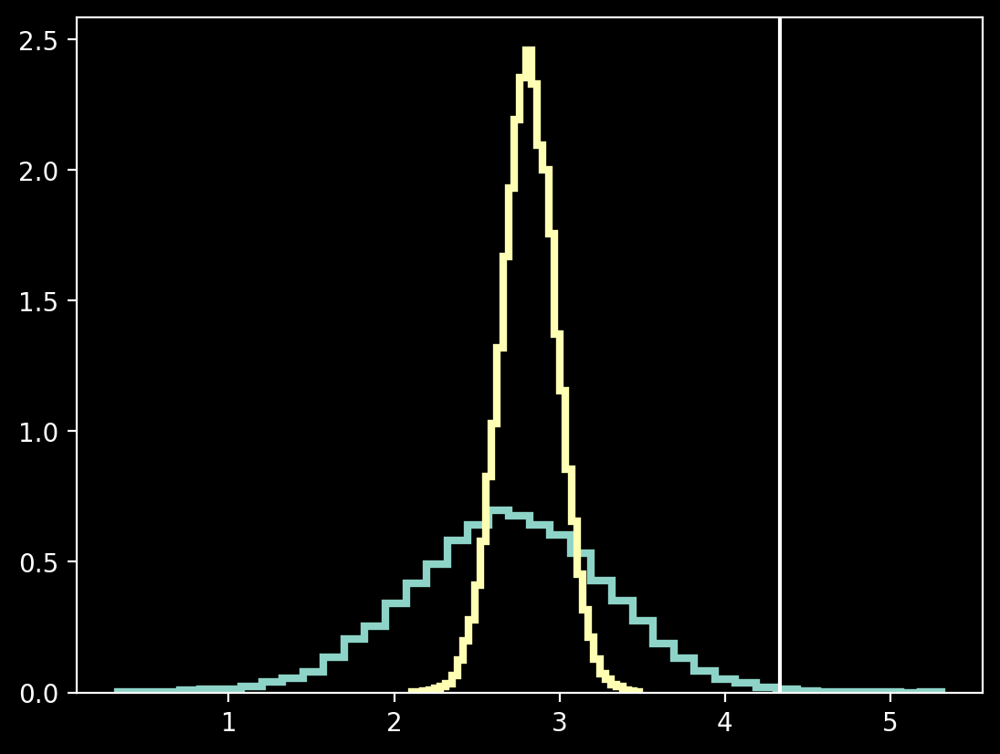

In [36]:
# plt.hist(chain_st_resamp[burn_resamp:, 2 * 67], **hist_settings)
plt.hist(chain_test[:, 2 * 67], **hist_settings)
plt.hist(x[burn:, 0], **hist_settings)
# plt.hist(y[burn_y:, 0], **hist_settings)
plt.axvline(13/3)
plt.show()

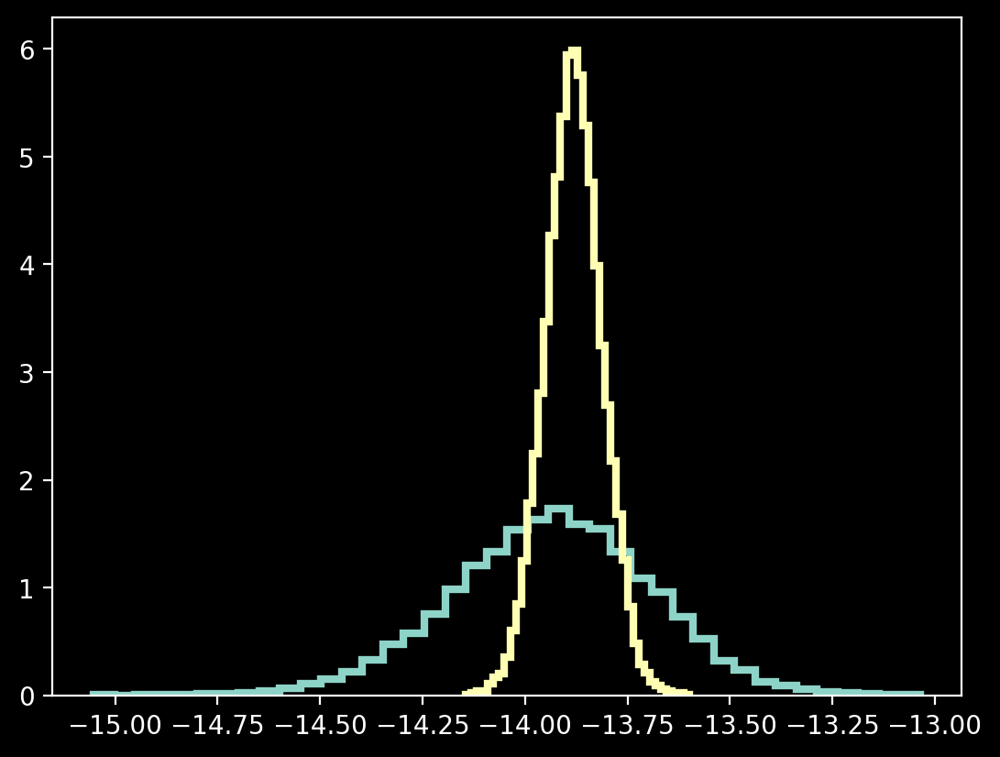

In [35]:
# plt.hist(chain_st_resamp[burn_resamp:, 2 * 67+1], **hist_settings)
plt.hist(chain_test[:, 2 * 67+1], **hist_settings)
plt.hist(x[burn:, 1], **hist_settings)
plt.show()

In [32]:
x[:, 2]

array([-7595.871835, -1455.350708, -1424.697638, ...,   -29.228719,
         -29.245721,   -27.81608 ])

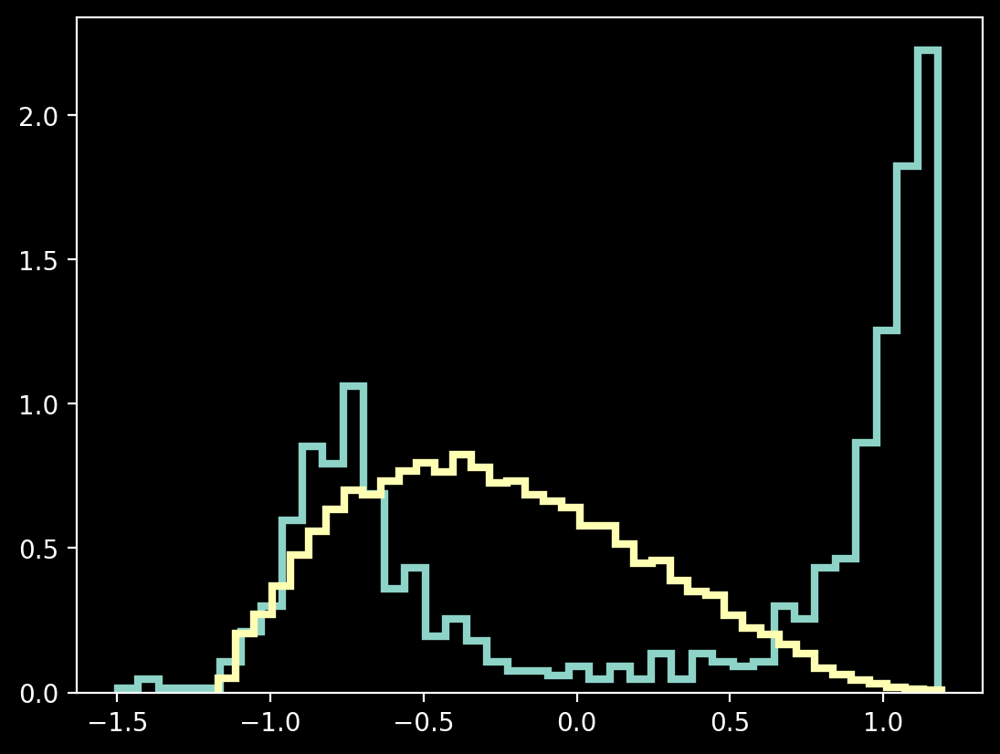

In [33]:
plt.hist(chain_st_resamp[:int(1e3), 2 * 67+2], **hist_settings)
plt.hist(chain_test[:, 2 * 67+2], **hist_settings)
plt.show()

# Binned ORF Plots

In [16]:
facecolor = 'gray'
barcolor = 'gold'
edgecolor = 'gold'

In [17]:
def HD_ORF (angle):
    return 3/2*( (1/3 + ((1-np.cos(angle))/2) * (np.log((1-np.cos(angle))/2) - 1/6)))

In [18]:
# bins = np.array([0.03759145, 0.41650786, 0.56739343, 0.70452728, 0.80722737,
#        0.93432403, 1.0396636 , 1.14780095, 1.26771677, 1.37786293,
#        1.4783429 , 1.60906508, 1.75493235, 1.98867019, 2.21283648,
#        2.90677661])
# bins[-1] = np.pi
bins = np.array([1e-3, 30.0, 50.0, 80.0, 100.0,
                         120.0, 150.0, 180.0]) * np.pi/180.0

In [19]:
rad_to_deg = 180/np.pi
widths = np.diff(bins)
angs = np.linspace(.001, np.pi, 100)
q = [[.158, 0.84] for _ in range(len(bins))]

In [20]:
locs = bins[:-1] + np.diff(bins)/2
locs

array([0.26180811, 0.6981317 , 1.13446401, 1.57079633, 1.91986218,
       2.35619449, 2.87979327])

In [50]:
x = np.load('../ChainFrank/AJAXPaper/1/5/ST/chain_1.npy', mmap_mode = 'r')[:, :-4]
# x = np.load('../ChainFrank/AJAXPaper/1/5/CCRN_Resamp_SG/Resample_chain_2.npy', mmap_mode = 'r')
# chain = np.load('../ChainFrank/AJAXPaper/1/5/CCRN_Resamp_MG/Resample_chain_2.npy')
chain = np.load('../ChainFrank/AJAXPaper/1/5/CCRN_Resamp_MG/Resample_chain_2.npy', mmap_mode = 'r')
idx = np.nonzero(chain[:, 0])[0].max()
idx_x = np.nonzero(x[:, 0])[0].max()
burn = int(0.25 * idx)
burn_x = int(0.25 * idx_x)
x.shape, chain.shape

((374925, 99), (400000, 99))

In [51]:
q = .01
ll = np.quantile(x[:, 92:], q = q, axis = 0)
ul = np.quantile(x[:, 92:], q = 1-q, axis = 0)

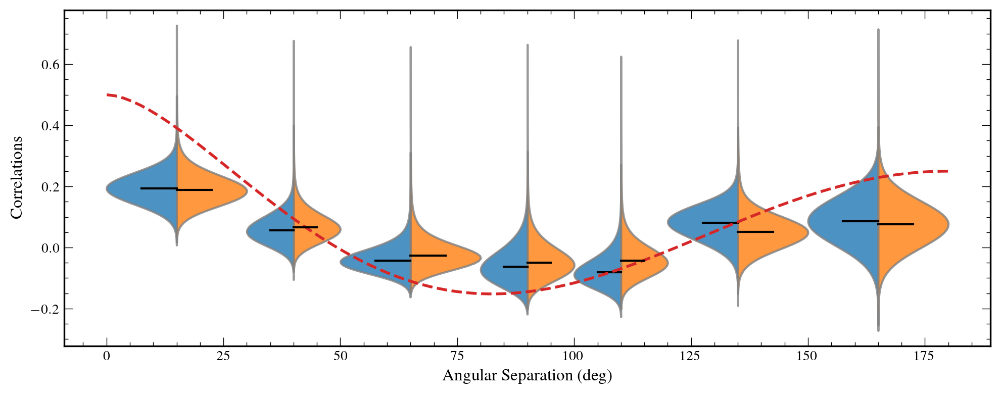

In [52]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 4), sharey=True)
parts = ax.violinplot(x[:, 92:],showextrema=False, side = 'low',
                        positions = locs * rad_to_deg,
                        # quantiles = q,
                        bw_method = .4,
                        widths = widths * rad_to_deg,
                        showmedians = True)
for pc in parts['bodies']:
    pc.set_facecolor('C0')
    pc.set_edgecolor('gray')
    pc.set_linewidth(1.5)
    pc.set_alpha(.8)
parts['cmedians'].set_color('black')
# parts['cbars'].set_color(barcolor)
# parts['cmins'].set_color(barcolor)
# parts['cmaxes'].set_color(barcolor)
# parts['cquantiles'].set_color(barcolor)

# ax.errorbar(x = xi_mean*180/np.pi, y = hd_rho, yerr = hd_sig, xerr = xi_err*180/np.pi, alpha = 0.9,
#             marker='o', ls='', color='white', capsize=4, elinewidth=1.2, label = 'Theoretical HD')

ax.plot(angs * rad_to_deg, HD_ORF(angs), lw = 2, ls = '--', color = 'C3')
# ax.set_ylim(-2, 2.5)
ax.set_xlabel('Angular Separation (deg)', weight = 'bold')
ax.set_ylabel('Correlations', weight = 'bold')
plt.gca().yaxis.set_minor_locator(AutoMinorLocator())
plt.gca().xaxis.set_minor_locator(AutoMinorLocator())

plt.gca().tick_params(axis="x",direction="in", which = 'both', top = True)
plt.gca().tick_params(axis="y",direction="in", which = 'both', right = True)

parts2 = ax.violinplot(chain[burn:idx, 92:],showextrema=False,side = 'high',
                        positions = locs * rad_to_deg,
                        # quantiles = q,
                        bw_method = .4,
                        widths = widths * rad_to_deg,
                        showmedians = True)
for pc in parts2['bodies']:
    pc.set_facecolor('C1')
    pc.set_edgecolor('gray')
    pc.set_linewidth(1.5)
    pc.set_alpha(.8)
parts2['cmedians'].set_color('black')
# parts2['cbars'].set_color('white')
# parts2['cmins'].set_color('white')
# parts2['cmaxes'].set_color('white')

# ax.legend()
plt.tight_layout()
# sdir = f'../Images/Gibbs/{cname}'
# os.makedirs(sdir, exist_ok=True)
# plt.savefig(sdir + '/simGWBResampCorr.png')
plt.show()

In [37]:
m = BP.BayesPowerMulti(psrs_white,
                        crn_bins = 5,
                        Tspan = None,
                        noise_dict = noise_dict,
                        backend = 'none',
                        inc_ecorr = False,
                        tnequad=False,
                        int_rn = True)
m.wishart_helper

In [38]:
phi_chain = np.load(f'../ChainFrank/AJAXPaper/1/5/MG/phimat.npy', mmap_mode='r')                        
phi_chain.shape

(1000000, 5, 990)

In [39]:
phi_chain

memmap([[[ 8.62847039e-03,  3.06651684e-02,  1.47419027e-02, ...,
           6.33706691e-03, -8.24621916e-03,  9.61302919e-03],
         [ 6.91987395e-05, -5.76152508e-05,  2.14115080e-04, ...,
          -2.56994191e-04, -9.01012920e-05,  2.00023688e-04],
         [ 1.49614295e-04, -8.02211204e-05, -8.77358476e-05, ...,
          -9.16503743e-05, -9.20915867e-05,  9.49627351e-05],
         [-1.88359192e-04,  1.27207440e-04, -4.43583747e-04, ...,
           7.78517454e-06,  5.95581895e-06,  5.58575482e-06],
         [ 7.61315071e-05,  1.51529630e-04,  1.77038970e-04, ...,
          -1.05465806e-05, -1.75223814e-06,  2.09514583e-06]],

        [[ 7.86646824e-02,  1.00249286e-01,  1.11547807e-01, ...,
           1.32808774e-02, -1.61153353e-02,  2.18057118e-02],
         [ 1.26885182e-03,  2.12362533e-04,  1.43883899e-03, ...,
          -3.53789593e-04, -1.21542633e-04,  3.63530325e-04],
         [ 7.05463815e-04,  1.58394331e-04,  2.30983748e-04, ...,
          -3.64507686e-04, -2.817724

In [40]:
st = 0
res = []
for _ in tqdm(range(int(phi_chain.shape[0]/1000))):
    end = st + 1000 
    res.append(m.chi_sq_fit(phi_chain[st:end]))
    st = end

  0%|          | 0/1000 [00:00<?, ?it/s]

100%|██████████| 1000/1000 [00:08<00:00, 121.36it/s]


In [41]:
res

[array([-13.92895805, -13.63045577, -13.34503795, -14.14626139,
        -13.69710997, -13.62383073, -14.14410708, -14.33951957,
        -14.05300909, -14.39084761, -14.08251495, -13.28895404,
        -14.07141265, -13.72401668, -13.72835326, -13.91543994,
        -14.1396164 , -14.32231707, -13.80243622, -13.97378515,
        -14.16923675, -14.0371683 , -14.32595064, -13.82509046,
        -13.95212114, -13.98242995, -14.10071862, -14.34071893,
        -13.77589793, -14.2094094 , -14.11914078, -14.03361719,
        -14.05574029, -14.09277972, -14.33903755, -14.17314908,
        -13.42218346, -13.44948281, -13.88775558, -14.39551184,
        -14.33044798, -14.16580984, -13.54515721, -13.85982302,
        -13.91271505, -13.54036086, -14.20328236, -14.09021521,
        -14.23355854, -14.34687397, -13.741138  , -14.07960517,
        -13.9287869 , -13.95667295, -14.064974  , -14.02587444,
        -13.62105145, -14.08048115, -13.88695504, -14.26514739,
        -14.10053862, -14.12075986, -13.

In [42]:
res = np.array(res)
res.shape

(1000, 1000)

In [43]:
res = res.flatten()
res.shape

(1000000,)

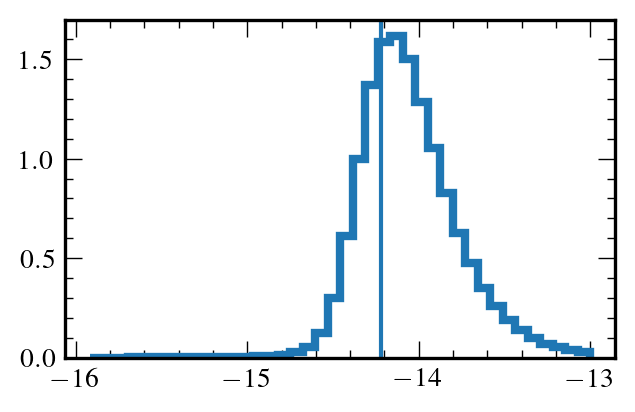

In [46]:
plt.hist(res, **hist_settings)
plt.axvline(np.log10(6e-15))
plt.show()

In [ ]:
np.save(f'/mnt/d/Chain/NEW/Chain/GSIMRED/0/5/MG45/amp_fit.npy', res+4.5)

In [ ]:
x = np.load(f'../ChainFrank/{cname}/{rr}/{crn_bins}/MG/amat.npy', mmap_mode='r')
burn_mg = int(x.shape[0] * .25)

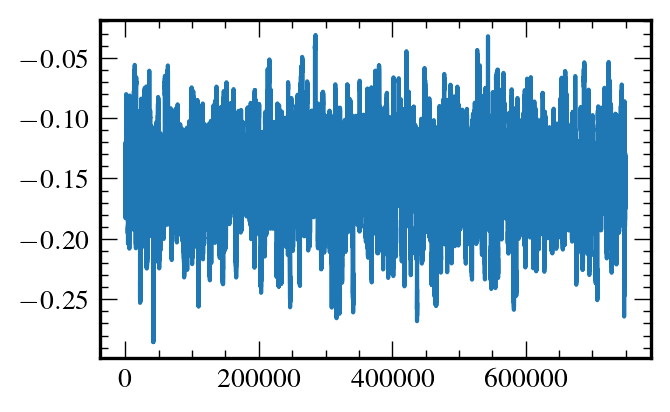

In [ ]:
plt.plot(x[burn_mg:, 1, 0, 1])
plt.show()

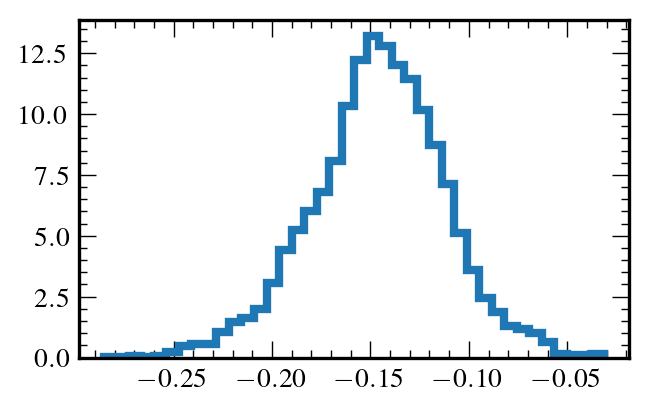

In [ ]:
plt.hist(x[burn_mg:, 1, -1, 1], **hist_settings)
plt.show()

In [ ]:
x

memmap([[[[-8.04158252e-02,  4.63031824e-02, -1.46530716e-01, ...,
            6.29744006e-02, -8.27524533e-02, -1.02643428e-01]],

         [[-4.28144830e-02, -5.91352430e-02, -1.63923923e-01, ...,
            2.92344920e-02, -2.58501501e-02, -5.53698790e-02]],

         [[-1.48355721e-02, -7.22255603e-02, -2.39004046e-02, ...,
            1.59282216e-03, -1.47396288e-02,  1.91392894e-02]],

         ...,

         [[ 7.69075442e-05, -1.16839614e-02, -6.66537310e-03, ...,
           -4.83950330e-03, -2.35443117e-03, -4.18779547e-03]],

         [[ 2.23422707e-03, -3.22992687e-03, -2.54806938e-02, ...,
           -6.52030148e-04, -8.10918050e-04,  3.66812078e-03]],

         [[-3.93206313e-03, -2.07737337e-03,  8.64751014e-04, ...,
           -7.61651442e-04,  1.85377365e-03,  2.99332375e-03]]],


        [[[-8.50540543e-02,  5.04116105e-02, -1.52645521e-01, ...,
            6.60554795e-02, -8.76445545e-02, -1.08507383e-01]],

         [[-4.12473867e-02, -6.11347641e-02, -1.61167036e-0

# ASTO STUFF................

## GPU

In [6]:
import NFTorch, torch

ModuleNotFoundError: No module named 'NFTorch'

In [7]:
nf, half_range, B, mean, _, _ = torch.load('../Data/AstroData/PaperFinal/chosenone/lr0.0001_bs1000_decay0/condflow_at_40000.pkl',
                                            map_location = 'cuda')

/tmp/ipykernel_216836/2210033150.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  nf, half_range, B, mean, _, _ = torch.load('../Data/AstroData/PaperFinal/chosenone/lr0.0

In [ ]:
ranges = torch.tensor([[0.10069627107013876, 10.996444433046685], 
          [-3.49924293759649, -1.5002887159010905], 
          [10.500880056120497, 12.499407412934563], 
          [7.60063715987042, 8.99998216329617], 
          [4.59989707090794e-05, 0.8999003031561474], 
          [-1.4993282447876521, -0.0003902709085412681]], device = 'cuda', dtype = torch.float32)

# ranges = np.array([[-9, -1] for _ in range(5)])
ranges.shape

torch.Size([6, 2])

In [30]:
m  = NFTorch.GPUInferWithNF(nf = [nf, torch.tensor(half_range, dtype = torch.float32, device = 'cuda'), B, torch.tensor(mean, dtype = torch.float32, device = 'cuda')], 
                 psrs = psrs,
                crn_bins = 5,
                int_bins = 5,
                gwb_freq_idxs = torch.tensor([6, 7, 8, 9, 10], dtype = torch.int32, device = 'cuda'),
                ast_param_idxs = torch.tensor([0, 1, 2, 3, 4, 5], dtype = torch.int32, device = 'cuda'),
                Tspan = None, 
                noise_dict = noise_dict, 
                backend = 'backend', 
                tnequad = False, 
                inc_ecorr = True, 
                int_rn = True,
                uniform_priors = ranges,
                gwb_gamma = None,
                pta = None,
                curn = False,
                matrix_stabilization = True,
                device = 'cuda',
                dtype = torch.float32,
                renorm_const = torch.tensor([1e9], device = 'cuda', dtype = torch.float32))
m.get_cross_info

In [37]:
x0 = m.make_initial_guess()
x0

tensor([  2.9842,  -8.7981,   1.4234, -12.5889,   6.7886,  -7.9671,   6.2275,
        -13.2166,   3.3675, -10.6503,   6.0552,  -8.9467,   4.8570, -12.3017,
          1.6966,  -9.1777,   4.3652,  -8.2526,   5.7013, -10.4424,   0.0478,
        -10.6258,   5.2553,  -9.0116,   5.8369, -10.4529,   1.5621, -10.7686,
          6.8339,  -8.0675,   4.2547, -12.9643,   5.4635, -10.3680,   5.6830,
        -12.1340,   5.0597,  -9.3788,   3.6650, -11.8744,   3.4673, -12.1748,
          6.2573, -11.1441,   1.0178, -12.8283,   2.2866, -13.4067,   5.1026,
        -11.6450,   5.8635,  -6.7834,   1.4449, -10.6008,   4.1730, -10.9903,
          1.1595, -12.8114,   1.4132,  -9.9271,   1.4034, -11.8736,   4.0497,
         -7.6925,   6.0540, -10.5889,   2.8979, -10.6233,   4.1184,  -8.5096,
          3.7853, -13.4724,   0.5408,  -6.9311,   6.9704, -11.9383,   5.9567,
        -11.4114,   3.5801,  -8.7164,   1.3418, -10.3398,   2.4899, -11.0891,
          3.7904, -12.7667,   6.9999, -13.4153,   5.6884,  -9.16

In [32]:
ans = m.rhos_given_astro(x0[-6:])
ans

(tensor([-5.1221, -5.8193, -6.2812, -6.6088, -6.8540], device='cuda:0'),
 tensor(4.3574, device='cuda:0', grad_fn=<SelectBackward0>))

In [33]:
%timeit m.rhos_given_astro(x0[-6:])

12.1 ms ± 1.04 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [50]:
m.get_lnliklihood(m.make_initial_guess())

_LinAlgError: linalg.cholesky: The factorization could not be completed because the input is not positive-definite (the leading minor of order 301 is not positive-definite).

In [35]:
m._TNT

tensor([[  52945.0586,  -46688.3789,   35168.5781,  ...,       0.0000,
               0.0000,       0.0000],
        [ -46688.3789,   79676.3984, -147233.6562,  ...,       0.0000,
               0.0000,       0.0000],
        [  35168.5781, -147233.6562,  433309.7500,  ...,       0.0000,
               0.0000,       0.0000],
        ...,
        [      0.0000,       0.0000,       0.0000,  ...,   60389.0352,
          -30734.3945,   51341.0430],
        [      0.0000,       0.0000,       0.0000,  ...,  -30734.3945,
           37124.3711,   -9653.6299],
        [      0.0000,       0.0000,       0.0000,  ...,   51341.0430,
           -9653.6299,   64628.2266]], device='cuda:0')

In [ ]:
%timeit m.get_lnliklihood(x0)

7.75 ms ± 665 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


## CPU

In [2]:
# import NFCPU, torch, run_types
import run_types, utils, GWBFunctions
import LikelihoodCalculator as LC
from enterprise_extensions.model_utils import get_tspan
import jax
import jax.numpy as jnp
import jax.scipy as jsp
import jax.random as jar
# jax.config.update('jax_platform_name', 'cuda')
jax.config.update("jax_enable_x64", True)

/home/koonima/FAST/FLASH/GWBFunctions.py:11: UserWarning: The package `interpax` is needed for spline interpolation of ORF.
  warnings.warn("The package `interpax` is needed for spline interpolation of ORF.")


Optional mpi4py package is not installed.  MPI support is not available.


In [ ]:
TNr = jnp.array([1., 0., 0])
TNT = jnp.array([1., 0., 0])
# psrs = []

In [21]:
assert jnp.any(TNr.any() and TNT.any()) or any(psrs)

In [22]:
psrs

[]

In [7]:
# nf, half_range, B, mean, _, _ = torch.load('../Data/AstroData/PaperFinal/chosenone/lr0.0001_bs1000_decay0/condflow_at_40000.pkl',
#                                             map_location = 'cpu')

In [8]:
# ranges = np.array([[0.10069627107013876, 10.996444433046685], 
#           [-3.49924293759649, -1.5002887159010905], 
#           [10.500880056120497, 12.499407412934563], 
#           [7.60063715987042, 8.99998216329617], 
#           [4.59989707090794e-05, 0.8999003031561474], 
#           [-1.4993282447876521, -0.0003902709085412681]])

# ranges = np.array([[-9, -1] for _ in range(5)])
# ranges.shape

In [8]:
Tspan = get_tspan(psrs)
crn_bins = 14
int_bins = 30
f_intrin = jnp.arange(1/Tspan, (int_bins + 0.01)/Tspan, 1/Tspan)
f_common = f_intrin[:crn_bins]
renorm_const = 1

In [9]:
len(psrs)

67

## Manual

In [8]:
renorm_const = 1e9
logamp_offset = 0.5 * jnp.log10(renorm_const)

In [11]:
chosen_psd_model = run_types.powerlaw
chosen_psd_model_params = np.array([str(_) for _ in inspect.signature(chosen_psd_model).parameters][2:])
chosen_psd_model_params

array(['log10_A', 'gamma'], dtype='<U7')

In [12]:
chosen_orf_model = run_types.gt_orf
chosen_orf_model_params = np.array([str(_) for _ in inspect.signature(chosen_orf_model).parameters][1:])
chosen_orf_model_params

array(['tau'], dtype='<U3')

In [13]:
# gwb_helper_dictionary = run_types.param_order_help(list_of_psd_params = chosen_psd_model_params,
#                                                     lower_bound_array = np.array([-18. + logamp_offset, -1.5]),
#                                                     upper_bound_array = np.array([-14. + logamp_offset, 1.5]),
#                                                     gwb_psd_fixed_param_indxs = np.array([1]),
#                                                     gwb_psd_fixed_param_values = np.array([13/3]),
#                                                     list_of_orf_params = chosen_orf_model_params)
gwb_helper_dictionary = run_types.param_order_help(list_of_psd_params = chosen_psd_model_params,
                                                    lower_bound_array = jnp.array([-18. + logamp_offset]),
                                                    upper_bound_array = jnp.array([-14. + logamp_offset]),
                                                    gwb_psd_fixed_param_indxs = jnp.array([1]),
                                                    gwb_psd_fixed_param_values = jnp.array([13/3]),
                                                    list_of_orf_params = [])
# gwb_helper_dictionary = run_types.param_order_help(list_of_psd_params = chosen_psd_model_params,
#                                                     lower_bound_array = np.array([-18 + logamp_offset, 0.]),
#                                                     upper_bound_array = np.array([-11 + logamp_offset, 7.]),
#                                                     gwb_psd_fixed_param_indxs = None,
#                                                     gwb_psd_fixed_param_values = None,
#                                                     list_of_orf_params = None)
gwb_helper_dictionary

{'ordered_GWB_psd_model_params': array(['log10_A', 'gamma'], dtype='<U7'),
 'gwb_psd_param_lower_lim': Array([-13.5], dtype=float32),
 'gwb_psd_param_upper_lim': Array([-9.5], dtype=float32),
 'gwb_psd_fixed_param_indxs': Array([1], dtype=int32),
 'gwb_psd_fixed_param_values': Array([4.3333335], dtype=float32)}

## Using `utils`

In [10]:
chosen_psd_model, chosen_orf_model, gwb_helper_dictionary = utils.fixed_gamma_hd_pl(renorm_const=renorm_const,)
# chosen_psd_model, chosen_orf_model, gwb_helper_dictionary = utils.hd_spectrum(renorm_const=renorm_const,crn_bins=crn_bins)
# chosen_psd_model, chosen_orf_model, gwb_helper_dictionary = utils.varied_gamma_hd_pl(renorm_const=renorm_const,)
# chosen_psd_model, chosen_orf_model, gwb_helper_dictionary = utils.varied_gamma_gt_pl(renorm_const=renorm_const,)
# chosen_psd_model, chosen_orf_model, gwb_helper_dictionary = utils.varied_gamma_bin_orf_pl(renorm_const=1e9,)
gwb_helper_dictionary

{'ordered_GWB_psd_model_params': array(['log10_A', 'gamma'], dtype='<U7'),
 'gwb_psd_fixed_params': ['gamma'],
 'all_gwb_params': ['log10_A'],
 'gwb_psd_param_lower_lim': Array([-18.], dtype=float64),
 'gwb_psd_param_upper_lim': Array([-11.], dtype=float64),
 'gwb_psd_fixed_param_indices': Array([1], dtype=int64),
 'gwb_psd_fixed_param_values': Array([4.33333333], dtype=float64)}

In [11]:
o = run_types.UniformPrior(gwb_psd_func = chosen_psd_model,
                orf_func = chosen_orf_model,
                crn_bins = crn_bins,
                int_bins = int_bins,
                f_common = f_common, 
                f_intrin = f_intrin,
                df = 1/Tspan,
                Tspan = Tspan, 
                Npulsars = len(psrs),
                psr_pos = [psr.pos for psr in psrs],
                gwb_helper_dictionary = gwb_helper_dictionary,
                gamma_min = 0,
                gamma_max = 7,
                log10A_min = -20 + 0.5 * jnp.log10(renorm_const),
                log10A_max = -11 + 0.5 * jnp.log10(renorm_const),
                renorm_const = renorm_const)

In [12]:
key = jar.key(100)

In [13]:
x0 = o.make_initial_guess(key = key)
y0 = x0
# y0 = y0.at[-1].set(x0[-2])
# y0 = y0.at[-2].set(x0[-1])
# y0 = y0.at[-2].set(x0[-3])
# y0 = y0.at[-3].set(x0[-2])

In [14]:
# %timeit phi = o.get_phi_mat(x0)

In [15]:
# %timeit o.get_lnprior(x0)

In [16]:
# x = jnp.array(np.random.normal(size = (60, 57, 57)))

In [17]:
# %timeit o.jax_to_numpy_CPU(x)

In [18]:
m  = LC.MultiPulsarModel(psrs = psrs,
                run_type_object = o,
                crn_bins = o.crn_bins,
                int_bins = o.int_bins,
                Tspan = o.Tspan, 
                noise_dict = noise_dict, 
                backend = 'backend', 
                tnequad = False, 
                inc_ecorr = True, 
                int_rn = True,
                del_pta_after_init = False,
                matrix_stabilization = False,
                renorm_const = renorm_const)
m.pta.params

[B1855+09_red_noise_gamma:Uniform(pmin=0, pmax=7),
 B1855+09_red_noise_log10_A:Uniform(pmin=-20, pmax=-11),
 B1937+21_red_noise_gamma:Uniform(pmin=0, pmax=7),
 B1937+21_red_noise_log10_A:Uniform(pmin=-20, pmax=-11),
 B1953+29_red_noise_gamma:Uniform(pmin=0, pmax=7),
 B1953+29_red_noise_log10_A:Uniform(pmin=-20, pmax=-11),
 J0023+0923_red_noise_gamma:Uniform(pmin=0, pmax=7),
 J0023+0923_red_noise_log10_A:Uniform(pmin=-20, pmax=-11),
 J0030+0451_red_noise_gamma:Uniform(pmin=0, pmax=7),
 J0030+0451_red_noise_log10_A:Uniform(pmin=-20, pmax=-11),
 J0340+4130_red_noise_gamma:Uniform(pmin=0, pmax=7),
 J0340+4130_red_noise_log10_A:Uniform(pmin=-20, pmax=-11),
 J0406+3039_red_noise_gamma:Uniform(pmin=0, pmax=7),
 J0406+3039_red_noise_log10_A:Uniform(pmin=-20, pmax=-11),
 J0437-4715_red_noise_gamma:Uniform(pmin=0, pmax=7),
 J0437-4715_red_noise_log10_A:Uniform(pmin=-20, pmax=-11),
 J0509+0856_red_noise_gamma:Uniform(pmin=0, pmax=7),
 J0509+0856_red_noise_log10_A:Uniform(pmin=-20, pmax=-11),
 J05

In [19]:
x0, y0

(Array([  0.98378447, -18.91517126,   1.17238591, -18.94655005,
          2.12332127, -16.94172038,   6.72892523, -17.31367217,
          6.08723375, -17.09391191,   3.35925934, -11.29537396,
          4.01185859, -12.67621912,   6.15416654, -16.42386255,
          1.58780906, -17.55445743,   1.99632632, -13.67540424,
          6.2892603 , -15.02915849,   5.86940501, -19.26413939,
          5.34204932, -18.27057042,   3.27285999, -13.5980594 ,
          5.37558874, -14.0424645 ,   5.57167138, -13.50422082,
          0.98197492, -18.20859411,   3.46420522, -15.2861045 ,
          3.11585379, -16.00472205,   2.2104271 , -15.35161368,
          5.32470251, -19.16198904,   0.73410949, -13.31278992,
          4.73952747, -15.97347318,   3.15749621, -18.75731492,
          0.77090025, -13.73266874,   3.07906325, -11.22883105,
          0.63835724, -15.50414288,   4.6303957 , -11.60767276,
          3.32759342, -17.84689334,   3.00369498, -18.60804301,
          6.84072182, -13.57128972,   6.

In [20]:
params = m.pta.map_params(y0)
ent_phi = np.array([m.pta.get_phi(params)[fidx::m.kmax, fidx::m.kmax] for fidx in m.k_idx])[0::2]
ent_phi.shape

(30, 67, 67)

In [21]:
phi = o.get_phi_mat(x0)
phi.shape

(30, 67, 67)

In [22]:
phi.diagonal(axis1 = 1, axis2 = 2)[0]

Array([1.82266616e-08, 1.82266616e-08, 1.82266616e-08, 1.82266632e-08,
       1.82266623e-08, 1.68442408e-07, 1.98165253e-08, 1.82266810e-08,
       1.82266616e-08, 1.82267211e-08, 1.82440230e-08, 1.82266616e-08,
       1.82266616e-08, 1.82295941e-08, 1.83561006e-08, 2.08862708e-08,
       1.82266616e-08, 1.82266637e-08, 1.82266616e-08, 1.82266616e-08,
       1.82266616e-08, 1.82266711e-08, 1.82266646e-08, 1.82266616e-08,
       1.82266631e-08, 1.12022874e-07, 1.82266616e-08, 1.23090326e-06,
       1.82266616e-08, 1.82266616e-08, 8.42646426e-08, 1.82434063e-08,
       1.82266616e-08, 1.82267270e-08, 1.82278860e-08, 1.82266616e-08,
       1.82266616e-08, 1.82266616e-08, 1.82266616e-08, 3.57107506e-08,
       2.85561474e-08, 1.82463406e-08, 1.82266739e-08, 1.82266752e-08,
       1.82266616e-08, 1.82266616e-08, 1.82266616e-08, 1.82266616e-08,
       1.82267705e-08, 1.82266616e-08, 7.06038163e-06, 1.82272239e-08,
       1.82268969e-08, 1.82266616e-08, 1.82266616e-08, 1.82266616e-08,
      

In [23]:
ent_phi.diagonal(axis1 = 1, axis2 = 2)[0]

array([1.82266616e-08, 1.82266616e-08, 1.82266616e-08, 1.82266632e-08,
       1.82266623e-08, 1.68442408e-07, 1.98165253e-08, 1.82266810e-08,
       1.82266616e-08, 1.82267211e-08, 1.82440230e-08, 1.82266616e-08,
       1.82266616e-08, 1.82295941e-08, 1.83561006e-08, 2.08862708e-08,
       1.82266616e-08, 1.82266637e-08, 1.82266616e-08, 1.82266616e-08,
       1.82266616e-08, 1.82266711e-08, 1.82266646e-08, 1.82266616e-08,
       1.82266631e-08, 1.12022874e-07, 1.82266616e-08, 1.23090326e-06,
       1.82266616e-08, 1.82266616e-08, 8.42646426e-08, 1.82434063e-08,
       1.82266616e-08, 1.82267270e-08, 1.82278860e-08, 1.82266616e-08,
       1.82266616e-08, 1.82266616e-08, 1.82266616e-08, 3.57107506e-08,
       2.85561474e-08, 1.82463406e-08, 1.82266739e-08, 1.82266752e-08,
       1.82266616e-08, 1.82266616e-08, 1.82266616e-08, 1.82266616e-08,
       1.82267705e-08, 1.82266616e-08, 7.06038163e-06, 1.82272239e-08,
       1.82268969e-08, 1.82266616e-08, 1.82266616e-08, 1.82266616e-08,
      

In [31]:
m.get_lnliklihood(x0)

Array(45364.56199778, dtype=float64)

In [25]:
%timeit m.get_lnliklihood(x0)

50.4 ms ± 898 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [32]:
params = m.pta.map_params(x0)
likelihood_adjust = 0
likelihood_adjust += -0.5 * np.sum([ell for ell in m.pta.get_rNr_logdet(params)])
likelihood_adjust += sum(m.pta.get_logsignalprior(params))

In [29]:
%timeit m.pta.get_lnlikelihood(m.pta.map_params(x0))

389 ms ± 19.8 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [33]:
m.pta.get_lnlikelihood(params) - likelihood_adjust 

45364.56199777406

## Hyper Model Run

### Standard Way

In [57]:
from enterprise_extensions import model_utils, blocks
from PTMCMCSampler.PTMCMCSampler import PTSampler as ptmcmc
from enterprise.signals import signal_base, gp_signals
from enterprise_extensions import sampler as samp

In [58]:
tm = gp_signals.MarginalizingTimingModel(use_svd=True)
wn = blocks.white_noise_block(vary=False, inc_ecorr=inc_ecorr, gp_ecorr=False, select = backend,tnequad = tnequad)
rn = blocks.red_noise_block(psd='powerlaw', prior='log-uniform',Tspan = m.Tspan,
                                        components=m.int_bins, gamma_val=None)

In [74]:
gwb0 = blocks.common_red_noise_block(psd='powerlaw', prior='log-uniform', Tspan = m.Tspan,
                                        components=m.crn_bins, gamma_val=13/3, name = 'gw', orf = 'hd')

gwb1 = blocks.common_red_noise_block(psd='powerlaw', prior='log-uniform', Tspan = m.Tspan,
                                        components=m.crn_bins, gamma_val=13/3, name = 'gw', orf = 'gt')              

In [75]:
ptas = {}
for idx, gwb in enumerate([gwb0, gwb1]):
    s = tm + wn + rn + gwb
    pta = signal_base.PTA([s(p) for p in m.psr], signal_base.LogLikelihoodDenseCholesky)
    pta.set_default_params(m.noise_dict)
    ptas.update({idx: pta})

In [76]:
ptas

{0: <Enterprise PTA object: B1855+09, B1937+21, B1953+29, J0023+0923, J0030+0451, J0340+4130, J0406+3039, J0437-4715, J0509+0856, J0557+1551, J0605+3757, J0610-2100, J0613-0200, J0636+5128, J0645+5158, J0709+0458, J0740+6620, J0931-1902, J1012+5307, J1012-4235, J1022+1001, J1024-0719, J1125+7819, J1312+0051, J1453+1902, J1455-3330, J1600-3053, J1614-2230, J1630+3734, J1640+2224, J1643-1224, J1705-1903, J1713+0747, J1719-1438, J1730-2304, J1738+0333, J1741+1351, J1744-1134, J1745+1017, J1747-4036, J1751-2857, J1802-2124, J1811-2405, J1832-0836, J1843-1113, J1853+1303, J1903+0327, J1909-3744, J1910+1256, J1911+1347, J1918-0642, J1923+2515, J1944+0907, J1946+3417, J2010-1323, J2017+0603, J2033+1734, J2043+1711, J2124-3358, J2145-0750, J2214+3000, J2229+2643, J2234+0611, J2234+0944, J2302+4442, J2317+1439, J2322+2057>,
 1: <Enterprise PTA object: B1855+09, B1937+21, B1953+29, J0023+0923, J0030+0451, J0340+4130, J0406+3039, J0437-4715, J0509+0856, J0557+1551, J0605+3757, J0610-2100, J0613-0

In [77]:
from enterprise_extensions import hypermodel as hm

In [78]:
x = hm.HyperModel(models = ptas, log_weights=None)

In [79]:
x.param_names

['B1855+09_red_noise_gamma',
 'B1855+09_red_noise_log10_A',
 'B1937+21_red_noise_gamma',
 'B1937+21_red_noise_log10_A',
 'B1953+29_red_noise_gamma',
 'B1953+29_red_noise_log10_A',
 'J0023+0923_red_noise_gamma',
 'J0023+0923_red_noise_log10_A',
 'J0030+0451_red_noise_gamma',
 'J0030+0451_red_noise_log10_A',
 'J0340+4130_red_noise_gamma',
 'J0340+4130_red_noise_log10_A',
 'J0406+3039_red_noise_gamma',
 'J0406+3039_red_noise_log10_A',
 'J0437-4715_red_noise_gamma',
 'J0437-4715_red_noise_log10_A',
 'J0509+0856_red_noise_gamma',
 'J0509+0856_red_noise_log10_A',
 'J0557+1551_red_noise_gamma',
 'J0557+1551_red_noise_log10_A',
 'J0605+3757_red_noise_gamma',
 'J0605+3757_red_noise_log10_A',
 'J0610-2100_red_noise_gamma',
 'J0610-2100_red_noise_log10_A',
 'J0613-0200_red_noise_gamma',
 'J0613-0200_red_noise_log10_A',
 'J0636+5128_red_noise_gamma',
 'J0636+5128_red_noise_log10_A',
 'J0645+5158_red_noise_gamma',
 'J0645+5158_red_noise_log10_A',
 'J0709+0458_red_noise_gamma',
 'J0709+0458_red_nois

In [96]:
x0 = x.initial_sample()
x0[-1] = .9

### New Way

In [10]:
chosen_psd_model, chosen_orf_model, gwb_helper_dictionary = utils.fixed_gamma_hd_pl(renorm_const=renorm_const,)
o1 = run_types.UniformPrior(gwb_psd_func = chosen_psd_model,
                orf_func = chosen_orf_model,
                crn_bins = crn_bins,
                int_bins = int_bins,
                f_common = f_common, 
                f_intrin = f_intrin,
                df = 1/Tspan,
                Tspan = Tspan, 
                Npulsars = len(psrs),
                psr_pos = [psr.pos for psr in psrs],
                gwb_helper_dictionary = gwb_helper_dictionary,
                gamma_min = 0,
                gamma_max = 7,
                log10A_min = -20 + 0.5 * jnp.log10(renorm_const),
                log10A_max = -11 + 0.5 * jnp.log10(renorm_const),
                renorm_const = renorm_const)

/home/koonima/FAST/FLASH/run_types.py:116: UserWarning: You have chosen to change units. Make sure your amplitude priors reflect that!
  warnings.warn("You have chosen to change units. Make sure your amplitude priors reflect that!")


In [11]:
chosen_psd_model, chosen_orf_model, gwb_helper_dictionary = utils.varied_gamma_hd_pl(renorm_const=renorm_const,)
o2 = run_types.UniformPrior(gwb_psd_func = chosen_psd_model,
                orf_func = chosen_orf_model,
                crn_bins = crn_bins,
                int_bins = int_bins,
                f_common = f_common, 
                f_intrin = f_intrin,
                df = 1/Tspan,
                Tspan = Tspan, 
                Npulsars = len(psrs),
                psr_pos = [psr.pos for psr in psrs],
                gwb_helper_dictionary = gwb_helper_dictionary,
                gamma_min = 0,
                gamma_max = 7,
                log10A_min = -20 + 0.5 * jnp.log10(renorm_const),
                log10A_max = -11 + 0.5 * jnp.log10(renorm_const),
                renorm_const = renorm_const)

In [12]:
m1 = LC.MultiPulsarModel(psrs = psrs,
                run_type_object = o1,
                crn_bins = o1.crn_bins,
                int_bins = o1.int_bins,
                Tspan = o1.Tspan, 
                noise_dict = noise_dict, 
                backend = 'backend', 
                tnequad = False, 
                inc_ecorr = True, 
                int_rn = True,
                del_pta_after_init = True,
                matrix_stabilization = True,
                renorm_const = renorm_const)

Condition number of the TNT matrix before stabilizing is: 2.108982e+17
Condition number of the TNT matrix after stabilizing is: 6.9262434e+14


In [13]:
m2 = LC.MultiPulsarModel(psrs = psrs,
                run_type_object = o2,
                crn_bins = o2.crn_bins,
                int_bins = o2.int_bins,
                Tspan = o2.Tspan, 
                noise_dict = noise_dict, 
                backend = 'backend', 
                tnequad = False, 
                inc_ecorr = True, 
                int_rn = True,
                del_pta_after_init = True,
                matrix_stabilization = True,
                renorm_const = renorm_const)

Condition number of the TNT matrix before stabilizing is: 2.108982e+17
Condition number of the TNT matrix after stabilizing is: 6.9262434e+14


In [14]:
hm_object = LC.TwoModelHyperModel(model1=m1,
                                  model2=m2)

In [15]:
x0 = hm_object.make_initial_guess(jar.key(100))
y0 = x0.at[-1].set(.9)
x0[-1], y0[-1]

(Array(0.16322505, dtype=float32), Array(0.9, dtype=float32))

In [17]:
hm_object.get_lnliklihood(x0), hm_object.get_lnliklihood(y0)

2025-02-11 20:21:26.711330: E external/xla/xla/service/slow_operation_alarm.cc:65] Constant folding an instruction is taking > 1s:

  %add.42 = f32[60,60,67,67]{3,2,1,0} add(f32[60,60,67,67]{3,2,1,0} %broadcast.292, f32[60,60,67,67]{1,3,0,2} %constant.346)

This isn't necessarily a bug; constant-folding is inherently a trade-off between compilation time and speed at runtime. XLA has some guards that attempt to keep constant folding from taking too long, but fundamentally you'll always be able to come up with an input program that takes a long time.

If you'd like to file a bug, run with envvar XLA_FLAGS=--xla_dump_to=/tmp/foo and attach the results.
2025-02-11 20:21:27.451478: E external/xla/xla/service/slow_operation_alarm.cc:133] The operation took 1.740235517s
Constant folding an instruction is taking > 1s:

  %add.42 = f32[60,60,67,67]{3,2,1,0} add(f32[60,60,67,67]{3,2,1,0} %broadcast.292, f32[60,60,67,67]{1,3,0,2} %constant.346)

This isn't necessarily a bug; constant-folding is i

(Array(32781.5, dtype=float32), Array(33324.016, dtype=float32))

In [18]:
%timeit hm_object.get_lnliklihood(x0)

10.7 ms ± 177 µs per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [15]:
hm_object.get_lnprior(x0)

Array(-8.01, dtype=float32, weak_type=True)

In [16]:
%timeit hm_object.get_lnprior(x0)

97 µs ± 2.53 µs per loop (mean ± std. dev. of 7 runs, 10,000 loops each)


## Comparison

In [16]:
x0 = o.make_initial_guess()
# x0[-1] = -1.
x0[-1] = -13 + logamp_offset
y0 = x0.copy()
# y0[-2] = x0[-1]
# y0[-1] = x0[-2]

In [17]:
phi = o.get_phi_mat(x0)
ent_phi = np.array([m.pta.get_phi(m.pta.map_params(y0))[fidx::m.kmax, fidx::m.kmax] for fidx in m.k_idx])[0::2]
phi.shape, ent_phi.shape

((30, 67, 67), (30, 67, 67))

In [18]:
phi[0].diagonal()

array([7.36253508e+04, 6.39761559e+08, 8.43583550e+00, 1.90084528e+05,
       8.73287994e-01, 2.53728731e+03, 1.36472378e+09, 1.17182657e+01,
       7.25115476e+02, 1.01453245e+00, 8.73277622e-01, 8.73294592e-01,
       4.34991528e+07, 3.19480818e+09, 9.71318264e+04, 3.85049963e+07,
       1.34059361e+09, 8.94317268e-01, 8.74995264e-01, 5.05833463e+06,
       3.13175100e+03, 2.80314860e+03, 8.10105134e+05, 5.48127324e+08,
       2.85825659e+00, 3.93110435e+08, 1.00760677e+00, 2.16882790e+00,
       4.53471665e+00, 8.73277329e-01, 1.12277519e+13, 8.73276760e-01,
       1.22222978e+04, 7.34726759e+07, 2.05363778e+02, 8.89768637e-01,
       8.74287300e-01, 4.04491663e+03, 1.50615676e+02, 1.23025883e+00,
       1.91729059e+01, 8.73325608e-01, 1.31564737e+08, 8.73276794e-01,
       6.98087069e+07, 1.30502120e+00, 4.70873719e+12, 1.12120688e+00,
       8.75008761e-01, 5.33180827e+01, 8.73276914e-01, 8.74371937e-01,
       8.73277226e-01, 1.13351440e+00, 8.73819113e-01, 1.18192469e+06,
      

In [19]:
ent_phi[0].diagonal()

array([7.36253508e+04, 6.39761559e+08, 8.43583550e+00, 1.90084528e+05,
       8.73287994e-01, 2.53728731e+03, 1.36472378e+09, 1.17182657e+01,
       7.25115476e+02, 1.01453245e+00, 8.73277622e-01, 8.73294592e-01,
       4.34991528e+07, 3.19480818e+09, 9.71318264e+04, 3.85049963e+07,
       1.34059361e+09, 8.94317268e-01, 8.74995264e-01, 5.05833463e+06,
       3.13175100e+03, 2.80314860e+03, 8.10105134e+05, 5.48127324e+08,
       2.85825659e+00, 3.93110435e+08, 1.00760677e+00, 2.16882790e+00,
       4.53471665e+00, 8.73277329e-01, 1.12277519e+13, 8.73276760e-01,
       1.22222978e+04, 7.34726759e+07, 2.05363778e+02, 8.89768637e-01,
       8.74287300e-01, 4.04491663e+03, 1.50615676e+02, 1.23025883e+00,
       1.91729059e+01, 8.73325608e-01, 1.31564737e+08, 8.73276794e-01,
       6.98087069e+07, 1.30502120e+00, 4.70873719e+12, 1.12120688e+00,
       8.75008761e-01, 5.33180827e+01, 8.73276914e-01, 8.74371937e-01,
       8.73277226e-01, 1.13351440e+00, 8.73819113e-01, 1.18192469e+06,
      

In [20]:
phi[0, o.I, o.J]

array([0.33647352, 0.2527517 , 0.39900895, ..., 0.33211583, 0.24827981,
       0.4123179 ])

In [21]:
ent_phi[0, o.I, o.J]

array([0.33647352, 0.2527517 , 0.39900895, ..., 0.33211583, 0.24827981,
       0.4123179 ])

In [22]:
np.allclose(phi[0].diagonal(), ent_phi[0].diagonal())

True

In [23]:
m.get_lnliklihood(x0)

35684.490839346196

In [29]:
%timeit m.get_lnliklihood(y0)

168 ms ± 5.73 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [28]:
y0 = np.hstack([p.sample() for p in m.pta.params])
m.pta.get_lnlikelihood(m.pta.map_params(y0))

7970512.548026542

In [30]:
%timeit m.pta.get_lnlikelihood(m.pta.map_params(y0))

210 ms ± 16.9 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [31]:
%timeit o.get_phi_mat(y0)

74.5 µs ± 339 ns per loop (mean ± std. dev. of 7 runs, 10,000 loops each)


In [24]:
m.get_lnliklihood(x0)

[[ 3.23782708e-07  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
   0.00000000e+00  0.00000000e+00]
 [-1.72944949e-22  1.58746199e-06  0.00000000e+00 ...  0.00000000e+00
   0.00000000e+00  0.00000000e+00]
 [-4.72266355e-18 -3.65531869e-17  5.77084316e-02 ...  0.00000000e+00
   0.00000000e+00  0.00000000e+00]
 ...
 [ 2.85700469e-17 -2.73366667e-17 -5.19074254e-12 ...  1.11456151e+00
   0.00000000e+00  0.00000000e+00]
 [ 1.25637866e-17  1.71613138e-17 -1.66218451e-14 ... -1.00453041e-10
   4.93432759e-01  0.00000000e+00]
 [ 4.84322234e-24  5.50973897e-24 -1.26675471e-19 ... -4.96864866e-17
  -3.65302811e-17  1.79553073e-07]]


-inf

In [32]:
%load_ext line_profiler


The line_profiler extension is already loaded. To reload it, use:
  %reload_ext line_profiler


In [36]:
%lprun -f m.get_lnliklihood m.get_lnliklihood(y0)

Timer unit: 1e-09 s

Total time: 0.192718 s
File: /home/koonima/FAST/FLASH/NFCPU.py
Function: get_lnliklihood at line 191

Line #      Hits         Time  Per Hit   % Time  Line Contents
   191                                               def get_lnliklihood(self, xs):
   192         1        343.0    343.0      0.0          try:
   193         1     359457.0 359457.0      0.2              phi = self.run_type_object.get_phi_mat(xs)
   194         1     344495.0 344495.0      0.2              cp = np.linalg.cholesky(phi)
   195         1      32990.0  32990.0      0.0              logdet_phi = 4 * np.sum(np.log(cp.diagonal(axis1 = 1, axis2 = 2)))
   196         1    1006242.0    1e+06      0.5              phiinv_dense = np.repeat(self.solve_tri_in_batches(mats = phi, b = self._eye, upper = False), 2, axis = 0)
   197         1  190949716.0    2e+08     99.1              expval, logdet_sigma  = self.get_mean(phiinv_dense)
   198         1      24438.0  24438.0      0.0              retu

In [39]:
x = np.random.normal(size = (60, 67, 67))

In [73]:
%timeit np.linalg.cholesky(m._TNT)

183 ms ± 17.3 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [80]:
import scipy.linalg as sl
import torch

In [79]:
%timeit sl.cho_factor(m._TNT)

117 ms ± 2.31 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [83]:
A = torch.tensor(m._TNT, device = 'cpu')
A.dtype

torch.float64

In [84]:
%timeit torch.linalg.cholesky(A)

44.9 ms ± 473 µs per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [ ]:
%timeit m.to_ent_phiinv(x)

11 ms ± 182 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [49]:
%lprun -f m.to_ent_phiinv m.to_ent_phiinv(x)

Timer unit: 1e-09 s

Total time: 0.0280085 s
File: /home/koonima/FAST/FLASH/NFCPU.py
Function: to_ent_phiinv at line 166

Line #      Hits         Time  Per Hit   % Time  Line Contents
   166                                               def to_ent_phiinv(self, phiinv):
   167                                                   '''
   168                                                   Changes the format of the phiinv matrix from (n_freq, n_pulsar, n_pulsar) to (n_freq * n_pulsar by n_freq * n_pulsar).
   169                                           
   170                                                   param: `phiinv`: the phiinv matrix.
   171                                                   '''
   172         1     216133.0 216133.0      0.8          phiinv_ent = np.zeros((self.Npulsars, self.kmax, self.Npulsars, self.kmax))
   173         1   27778006.0    3e+07     99.2          phiinv_ent[:, self.k_idx, :, self.k_idx] = phiinv
   174         1      14372.0  14372.0      0.1 

In [69]:
%timeit m.to_ent_phiinv(x)

10.6 ms ± 187 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [50]:
from numba import njit, prange

In [65]:
import numba

In [66]:
@numba.jit(nopython=True, parallel=True)
def prange_test(A, Npulsars = 67, kmax = 60):
    phiinv_ent = np.zeros((Npulsars * kmax, Npulsars * kmax))
    for fidx in prange(kmax):
        phiinv_ent[fidx::kmax,fidx::kmax] += A[fidx]
    return phiinv_ent


In [68]:
%timeit prange_test(x)

7.39 ms ± 19.6 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [96]:
np.linalg.inv(phi[0])

array([[ 1.71712813e+00,  0.00000000e+00,  0.00000000e+00, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [-2.29337758e-09,  3.96937350e+00,  0.00000000e+00, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [-1.65915377e-09, -6.05472550e-09,  3.82287285e+00, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       ...,
       [ 2.47876037e-14, -7.51043841e-15, -4.91033825e-14, ...,
         1.62184955e-04,  0.00000000e+00,  0.00000000e+00],
       [ 3.31595189e-18,  1.95747949e-18, -2.00698231e-19, ...,
        -6.22579488e-22,  2.10161507e-08,  0.00000000e+00],
       [ 4.56380431e-13,  2.34447001e-13, -1.42595718e-13, ...,
        -1.11313322e-16, -2.39541378e-20,  2.76436366e-03]])

In [97]:
phi[0]

array([[ 5.82367724e-01,  0.00000000e+00,  0.00000000e+00, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 3.36473522e-10,  2.51928925e-01,  0.00000000e+00, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 2.52751699e-10,  3.99008952e-10,  2.61583380e-01, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       ...,
       [-8.90111596e-11,  1.16635496e-11,  7.91956577e-11, ...,
         6.16580002e+03,  0.00000000e+00,  0.00000000e+00],
       [-9.18913840e-11, -2.34675477e-11,  2.49650285e-12, ...,
         1.82654791e-10,  4.75824527e+07,  0.00000000e+00],
       [-9.61503217e-11, -2.13687526e-11,  1.34918026e-11, ...,
         2.48279810e-10,  4.12317903e-10,  3.61746905e+02]])

In [11]:
x0 = m.make_initial_guess()
x0

array([  5.14010587, -12.11675536,   5.11284877, -12.24970849,
         6.13876485,  -8.03364887,   5.65336234, -10.21984841,
         1.82666236, -10.93466595,   4.34328715, -10.19859445,
         0.13351462,  -9.02185382,   6.88373775,  -7.74906232,
         2.82917049, -11.00667301,   6.85868435,  -9.61898516,
         3.41536106, -12.33793536,   0.3614447 , -13.4156912 ,
         5.86969543,  -7.54632863,   0.32009502, -10.16049555,
         2.70546643, -10.43039245,   1.53918103, -11.44571921,
         3.74731849, -12.13961091,   5.28803901,  -8.17377413,
         2.5492423 ,  -9.16124969,   5.62601365, -10.84525566,
         3.497999  ,  -8.6564559 ,   4.30113506,  -8.22145377,
         2.17683529,  -8.39163678,   0.53671933,  -7.18099898,
         0.15819025, -10.62129457,   2.6368737 ,  -6.85407633,
         5.48786615, -10.53015457,   3.79606907,  -8.36724048,
         6.41511334,  -9.23142066,   0.32380373, -10.24687129,
         3.1508326 , -11.99233746,   2.15567165, -10.38

In [12]:
ans = m.rhos_given_astro(x0[-6:])
ans

(array([-7.3826538 , -8.05490698, -8.47777961, -8.81256589, -8.98943201]),
 7.545557)

In [13]:
%timeit m.rhos_given_astro(x0[-6:])

5.85 ms ± 843 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [14]:
%timeit m.get_lnliklihood(x0)

8.28 ms ± 951 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [22]:
%timeit m.get_lnprior(x0)

2.86 µs ± 17.8 ns per loop (mean ± std. dev. of 7 runs, 100,000 loops each)


In [15]:
m.sample(niter = int(1e6), savedir = '../test_avg3', resume = True, seed = None)

[134 135 136 137 138 139]
Finished 1.00 percent in 57.786606 s Acceptance rate = 0.293322Adding DE jump with weight 50
Finished 1.20 percent in 68.766059 s Acceptance rate = 0.317091

KeyboardInterrupt: 

In [13]:
x = np.loadtxt('../test_avg/chain_1.txt')
burn = int(0.25 * x.shape[0])
x.shape

(99900, 144)

In [14]:
labels = [r'$\phi_{0}$', r'$m_{\phi,0}$', r'$\mu$', r'$\epsilon_{\mu}$', r'$\tau_f$', r'$\nu_{\rm{inner}}$']
labels

['$\\phi_{0}$',
 '$m_{\\phi,0}$',
 '$\\mu$',
 '$\\epsilon_{\\mu}$',
 '$\\tau_f$',
 '$\\nu_{\\rm{inner}}$']

In [16]:
plt.style.use('default')
def figsize(scale, wc = 1, hc = 1):
    fig_width_pt = 513.17 #469.755                  # Get this from LaTeX using \the\textwidth
    inches_per_pt = 1.0/72.27                       # Convert pt to inch
    golden_mean = (np.sqrt(5.0)-1.0)/2.0            # Aesthetic ratio (you could change this)
    fig_width = fig_width_pt*inches_per_pt*scale    # width in inches
    fig_height = fig_width*golden_mean              # height in inches
    fig_size = [wc * fig_width,hc * fig_height]
    return fig_size
plt.rcParams.update(plt.rcParamsDefault)

params = {'backend': 'pdf',
        'axes.labelsize': 12,
        'lines.markersize': 4,
        'font.size': 10,
        'xtick.major.size':6,
        "xtick.top": True,
        "ytick.right": True,
        "xtick.minor.visible": True,
        "xtick.major.top": True, 
        "xtick.minor.top": True,
        "ytick.minor.visible": True, 
        "ytick.major.right": True, 
        "ytick.minor.right": True,
        "ytick.direction": "in",
        "xtick.direction": "in",
        'xtick.minor.size':3,  
        'ytick.major.size':6,
        'ytick.minor.size':3, 
        'xtick.major.width':0.5,
        'ytick.major.width':0.5,
        'xtick.minor.width':0.5,
        'ytick.minor.width':0.5,
        'lines.markeredgewidth':1,
        'axes.linewidth':1.2,
        'legend.fontsize': 7,
        'xtick.labelsize': 10,
        'ytick.labelsize': 10,
        'savefig.dpi':200,
        'path.simplify':True,
        'font.family': 'serif',
        'font.serif':'Times',
        "text.usetex": True,
        #'text.latex.preamble': [r'\usepackage{amsmath}'],
        'text.usetex':True,
        'figure.figsize': figsize(0.5, 1, 1)}
plt.rcParams.update(params)

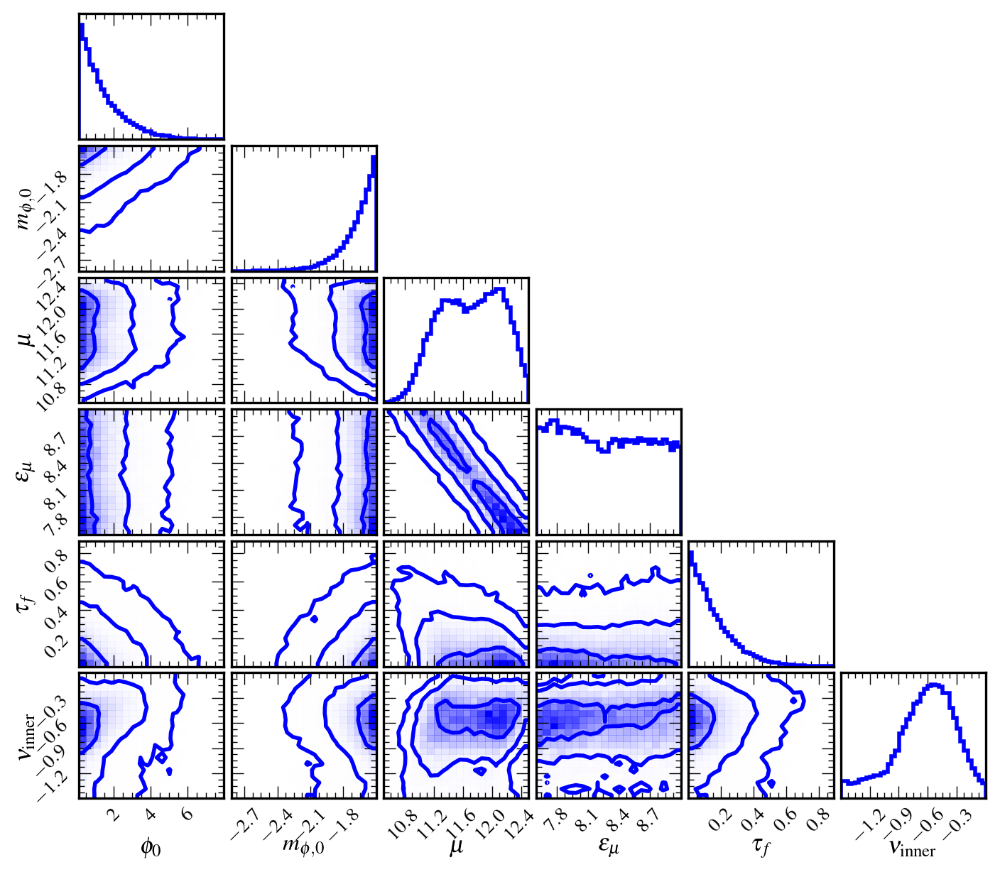

In [17]:
plt.close()

fig = plt.figure(figsize=figsize(0.5, 2, 2.8))

fig = corner.corner(x[burn:, 67*2:67*2+6], fig = fig,
                    color='blue', bins=20, hist_bin_factor=2, data_kwargs={'ms':3}, hist_kwargs={'density': True, 'lw':2}, 
                    contour_kwargs={'linewidths':2}, labels = labels, show_titles=False,
       levels=(1 - np.exp(-0.5), 1 - np.exp(-2), 1 - np.exp(-9 / 2.)),
            truth_color = 'green', desity = True, plot_datapoints = False)

sdir = '../Images/Paper/Astro'
os.makedirs(sdir, exist_ok = True)
plt.savefig(sdir + f'/env_comp.pdf')
plt.show()

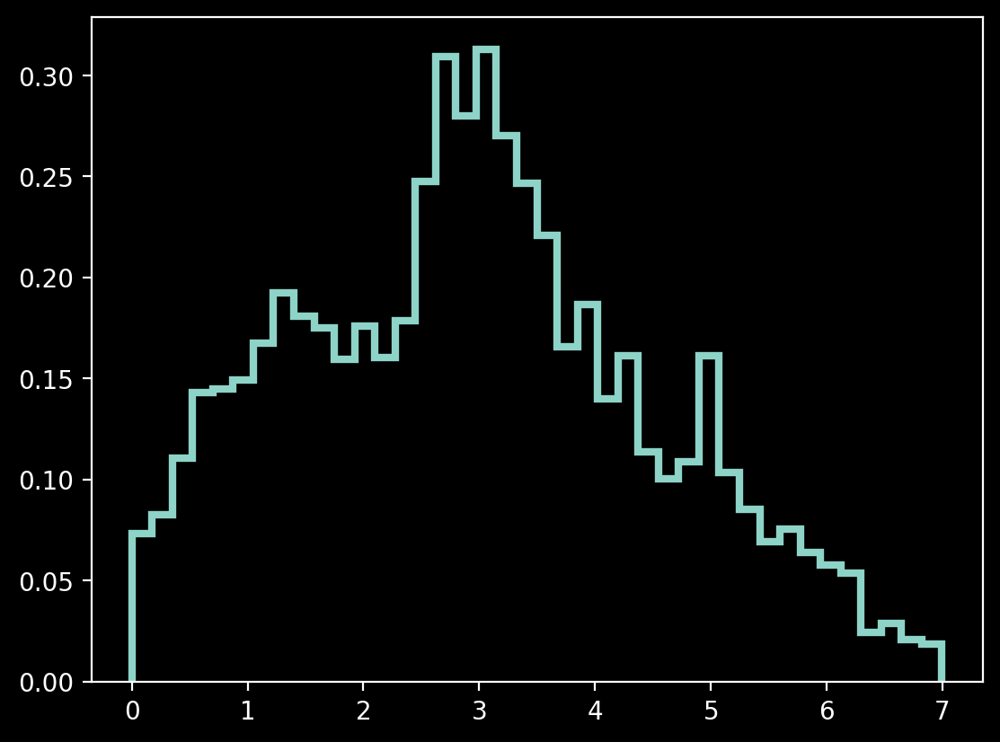

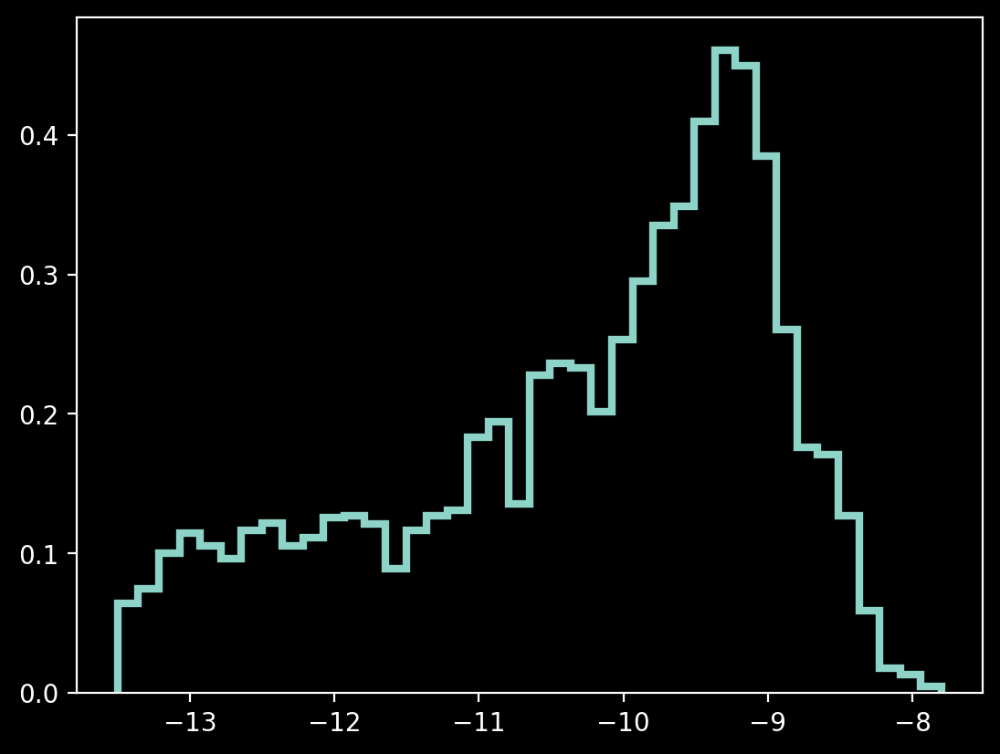

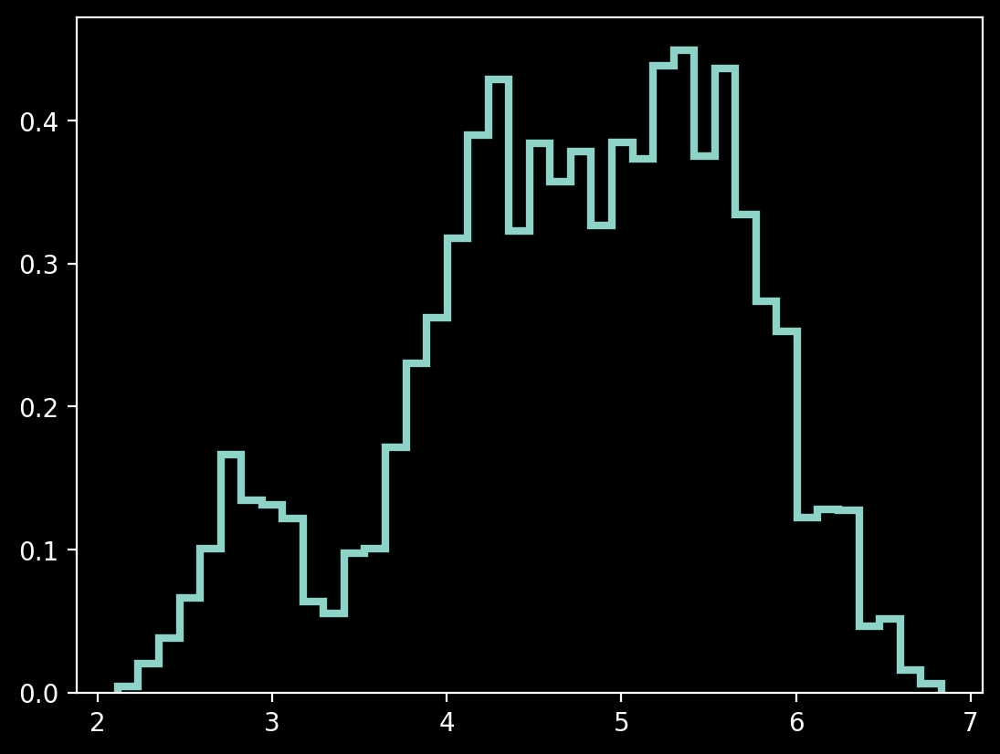

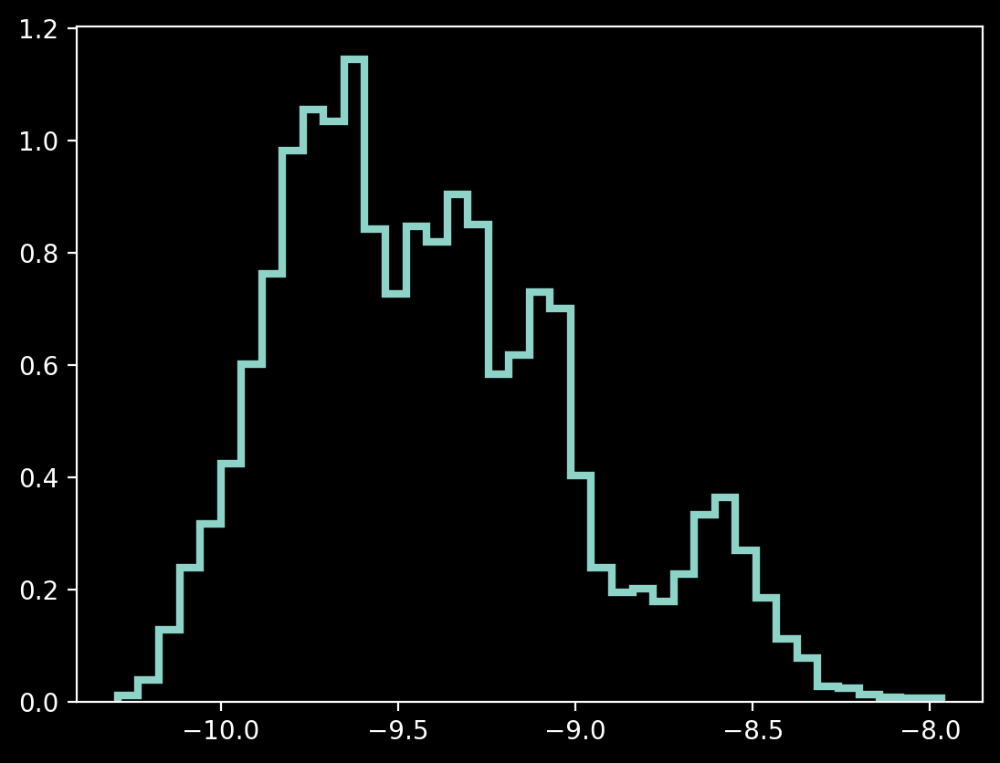

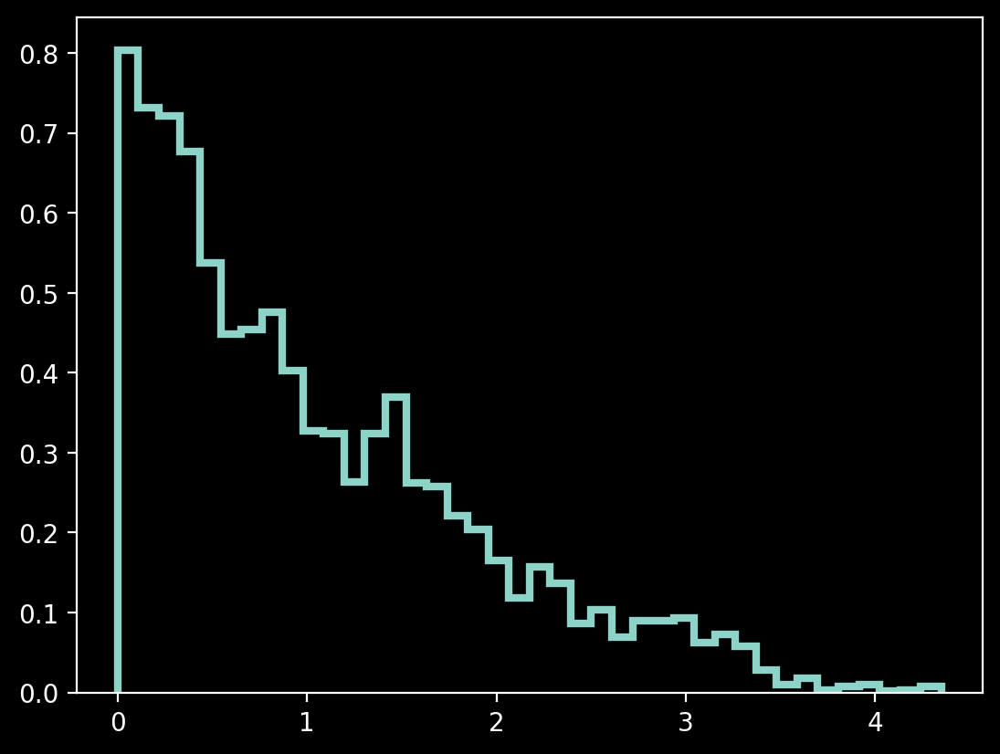

...

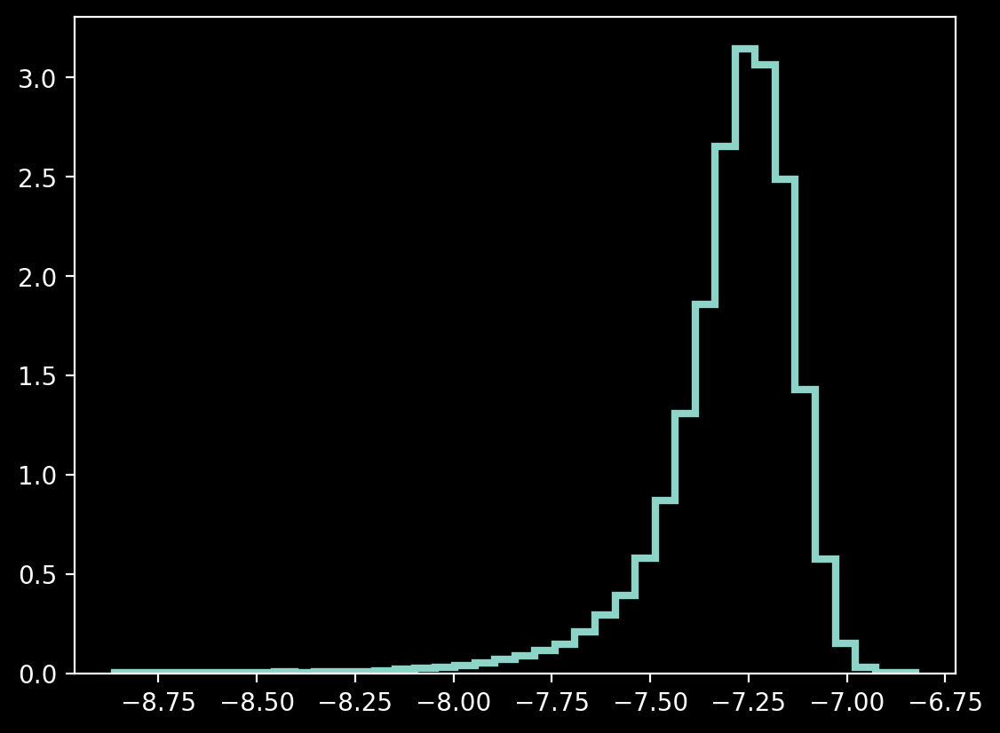

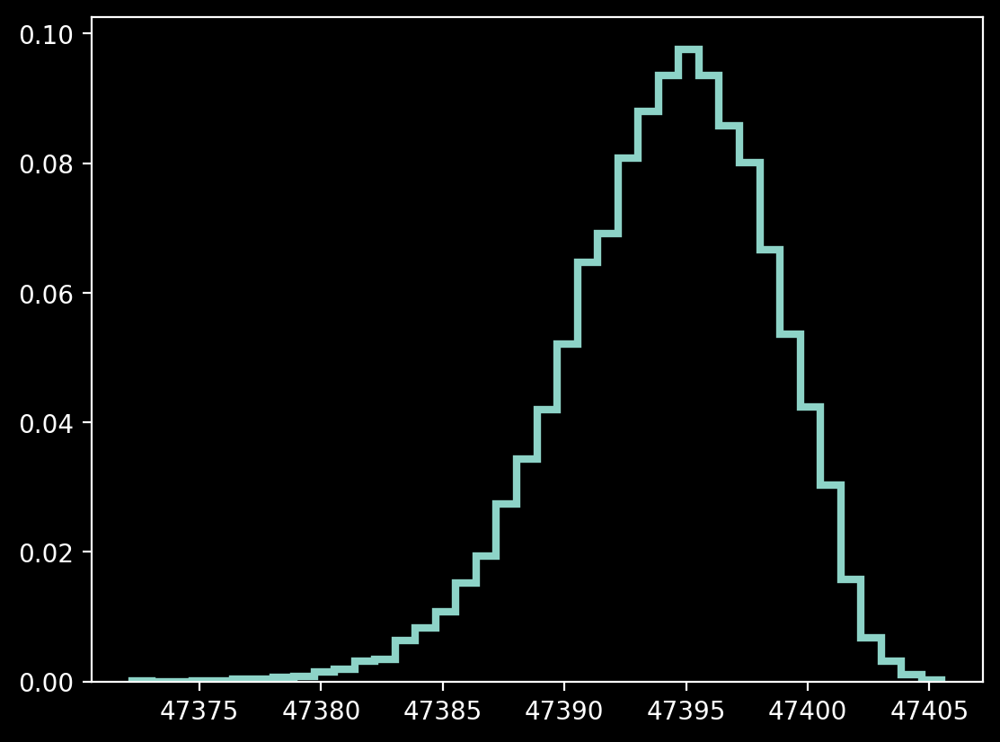

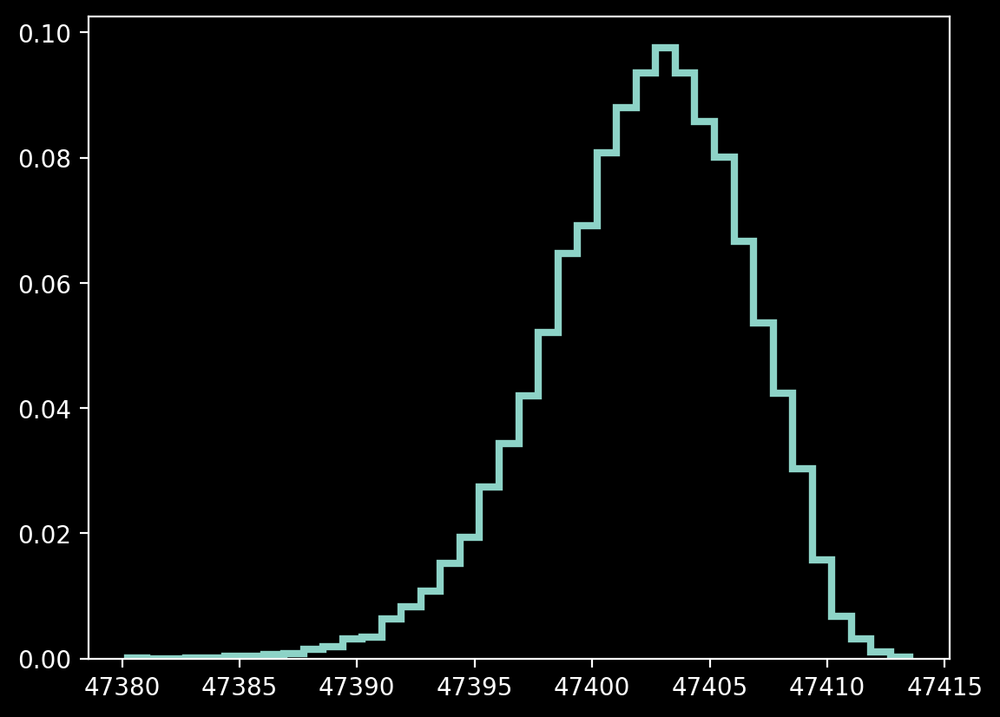

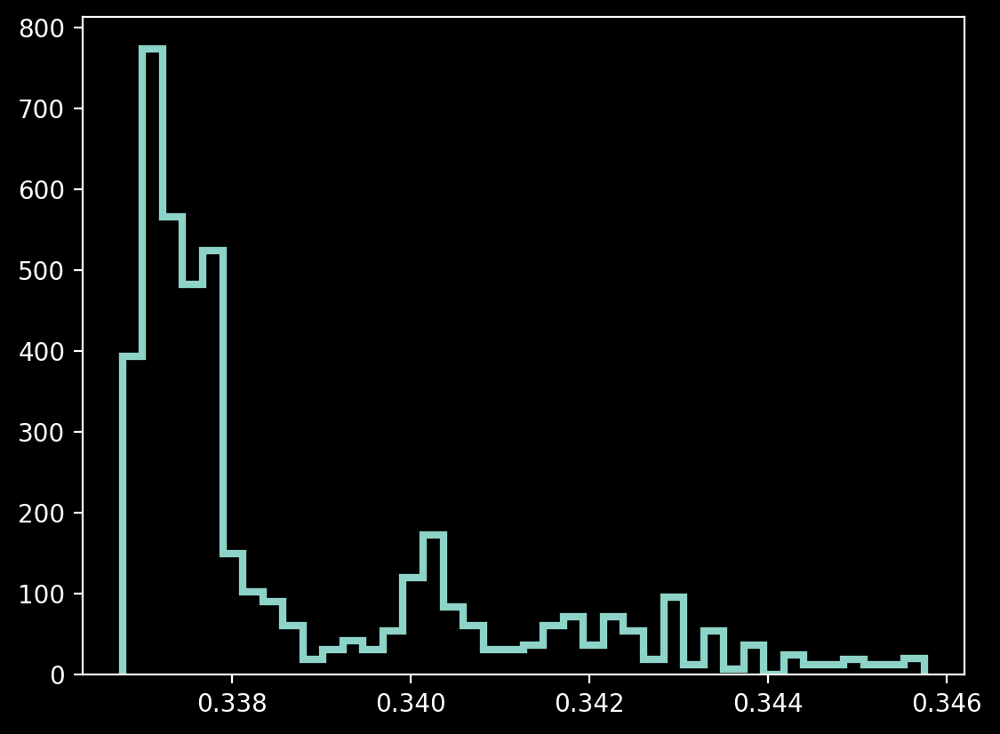

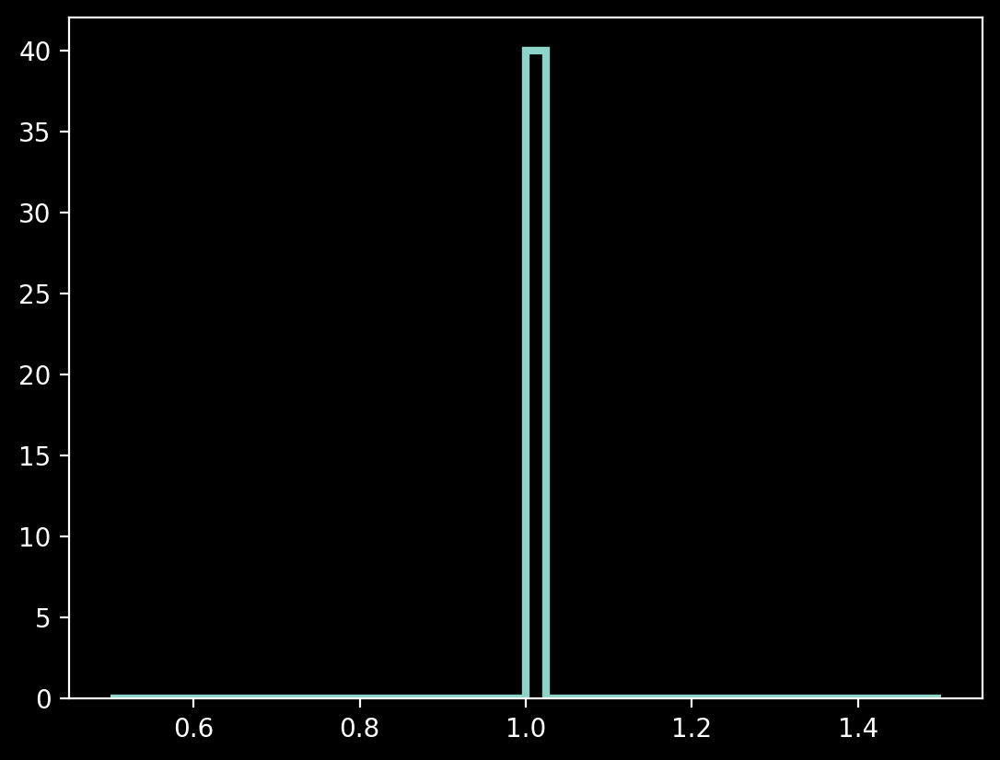

In [24]:
for idx in range(x.shape[1]):
    plt.hist(x[burn:, idx], **hist_settings)
    plt.show()

# HMC 

In [2]:
import jax, pickle, json, random
import numpy as np
from jax import numpy as jnp
import jax.scipy as jsp
import jax.scipy as jc
import cloudpickle as cpickle
import numpyro
from enterprise_extensions.model_utils import get_tspan
from numpyro import distributions as dist
from numpyro import infer
# import BayesPowerGPU as BP
from jax import random as jar
from numpyro.infer import MCMC, NUTS, HMCGibbs
from numpyro.distributions import constraints
from tqdm import tqdm
jax.config.update("jax_enable_x64", True)
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
%load_ext autoreload
%autoreload 2
# os.environ['XLA_FLAGS'] = (
#     '--xla_gpu_enable_triton_softmax_fusion=true '
#     '--xla_gpu_triton_gemm_any=True '
#     '--xla_gpu_enable_async_collectives=true '
#     '--xla_gpu_enable_latency_hiding_scheduler=true '
#     '--xla_gpu_enable_highest_priority_async_stream=true '

from numpyro.infer import Predictive, SVI, Trace_ELBO
from tensorflow_probability.substrates.jax import distributions as tfdn

import matplotlib.pyplot as plt
from matplotlib.ticker import AutoMinorLocator
import matplotlib.lines as mlines
from emcee.autocorr import integrated_time
# from BayesPowerResample import BayesPowerResampleJax as BPJ
# from BayesPowerResample import BayesPowerMulti as BPM
plt.style.use('dark_background')
hist_settings = dict(
    bins = 40,
    histtype = 'step',
    lw = 3,
    density = True
)
# )

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [4]:
x = jnp.array([1., 3.])
x

Array([1., 3.], dtype=float64)

In [15]:
x = jnp.array([False])

In [16]:
if x.all():
    print('yes')

In [19]:
x2 = jnp.array([-2.5, -1.5, -0.5, 0.5, 1.5, 2.5, 3.5, 4.5])
jnp.rint(x2).astype(int)

Array([-2, -2,  0,  0,  2,  2,  4,  4], dtype=int64)

In [2]:
dsets = ['SIMG45', 'SIMG', 'GSIM', 'GSIMNULL', 'GSIMRED', 'SIMRed', 'SIMBase', 'NIMCast', '15SIM', '12p5', 'A4Cast', 'SIMNULL', 'NIMCast', '15yr', 'AJAXPaper', 'SIMCurn']

In [3]:
id = 4
cname = dsets[id]
cname

'GSIMRED'

In [4]:
crn_bins = 5
Npulsars = 45
noise_dict = {}
# cname = names[0][0]
cname

'GSIMRED'

In [5]:
if cname == '12p5':
    rr = 0
    with open(f'../Data/Pickle/channelized_12yr_v3_partim_DE438.pkl', 'rb') as fin:
        psrs = pickle.load(fin)
    psrlist = [psr.name for psr in psrs]
    with open(f'../Data/Pickle/channelized_12p5yr_v3_full_noisedict.json', 'r') as fin:
        nd = json.load(fin)
    for k, v in nd.items():
        if 'equad' in k:
            noise_dict.update({k.replace('equad','tnequad' ):v})
        else:
            noise_dict.update({k:v})
elif cname == '15yr':
    rr = 0
    with open(f'../Data/Pickle/v1p1_de440_pint_bipm2019.pkl', 'rb') as fin:
        psrs = pickle.load(fin)
    psrlist = [psr.name for psr in psrs]
    with open(f'../Data/Pickle/v1p1_all_dict.json', 'r') as fin:
        noise_dict = json.load(fin)
    inc_ecorr = True
    backend = 'backend'
    tnequad = False
    
else:
    rr = 0
    with open(f'../DEMO/Data/Pickle/{cname}/{rr}.pkl', 'rb') as fin:
        psrs = pickle.load(fin)
    len(psrs)
    psrlist = [psr.name for psr in psrs]
    for pname in psrlist:
        noise_dict.update({pname + '_efac': 1.0})
        noise_dict.update({pname + '_log10_t2equad': -np.inf})

libstempo not installed. Will use PINT instead.


In [6]:
Tspan = get_tspan(psrs)
GW_amp_inj = 6e-15
freqs = jnp.arange(1/Tspan, (crn_bins + 0.01)/Tspan, 1/Tspan)
fref = 1/(1 * 365.25 * 24 * 60 * 60)

In [7]:
cname, rr

('GSIMRED', 0)

In [8]:
import NFJAX, torch

In [9]:
nf, half_range, B, mean, _, _ = torch.load('../Data/AstroData/PaperFinal/chosenone/lr0.0001_bs1000_decay0/condflow_at_40000.pkl',
                                            map_location = 'cuda')

/tmp/ipykernel_171567/2210033150.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  nf, half_range, B, mean, _, _ = torch.load('../Data/AstroData/PaperFinal/chosenone/lr0.0

In [10]:
ranges = jnp.array([[0.10069627107013876, 10.996444433046685], 
          [-3.49924293759649, -1.5002887159010905], 
          [10.500880056120497, 12.499407412934563], 
          [7.60063715987042, 8.99998216329617], 
          [4.59989707090794e-05, 0.8999003031561474], 
          [-1.4993282447876521, -0.0003902709085412681]])
ranges.shape

(6, 2)

In [11]:
m  = NFJAX.GPUInferWithNF(nf = [nf, jnp.array(half_range), B, jnp.array(mean)], 
                 psrs = psrs,
                crn_bins = 5,
                int_bins = 5,
                gwb_freq_idxs = jnp.array([6, 7, 8, 9, 10]),
                ast_param_idxs = jnp.array([0, 1, 2, 3, 4, 5]),
                Tspan = None, 
                noise_dict = noise_dict, 
                backend = 'none', 
                tnequad = False, 
                inc_ecorr = False, 
                int_rn = True,
                numpyro_model = None,
                uniform_priors = ranges,
                gwb_gamma = None,
                pta = None,
                curn = False,
                matrix_stabilization = True,
                renorm_const = 1e9)

A numpyro model is not supplied. Making a model based on the provided uniform priors...
Condition number of the TNT matrix before stabilizing is: 1.773487259648e+12
Condition number of the TNT matrix after stabilizing is: 1.481481856e+09


In [12]:
m.run_hmc(savepath = '../ChainRevised/GSIMRED/0/5/astro')

TypeError: Argument to to_dlpack must be a jax.Array, got <class 'jax._src.interpreters.ad.JVPTracer'>

In [13]:
from torch_jax_interop import jax_to_torch, torch_to_jax, torch_module_to_jax

In [15]:
nf

In [16]:
dir(nf)

['__abstractmethods__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__slots__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_abc_impl',
 'base_dist',
 'clear_cache',
 'condition',
 'transforms']

In [44]:
m.ast_param_idxs

Array([0, 1, 2, 3, 4, 5], dtype=int32)

In [30]:
psd_common = m.common_pl_to_rho(np.array([-14.]), jnp.array([4.3]))
psd_common

Array([[1.6840676e-11],
       [8.5492995e-13],
       [1.4953334e-13],
       [4.3401172e-14],
       [1.6626023e-14]], dtype=float32)

In [39]:
m.HD_ORF(m.xi).shape, psd_common.shape

((990,), (5, 1))

In [37]:
psd_common * m.HD_ORF(m.xi)

Array([[ 6.4887123e-12,  4.8741822e-12, -2.5506626e-12, ...,
         2.4544767e-12,  7.2182347e-12,  3.5224005e-12],
       [ 3.2940450e-13,  2.4744163e-13, -1.2948636e-13, ...,
         1.2460340e-13,  3.6643927e-13,  1.7881738e-13],
       [ 5.7615195e-14,  4.3279304e-14, -2.2648087e-14, ...,
         2.1794024e-14,  6.4092842e-14,  3.1276434e-14],
       [ 1.6722470e-14,  1.2561563e-14, -6.5734737e-15, ...,
         6.3255870e-15,  1.8602570e-14,  9.0778012e-15],
       [ 6.4060064e-15,  4.8120556e-15, -2.5181517e-15, ...,
         2.4231916e-15,  7.1262305e-15,  3.4775035e-15]], dtype=float32)

In [41]:
jnp.all(psd_common * m.HD_ORF(m.xi)[None, :] == psd_common * m.HD_ORF(m.xi))

Array(True, dtype=bool)

In [8]:
m = BPJ(  psrs = psrs[:2],
        a_coeff=None,#jnp.load(f'../ChainFrank/{cname}/{rr}/{crn_bins}/MG/amat.npy'),
                crn_bins = 5,
                int_bins=5,
                orf = 'crn',
                df = None, 
                Tspan = None, 
                noise_dict = noise_dict, 
                backend = 'none', 
                tnequad = False, 
                inc_ecorr = False, 
                int_rn = True,
                scale = False,
                a_is_scaled=True,
                single_pulsar_run=True,
                skip_loading_a=True,
                renorm_const = 1e9)

In [11]:
x =  tfdn.WishartTriL(df = m.crn_bins+1,
                    scale_tril=jnp.eye(m.crn_bins),
                    input_output_cholesky=False,
                    validate_args=False,
                    allow_nan_stats=True, 
                    name='WishartTriL')


In [12]:
iw = jnp.linalg.inv(x.sample((int(1e4), ), jar.key(100)))
D = np.sqrt(1/iw.diagonal(axis1 = -2, axis2 = -1))
corr_iw = D[:, :, None] * iw * D[:, None, :]
corr_iw.shape

(10000, 5, 5)

In [13]:
corr_iw[0]

Array([[ 1.0000001 , -0.43621767,  0.78071094, -0.7322304 , -0.4058629 ],
       [-0.4362174 ,  1.        , -0.3042726 ,  0.870956  ,  0.9002105 ],
       [ 0.7807111 , -0.30427286,  1.        , -0.6752965 , -0.19272175],
       [-0.7322306 ,  0.8709559 , -0.6752965 ,  1.        ,  0.81392986],
       [-0.4058628 ,  0.90021056, -0.19272152,  0.81392974,  0.99999994]],      dtype=float32)

In [14]:
chol_carr_mats = jnp.linalg.cholesky(corr_iw)

In [16]:
prior = []
for ii in tqdm(range(chol_carr_mats.shape[0])):
    prior.append(m.get_corr_prior(corr_iw[ii], chol_carr_mats[ii]))

100%|██████████| 10000/10000 [00:13<00:00, 744.98it/s]


In [17]:
prior = jnp.array(prior)
prior.shape

(10000,)

In [18]:
prior

Array([108.86987 , 116.481384,  31.529716, ...,  50.311295,  73.00169 ,
        44.19809 ], dtype=float32)

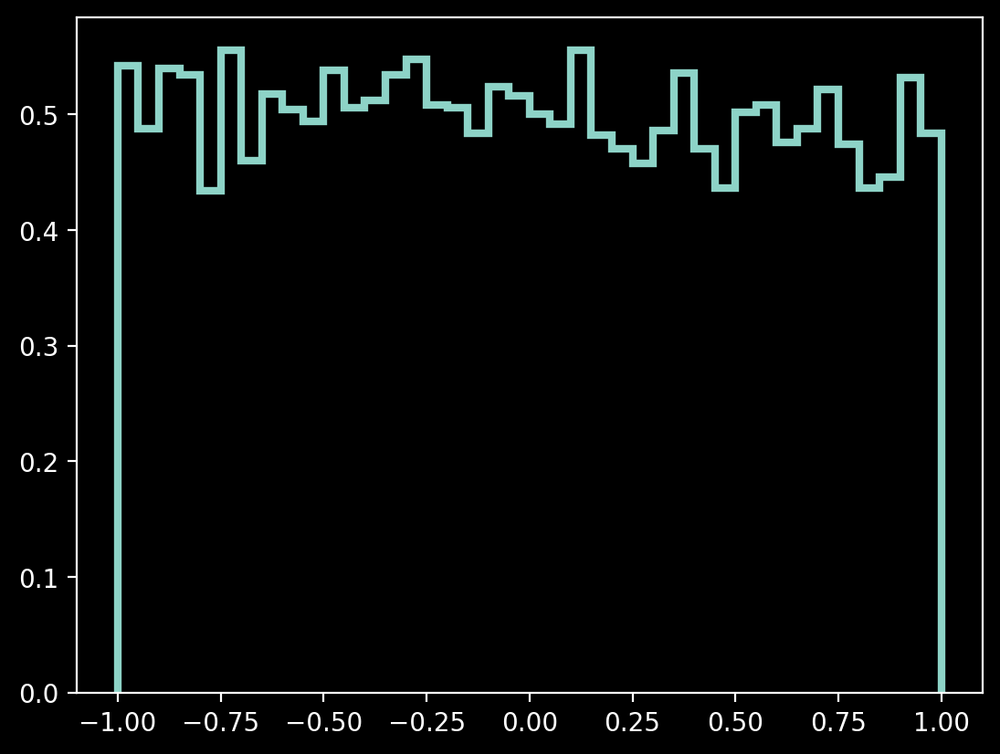

In [20]:
plt.hist(corr_iw[:, 0, 1], **hist_settings)
plt.show()

In [26]:
sidxs = jnp.argsort(corr_iw[:, 0, 1])

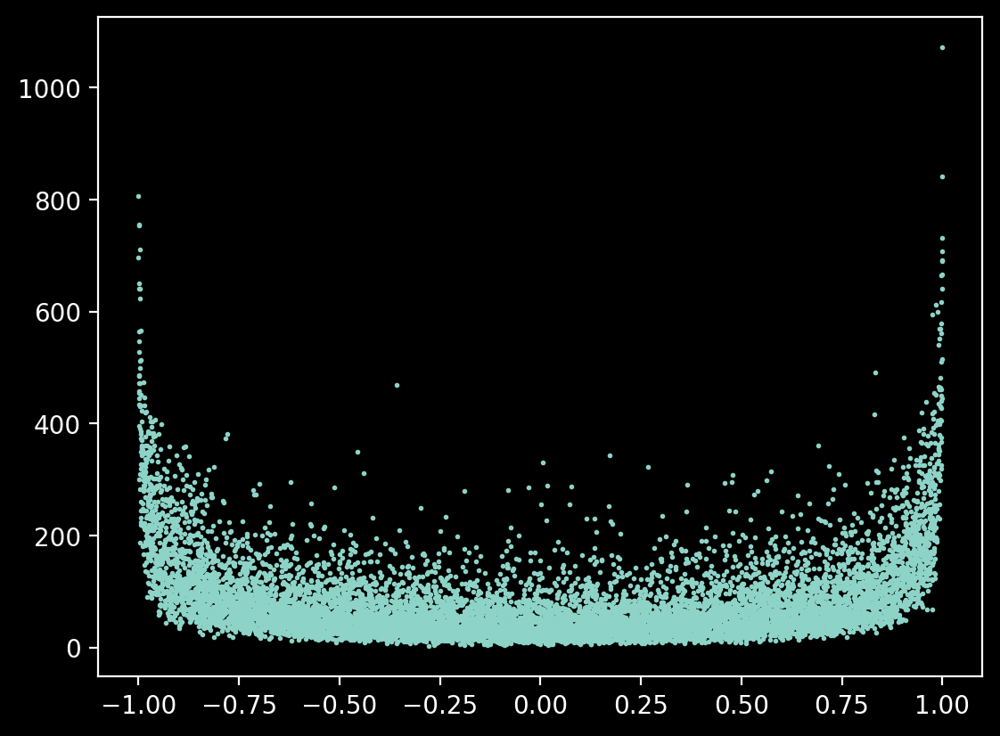

In [33]:
plt.scatter(corr_iw[:, 0, 1], prior, s = 1)
plt.show()

In [9]:
chain = np.load('../ChianAdpatus/GSIMRED/0/STGT/chain_1.npy', mmap_mode='r')[random.sample(range(149925), k = int(1e4))][:, :-4]
chain.shape

(10000, 93)

In [10]:
# ndraws = int(1e4)
# gamma = jnp.array(np.random.normal(loc = 13/3, scale = .1, size = (ndraws)))
# log10amp = jnp.array(np.random.normal(loc = np.log10(6e-15), scale = 1, size = (ndraws)))
# orf_params = jnp.ones(ndraws) * -1.

In [9]:
m.get_cross_info

In [12]:
ndraws = chain.shape[0]

In [13]:
phi = []
for ii in tqdm(range(ndraws)):
    phi.append(m.get_phi_mat(gamma = chain[ii][:-1][0::2], log10amp = chain[ii][1::2]+4.5, orf_params=chain[ii][-1]))

100%|██████████| 10000/10000 [00:01<00:00, 5442.28it/s]


In [14]:
phi = jnp.array(phi)
phi.shape

(10000, 5, 45, 45)

In [15]:
init_values = chain[random.randint(0, ndraws - 1)]
init_values.shape

(93,)

In [16]:
phi[0]

Array([[[ 6.15704944e-03,  2.45948206e-03,  1.94588234e-03, ...,
          1.63125427e-04, -1.79398136e-04, -1.97931164e-04],
        [ 2.45948206e-03,  7.19612837e-03,  2.84212944e-03, ...,
          6.57523866e-04,  4.55551577e-04,  2.35763844e-04],
        [ 1.94588234e-03,  2.84212944e-03,  7.01133534e-03, ...,
          7.57022877e-04,  8.75425176e-04,  3.98313801e-04],
        ...,
        [ 1.63125427e-04,  6.57523866e-04,  7.57022877e-04, ...,
          6.14373107e-03,  1.17296632e-03,  2.69106287e-03],
        [-1.79398136e-04,  4.55551577e-04,  8.75425176e-04, ...,
          1.17296632e-03,  6.14479976e-03,  1.51463063e-03],
        [-1.97931164e-04,  2.35763844e-04,  3.98313801e-04, ...,
          2.69106287e-03,  1.51463063e-03,  6.14369940e-03]],

       [[ 3.08957446e-04,  1.22153840e-04,  9.66451407e-05, ...,
          8.10186702e-06, -8.91007494e-06, -9.83054542e-06],
        [ 1.22153840e-04,  8.20930698e-04,  1.41158584e-04, ...,
          3.26568988e-05,  2.26256470e

In [17]:
# x = dist.distribution.DeltaEmpiricalSingular(bp_object=m, v= phi[0], event_dim=3)

In [18]:
# x.sample(jar.key(100))

In [19]:
# x.log_prob(phi[1007])

In [10]:
# def model():
#     numpyro.sample('phi_mat', dist.distribution.DeltaEmpirical(bp_object=m, v= phi, event_dim=3))
def model():
        log10amp = numpyro.sample("log10amp", dist.Uniform(low = m.log10A_min, high = m.log10A_max).expand([m.Npulsars+1]))
        gamma = numpyro.sample("gamma", dist.Uniform(low = m.gamma_min, high = m.gamma_max).expand([m.Npulsars+1]))
        orf_params = numpyro.sample("orf_params", dist.Uniform(low = m.tau_min, high = m.tau_max).expand([1]))
        phi_estimated =  numpyro.deterministic('phi_mat', m.get_phi_mat(gamma = gamma, log10amp = log10amp, orf_params=orf_params))
        numpyro.factor("post_marg", m.get_posterior_marg_from_phi(phi_estimated))

In [11]:
m.get_cross_info
infer_object = MCMC(NUTS(model),
            num_warmup=250,
            num_samples=int(5e3),
            num_chains=4,
            progress_bar=True,
            chain_method='vectorized')
infer_object.run(jax.random.key(100))

sample: 100%|██████████| 5250/5250 [5:05:47<00:00,  3.49s/it]  


In [12]:
try:
    with open('../ChianAdpatus/GSIMRED/0/inferPLIW.pkl', 'wb') as fout:
        cpickle.dump(infer_object, fout)
except:
    print('saving the infer object failed! Saving the samples instead.')
    with open('../ChianAdpatus/GSIMRED/0/inferPLIW' + '_samples.pkl', 'wb') as fout:
        cpickle.dump(infer_object.get_samples(), fout)

In [28]:
# def guide():
#     log10amp = numpyro.param("log10amp", init_values[1::2] + 4.5, constraint = constraints.interval(lower_bound = -17, upper_bound = -2))
#     gamma = numpyro.param("gamma", init_values[:-1][0::2], constraint = constraints.interval(lower_bound = 0, upper_bound = 7))
#     orf_params = numpyro.param("orf_params", 0.5, constraint = constraints.interval(lower_bound = -2, upper_bound = 2))
#     phi_estimated =  m.get_phi_mat(gamma = gamma, log10amp = log10amp, orf_params=orf_params)

#     # ln_like = m.get_lnliklihood_marg_from_phi(phi_estimated)
#     # numpyro.sample('phi_mat', dist.Delta(v=phi_estimated, log_density=ln_like, event_dim=3))
#     numpyro.sample('phi_mat', dist.distribution.DeltaEmpiricalSingular(bp_object=m, v= phi_estimated, event_dim=3))

# optimizer = numpyro.optim.Adam(step_size=1e-5)
# svi = SVI(model, guide, optimizer, loss=Trace_ELBO())
# svi_result = svi.run(jar.PRNGKey(100), 2000)

In [15]:
m = BPJ(  psrs = psrs,
        a_coeff=jnp.load(f'../ChainFrank/{cname}/{rr}/{crn_bins}/MG/amat.npy'),
                crn_bins = 5,
                int_bins=5,
                orf = 'gt',
                df = None, 
                Tspan = None, 
                noise_dict = noise_dict, 
                backend = 'backend', 
                tnequad = False, 
                inc_ecorr = True, 
                int_rn = True,
                scale = False,
                a_is_scaled=True,
                single_pulsar_run=False,
                renorm_const = 1e9)

# m = BPM(  psrs = psrs,
#         crn_bins = 5,
#         Tspan = get_tspan(psrs),
#         tnequad=False,
#         noise_dict = noise_dict,
#         backend = 'none',
#         renorm_const=1e9,
#         half_logphi_ii_lower = -9,
#         half_logphi_ii_upper = -2,
#         empirical_nd_orf = 'gt',
#         inc_ecorr = False,
#         int_rn = True)

(200000, 10, 67)
0.047982186
Condition number of the TNT matrix before stabilizing is: 2.6491345698816e+13
Condition number of the TNT matrix after stabilizing is: 1.263479160832e+12


In [ ]:
# oo = m.run_hmc_IW(savepath = '../tmp/inferIW.pkl', )

In [11]:
# oo = m.run_hmc_IW(savepath = '../tmp/inferIW.pkl')
# with open( '../tmp/inferIW.pkl', 'wb') as fout:
#     cpickle.dump(oo, fout)

In [12]:
# o = m.run_hmc_from_scale(savepath = '../tmp/inferIW_from_scale.pkl')
# with open( '../tmp/inferIW_from_scale.pkl', 'wb') as fout:
#     cpickle.dump(o, fout)

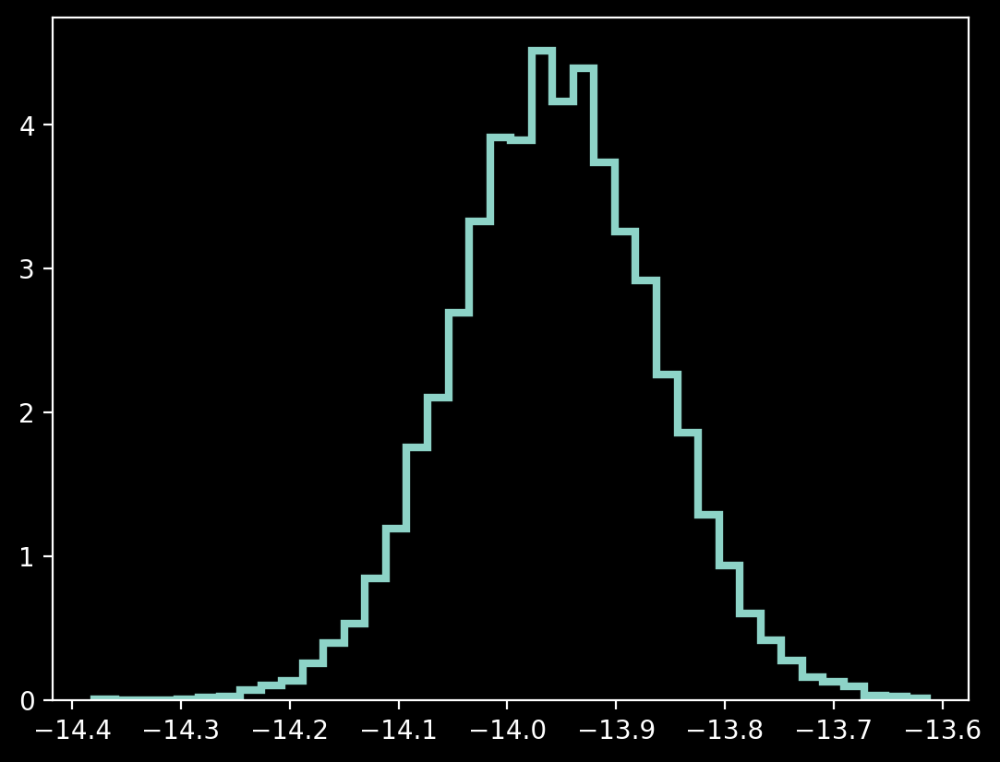

In [25]:
plt.hist(o.get_samples()['log10amp'][:, -1] - 4.5, **hist_settings)
plt.show()

In [12]:
# scale_mat = oo.get_samples()['scale']

In [13]:
# np.save('../tmp/test_scale.npy', scale_mat)

In [14]:
# diags = scale_mat.diagonal(axis1=-1, axis2 = -2)

In [15]:
# diags.shape

(20000, 5, 45)

In [13]:
# plt.hist(jnp.sqrt(diags[:, -1, -2] * 1e-9), **hist_settings)
# plt.show()

In [16]:
m.run_hmc(savepath = f'../ChainFrank/{cname}/{rr}/{crn_bins}/MG/inferMG.pkl')

  0%|          | 0/5250 [00:00<?, ?it/s]

  0%|          | 0/5250 [00:00<?, ?it/s]

  0%|          | 0/5250 [00:00<?, ?it/s]

  0%|          | 0/5250 [00:00<?, ?it/s]

TypeError: cannot pickle '_thread.RLock' object

In [16]:
gamma = jnp.array(np.random.uniform(1, 7, size = (m.Npulsars+1)))
log10amp = jnp.array(np.random.uniform(-15, -14, size = (m.Npulsars+1)))
coeff = jnp.array(np.random.uniform(1e-8, 1e-5, size = (m.kmax, m.Npulsars+1)))
orf_params = jnp.array([-1.])
# orf_params = jnp.array([.1] * 7)

In [6]:
m.rng_key = jar.key(0)

In [7]:
m.wishart_helper

In [8]:
A = m.standard_wishart(m.rng_key)

In [9]:
phiinv = m.pta.get_phiinv(m.pta.map_params(m.x0))/m.renorm_const
phiinv = jnp.array([phiinv[fidx::m.kmax, fidx::m.kmax] for fidx in m.k_idx])
phiinv.shape

(10, 45, 45)

In [13]:
mean, chol_var = m.get_mean(phiinv)

In [37]:
a = m.a_given_phiinv(mean, chol_var, rng_key = m.rng_key)

In [41]:
sp = m.get_scale_mat(a)

In [42]:
m.sp = sp

In [11]:
m.get_cross_info

In [13]:
# m.get_lnliklihood(log10amp, gamma, orf_params, coeff)

In [14]:
# %timeit m.get_lnliklihood(log10amp, gamma, orf_params, coeff)

In [17]:
m.get_lnliklihood_marg(log10amp, gamma, orf_params)

Array(0.27699825, dtype=float64)

In [18]:
%timeit m.get_lnliklihood_marg(log10amp, gamma, orf_params)

4.28 ms ± 247 µs per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [19]:
# m.run_hmc_crn(savepath = './test_infer.pkl', num_samples=int(2e4), num_chains = 4, pbar = True)

In [20]:
m.run_hmc_marg(savepath = './test_infer.pkl', num_samples=int(5e3), num_chains = 4, pbar = True)

warmup:   0%|          | 25/5250 [04:56<17:13:58, 11.87s/it]


KeyboardInterrupt: 

In [107]:
with open('./test_infer.pkl', 'rb') as fin:
    o = cpickle.load(fin)

In [108]:
x = o.get_samples()['log10amp']
y = o.get_samples()['gamma']
# z = o.get_samples()['orf_params']

In [109]:
chain = np.load('../ChainFrank/GSIMRED/2/5/CURN/chain.npy', mmap_mode = 'r')[:, 90:93]
chain.shape

(200000, 2)

In [128]:
burn = int(0.25 * chain.shape[0])
burn

50000

In [111]:
# with open(f'../ChianAdpatus/GSIMRED/2/inferMG.pkl', 'rb') as fin:
#     mg = cpickle.load(fin)

# xx = mg.get_samples()['log10amp']
# yy = mg.get_samples()['gamma']
# zz = mg.get_samples()['orf_params']

In [112]:
x.shape[0]

80000

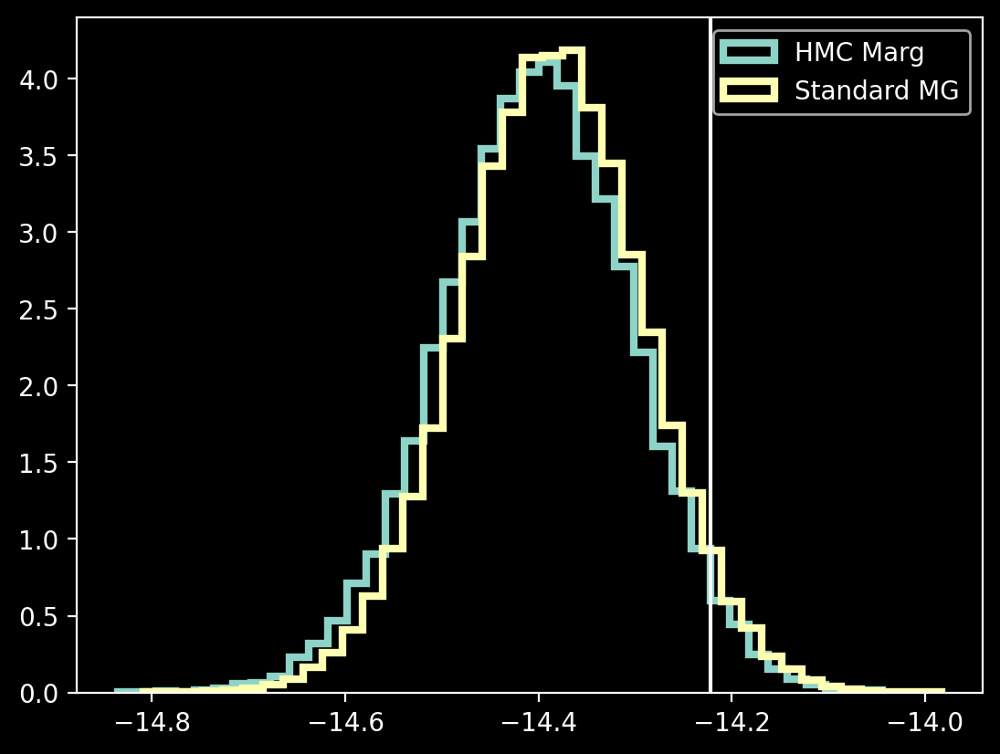

In [129]:
plt.hist(x[-int(2e4):, -1] - 4.5, **hist_settings, label = 'HMC Marg')
# plt.hist(xx[:, -1] - 4.5, **hist_settings, label = 'Resamp MG')
plt.hist(chain[burn:, 1], **hist_settings, label = 'Standard MG')
plt.axvline(np.log10(6e-15))
plt.legend()
plt.show()

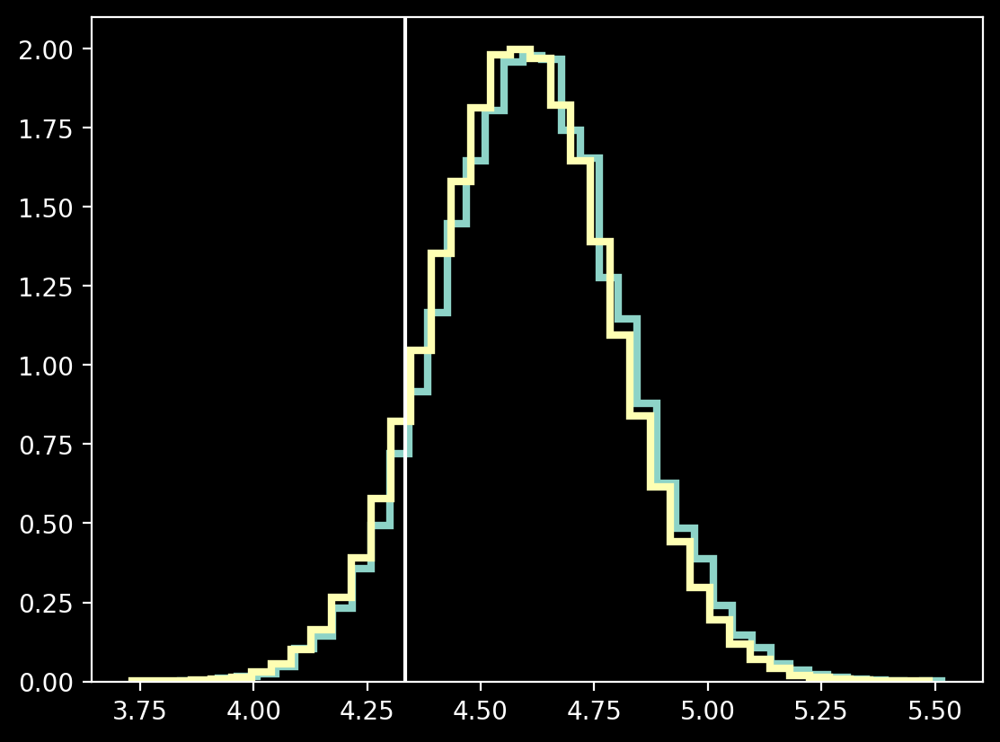

In [130]:
plt.hist(y[-int(2e4):, -1], **hist_settings, label = 'HMC Marg')
# plt.hist(yy[:, -1], **hist_settings, label = 'Resamp MG')
plt.hist(chain[burn:, 0], **hist_settings, label = 'Standard MG')
plt.axvline(13/3)
plt.show()

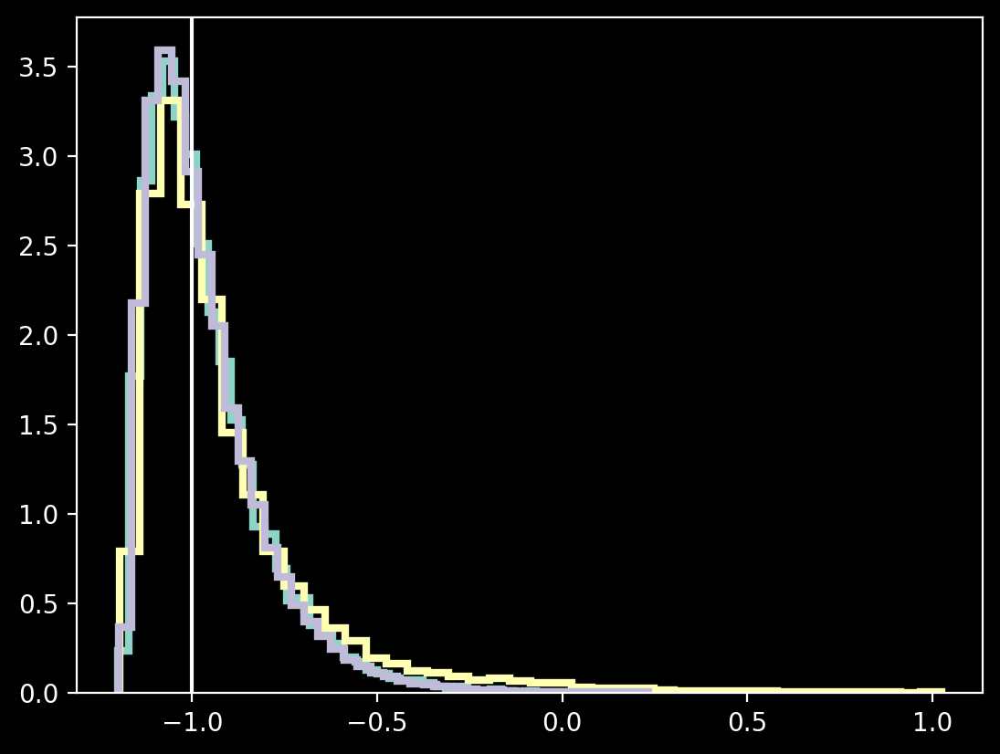

In [29]:
plt.hist(z[:, -1], **hist_settings, label = 'HMC Marg')
plt.hist(zz[:, -1], **hist_settings, label = 'Resamp MG')
plt.hist(chain[:, 2], **hist_settings, label = 'Standard MG')
plt.axvline(-1)
plt.show()

In [132]:
integrated_time(y[-int(2e4):, -1])

array([3.97755185])

In [133]:
integrated_time(x[-int(2e4):, 0])

array([1.89229409])

In [147]:
key = jax.random.key(100)
key

Array((), dtype=key<fry>) overlaying:
[  0 100]

In [144]:
import jax.random as jar

In [145]:
jar.normal(key)

Array(-0.98128915, dtype=float32)

In [162]:
jnp.array([False]) & jnp.array([False])

[autoreload of BayesPowerResample failed: Traceback (most recent call last):
  File "/home/koonima/anaconda3/envs/gent/lib/python3.9/site-packages/IPython/extensions/autoreload.py", line 276, in check
    superreload(m, reload, self.old_objects)
  File "/home/koonima/anaconda3/envs/gent/lib/python3.9/site-packages/IPython/extensions/autoreload.py", line 475, in superreload
    module = reload(module)
  File "/home/koonima/anaconda3/envs/gent/lib/python3.9/importlib/__init__.py", line 169, in reload
    _bootstrap._exec(spec, module)
  File "<frozen importlib._bootstrap>", line 613, in _exec
  File "<frozen importlib._bootstrap_external>", line 846, in exec_module
  File "<frozen importlib._bootstrap_external>", line 983, in get_code
  File "<frozen importlib._bootstrap_external>", line 913, in source_to_code
  File "<frozen importlib._bootstrap>", line 228, in _call_with_frames_removed
  File "/home/koonima/FAST/DEMO/BayesPowerResample.py", line 298
    =
    ^
SyntaxError: invalid syn

Array([False], dtype=bool)

In [159]:
2 >= 3

False